# This notebook does a full analysis of the 2-point data, comparing the effects of varying the minimum time and maximum time of the data and number of data samples

### It also compares what the results would look like with a the main file's (a12m310_a_avg.h5) 2-point function and that of the Feynman-Hellman file (a12m310_a_fh.h5)

In [27]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import gvar as gv

In [28]:
import h5data_methods as h5_dm
import h5py
import lsqfit

In [29]:
# Constants

#Physical constants
hbarc = 197.3 # MeV fm
#a = 0.12

# Pion mass
mpi = 0.1885

# Plot constants
t_min_plt = 1
t_max_plt = 25

In [30]:
# This function's job is to add up the dE parameters in the input-parameters to the fit-functions into useable energies 
def Ei(n_selec, p):
    Ea = p['E0']
    for l in range(1, n_selec+1):
        Ea += p['dE{}'.format(l)]
        
    #print(Ea)
    return Ea

In [31]:
num_zs = 1 #Order number of the n's
# Log E: log of the energy.  
# P is point (in the context of )

# Define the 2-point fit function, for P-S and P-P
def C_2pt(t, p):
    
    z = np.array([])
    ztilde = np.array([])
    E = np.array([])
    for i in range(num_zs):
        z = np.append(z, p['Z{}'.format(i)])
        ztilde = np.append(ztilde, p['Ztilde{}'.format(i)])
        E = np.append(E, Ei(i, p))
        
    
    sum_pp = sum([z[i]*z[i]*np.exp(-E[i]*t) for i in range(num_zs)])
    sum_ps = sum([z[i]*ztilde[i]*np.exp(-E[i]*t) for i in range(num_zs)])
    
    return np.transpose(np.array([[sum_pp], [sum_ps]]), axes=[2,0,1])

## First, get all of the data, calculate effective mass and effective z-value, and do a comparison of the two data-sets

In [32]:
# Get the data, first the primary data-set
file = h5py.File("a12m310_a_avg.h5", "r")

data_original = gv.BufferDict()
data_original['proton_dn_pp'] = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton']['px0_py0_pz0']['spin_dn'])
data_original['proton_up_pp'] = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton']['px0_py0_pz0']['spin_up'])
data_original['proton_dn_np'] = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton_np']['px0_py0_pz0']['spin_dn'])
data_original['proton_up_np'] = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton_np']['px0_py0_pz0']['spin_up'])

data_original['proton'] = (data_original['proton_dn_pp'] + data_original['proton_up_pp'] + data_original['proton_dn_np'] + data_original['proton_up_np'])/4.

# Now, get the Feynman-Hellman dataset
file_fh = h5py.File("a12m310_a_fh.h5", "r")
data_fh = gv.BufferDict()
data_fh['proton_ss'] = np.array(file_fh['proton_ss'])/4.
data_fh['proton_ps'] = np.array(file_fh['proton_ps'])/4.
data_fh['proton'] = np.transpose(np.array([[data_fh['proton_ss']], [data_fh['proton_ps']]]), axes=[2,3,0,1])

# Average out both
avg_data_original = gv.BufferDict()
avg_data_original = gv.dataset.avg_data(data_original)
avg_data_fh = gv.BufferDict()
avg_data_fh = gv.dataset.avg_data(data_fh)

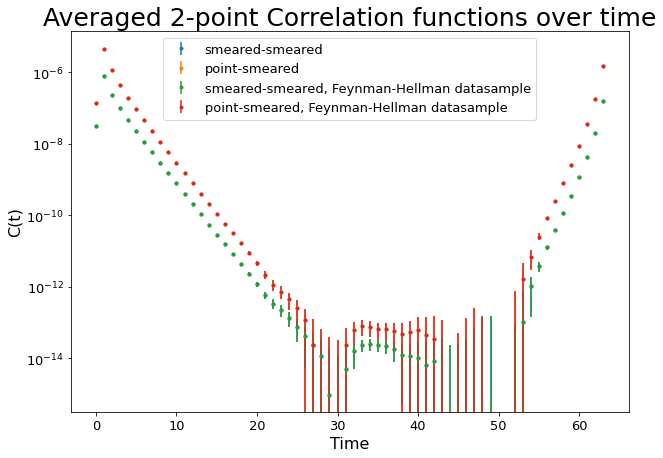

In [33]:
# Plot Correlation functions
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(len(avg_data_original['proton']))], [avg_data_original['proton'][i][0][0].mean for i in range(len(avg_data_original['proton']))], yerr=[avg_data_original['proton'][i][0][0].sdev for i in range(len(avg_data_original['proton']))], fmt='.', label="smeared-smeared")
ax.errorbar([i for i in range(len(avg_data_original['proton']))], [avg_data_original['proton'][i][1][0].mean for i in range(len(avg_data_original['proton']))], yerr=[avg_data_original['proton'][i][1][0].sdev for i in range(len(avg_data_original['proton']))], fmt='.', label="point-smeared")

ax.errorbar([i for i in range(len(avg_data_fh['proton']))], [avg_data_fh['proton'][i][0][0].mean for i in range(len(avg_data_fh['proton']))], yerr=[avg_data_fh['proton'][i][0][0].sdev for i in range(len(avg_data_fh['proton']))], fmt='.', label="smeared-smeared, Feynman-Hellman datasample")
ax.errorbar([i for i in range(len(avg_data_fh['proton']))], [avg_data_fh['proton'][i][1][0].mean for i in range(len(avg_data_fh['proton']))], yerr=[avg_data_fh['proton'][i][1][0].sdev for i in range(len(avg_data_fh['proton']))], fmt='.', label="point-smeared, Feynman-Hellman datasample")

plt.xlabel("Time", fontsize=16)
plt.ylabel("C(t)", fontsize=16)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.title("Averaged 2-point Correlation functions over time", fontsize=25)
plt.legend(fontsize=13)
plt.show()

In [34]:
tau = 1
# Effective mass data (same annihilation, different annihilation)
eff_mass = [[np.log(avg_data_original['proton'][t][0][0]/avg_data_original['proton'][t+tau][0][0])/tau for t in range(len(avg_data_original['proton'])-tau)],\
            [np.log(avg_data_original['proton'][t][1][0]/avg_data_original['proton'][t+tau][1][0])/tau for t in range(len(avg_data_original['proton'])-tau)]]

avg_data_original['eff_mass'] = np.array([np.log(avg_data_original['proton'][t]/avg_data_original['proton'][t+tau])/tau for t in range(len(avg_data_original['proton'])-tau)])
avg_data_fh['eff_mass'] = np.array([np.log(avg_data_fh['proton'][t]/avg_data_fh['proton'][t+tau])/tau for t in range(len(avg_data_fh['proton'])-tau)])

#zS_eff = np.array([np.sqrt(np.exp(eff_mass[0][t]*t)*avg_data_original['proton'][t][0][0]) for t in range(len(avg_data_original['proton'])-tau)])
avg_data_original['zs_eff'] = np.array([np.sqrt(np.exp(avg_data_original['eff_mass'][t][0][0]*t)*avg_data_original['proton'][t][0][0]) for t in range(len(avg_data_original['proton'])-tau)])
avg_data_fh['zs_eff'] = np.array([np.sqrt(np.exp(avg_data_fh['eff_mass'][t][0][0]*t)*avg_data_fh['proton'][t][0][0]) for t in range(len(avg_data_fh['proton'])-tau)])

#zP_eff = np.array([np.exp(eff_mass[1][t]*t)*avg_data_original['proton'][t][1][0]/zS_eff[t] for t in range(len(avg_data_original['proton'])-tau)])
avg_data_original['zp_eff'] = np.array([np.exp(avg_data_original['eff_mass'][t][1][0]*t)*avg_data_original['proton'][t][1][0]/avg_data_original['zs_eff'][t] for t in range(len(avg_data_original['proton'])-tau)])
avg_data_fh['zp_eff'] = np.array([np.exp(avg_data_fh['eff_mass'][t][1][0]*t)*avg_data_fh['proton'][t][1][0]/avg_data_fh['zs_eff'][t] for t in range(len(avg_data_fh['proton'])-tau)])

#log_eff_mass = np.log(eff_mass)

<ipython-input-34-5c46469d3407>:3: RuntimeWarning: invalid value encountered in log
  eff_mass = [[np.log(avg_data_original['proton'][t][0][0]/avg_data_original['proton'][t+tau][0][0])/tau for t in range(len(avg_data_original['proton'])-tau)],\
<ipython-input-34-5c46469d3407>:4: RuntimeWarning: invalid value encountered in log
  [np.log(avg_data_original['proton'][t][1][0]/avg_data_original['proton'][t+tau][1][0])/tau for t in range(len(avg_data_original['proton'])-tau)]]
<ipython-input-34-5c46469d3407>:6: RuntimeWarning: invalid value encountered in log
  avg_data_original['eff_mass'] = np.array([np.log(avg_data_original['proton'][t]/avg_data_original['proton'][t+tau])/tau for t in range(len(avg_data_original['proton'])-tau)])
<ipython-input-34-5c46469d3407>:7: RuntimeWarning: invalid value encountered in log
  avg_data_fh['eff_mass'] = np.array([np.log(avg_data_fh['proton'][t]/avg_data_fh['proton'][t+tau])/tau for t in range(len(avg_data_fh['proton'])-tau)])
<ipython-input-34-5c46469

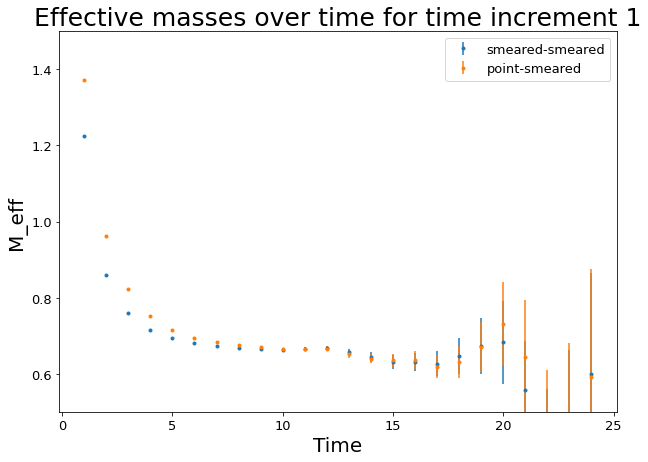

In [35]:
# Plot the effective masses
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['eff_mass'][i][0][0].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([avg_data_original['eff_mass'][i][0][0].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="smeared-smeared")
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['eff_mass'][i][1][0].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([avg_data_original['eff_mass'][i][1][0].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="point-smeared")

#ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['eff_mass'][i][0][0].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([avg_data_fh['eff_mass'][i][0][0].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="smeared-smeared, FH")
#ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['eff_mass'][i][1][0].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([avg_data_fh['eff_mass'][i][1][0].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="point-smeared, FH")

plt.xlabel("Time", fontsize=20)
plt.ylabel("M_eff", fontsize=20)
plt.ylim(0.5, 1.5)
#plt.yticks(np.arange(0.6,0.8, 0.02))
plt.title("Effective masses over time for time increment {}".format(tau), fontsize=25)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.legend(fontsize=13)
plt.show()
fig.savefig('meff_raw.png')


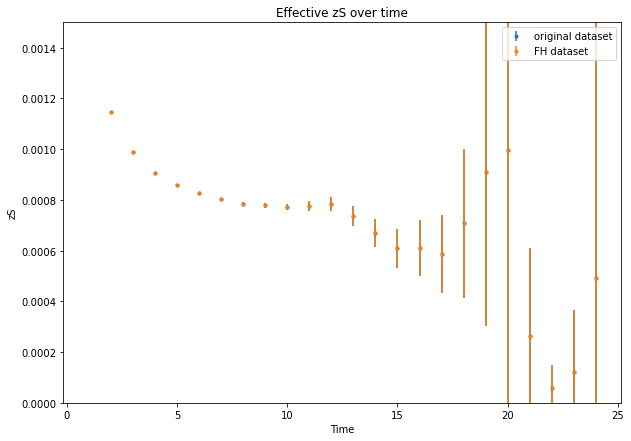

In [36]:
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['zs_eff'][i].mean for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['zs_eff'][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="original dataset")
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['zs_eff'][i].mean for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['zs_eff'][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="FH dataset")

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.ylim([0, 0.0015])
plt.legend()
plt.show()

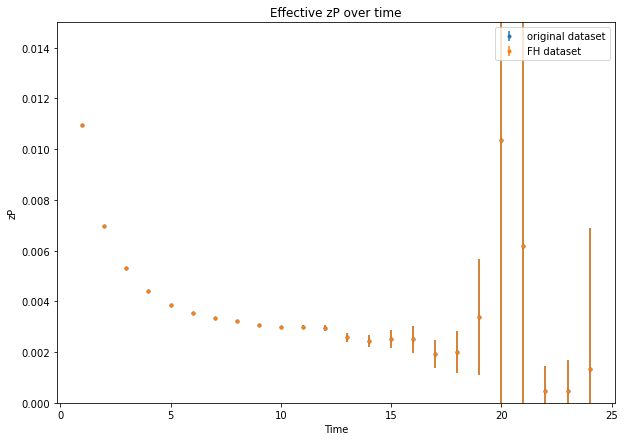

In [37]:
fig = plt.figure(figsize=(10,7))
ax = plt.axes()

ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['zp_eff'][i].mean for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['zp_eff'][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="original dataset")
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['zp_eff'][i].mean for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['zp_eff'][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="FH dataset")

plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.ylim(0, 0.015)
plt.legend()
plt.show()

Looks like the Feynman-Hellman and the original datafile do indeed have the same data

## Set the priors for all sampled energy spacing and widths
### Then test the fits

In [38]:
# Define a-values, where a is such that the energy-increment at the nth excited state is 2*mpi/n^a
# Define b-values, where b is the error-bar of log(dE)

num_fitsamples = np.arange(1,9,1)
a = np.linspace(0,2,11)
a_select_indices = np.array([0, 5, 10])
b = np.linspace(0.3,1.3,6)


In [39]:
# Find up to 9 excited priors for each pair of a,b

num_zs = 10


#p=gv.BufferDict()
#p['E0'] = gv.gvar(0.67, 0.02)
#p['Z0'] = gv.gvar(0.0008, 0.0003)
#p['Ztilde0'] = gv.gvar(0.003, 0.003)

# Initialize the principal values of the excited energy-priors
dE0 = 2*mpi
#energyvals = np.array([[None]*(len(num_fitsamples) + 1)]*len(a))
#dEvals = np.array([[None]*len(num_fitsamples)]*len(a))



#for i in range(len(a)):
    #energyvals[i][0] = p['E0'].mean
    #for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
        #dEvals[i][k-1] = dE0/np.power(k, a[i])
        #energyvals[i][k] = energyvals[i][k-1] + dEvals[i][k-1]
        

priors = []
p_adj = gv.BufferDict()
for i in range(len(a)):
    priors.append([])
    
    for j in range(len(b)):
        #print("i = ", i, " j = ", j)
        priors[i].append(gv.BufferDict())
        #print(a[i])
        priors[i][j] = h5_dm.prior(num_zs, 2, b[j], a[i]) # Use the h5data_methods 
        
        #priors[i][j]['E0'] = p['E0']
        #priors[i][j]['Z0'] = p['Z0']
        #priors[i][j]['Ztilde0'] = p['Ztilde0']
        
        #priors[i][j]['Z1'] = gv.gvar(0.0008, 0.0004)
        #priors[i][j]['Ztilde1'] = gv.gvar(0, 0.005)
        #priors[i][j]['log(dE1)'] = gv.gvar(np.log(dEvals[i][0]), b[j])
        
        #for k in range(2, np.max(num_fitsamples)+1):
            #priors[i][j]['Z{}'.format(k)] = gv.gvar(0.0008, 0.0004)
            #priors[i][j]['Ztilde{}'.format(k)] = gv.gvar(0, 0.005)
            #priors[i][j]['log(dE{})'.format(k)] = gv.gvar(np.log(dEvals[i][k-1]), 0.7)
            

In [40]:
priors[5]

[BufferDict([('E0', 0.660(10)), ('Z0', 0.00080(10)), ('Ztilde0', 0.0030(10)), ('Z1', 0.00080(80)), ('Ztilde1', 0.0030(30)), ('Z2', 0.00080(80)), ('Ztilde2', 0.0030(30)), ('log(dE1)', -0.98(30)), ('log(dE2)', -1.67(30)), ('log(dE3)', -2.07(30)), ('Z3', 0.00080(80)), ('Ztilde3', 0.0030(30)), ('log(dE4)', -2.36(30)), ('Z4', 0.00080(80)), ('Ztilde4', 0.0030(30)), ('log(dE5)', -2.58(30)), ('Z5', 0.00080(80)), ('Ztilde5', 0.0030(30)), ('log(dE6)', -2.77(30)), ('Z6', 0.00080(80)), ('Ztilde6', 0.0030(30)), ('log(dE7)', -2.92(30)), ('Z7', 0.00080(80)), ('Ztilde7', 0.0030(30)), ('log(dE8)', -3.05(30)), ('Z8', 0.00080(80)), ('Ztilde8', 0.0030(30)), ('log(dE9)', -3.17(30)), ('Z9', 0.00080(80)), ('Ztilde9', 0.0030(30)), ('gA3_10', 0.0(1.0)), ('gV4_10', 0.0(1.0)), ('gA3_11', 0.0(1.0)), ('gV4_11', 1.00(20)), ('gA3_20', 0.0(1.0)), ('gV4_20', 0.0(1.0)), ('gA3_21', 0.0(1.0)), ('gV4_21', 0.0(1.0)), ('gA3_22', 0.0(1.0)), ('gV4_22', 1.00(20)), ('gA3_30', 0.0(1.0)), ('gV4_30', 0.0(1.0)), ('gA3_31', 0.0(1.0)

In [41]:
num_zs = 9
aa = 1
bb = 3
fit_check = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, 22)]), np.array([avg_data_original['proton'][l] for l in range(2,22)])), prior=priors[a_select_indices[aa]][bb],fcn=C_2pt,debug=True)

print("a = ", a[a_select_indices[aa]], "; b = ", b[bb])
print("Q= ", fit_check.Q)
print(fit_check.format(pstyle='vv'))

a =  1.0 ; b =  0.9000000000000001
Q=  0.6298885083028153
Least Square Fit:
  chi2/dof [dof] = 0.91 [40]    Q = 0.63    logGBF = 996.12

Parameters:
             E0       0.660273 +- 0.00273431             [           0.66 +- 0.01 ]  
             Z0    0.000753979 +- 1.0124e-05             [       0.0008 +- 0.0001 ]  
        Ztilde0    0.00285124 +- 4.51474e-05             [         0.003 +- 0.001 ]  
             Z1   0.000691412 +- 6.00336e-05             [       0.0008 +- 0.0008 ]  
        Ztilde1    0.00456811 +- 0.000534514             [         0.003 +- 0.003 ]  
             Z2   0.000397731 +- 0.000601598             [       0.0008 +- 0.0008 ]  
        Ztilde2     0.00380169 +- 0.00256033             [         0.003 +- 0.003 ]  
       log(dE1)        -0.798554 +- 0.103154             [        -0.97551 +- 0.9 ]  
       log(dE2)        -0.607938 +- 0.360501             [        -1.66866 +- 0.9 ]  *
       log(dE3)         -1.60916 +- 0.859975             [        -2.07412 +

### Now, plot fit quality and E0 over tmin and number of excited states used

In [42]:
tmin = np.arange(1,10,1)

list_LogGBF_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

list_LogGBF_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

list_LogGBF_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

In [43]:
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmin)):
            num_zs = j + np.min(num_fitsamples) + 1
            fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([avg_data_original['proton'][l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[0]][i],fcn=C_2pt,debug=True)
            fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([avg_data_original['proton'][l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[1]][i],fcn=C_2pt,debug=True)
            fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([avg_data_original['proton'][l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[2]][i],fcn=C_2pt,debug=True)
            
            print("\ni = ", i, " j = ", j, " k = ", k, "\n")
            
            list_LogGBF_a0[i][j][k] = fit_a0.logGBF
            list_Q_a0[i][j][k] = fit_a0.Q
            list_E0_a0[i][j][k] = fit_a0.p['E0']
            
            print("Fit for a = ", a[a_select_indices[0]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a0[i][j][k])
            print("list Q: ", list_Q_a0[i][j][k])
            print("list E0: ", list_E0_a0[i][j][k])
            print(fit_a0.format(pstyle='vv'))
            
            list_LogGBF_a1[i][j][k] = fit_a1.logGBF
            list_Q_a1[i][j][k] = fit_a1.Q
            list_E0_a1[i][j][k] = fit_a1.p['E0']
            
            print("Fit for a = ", a[a_select_indices[1]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a1[i][j][k])
            print("list Q: ", list_Q_a1[i][j][k])
            print("list E0: ", list_E0_a1[i][j][k])
            print(fit_a1.format(pstyle='vv'))
            
            list_LogGBF_a2[i][j][k] = fit_a2.logGBF
            list_Q_a2[i][j][k] = fit_a2.Q
            list_E0_a2[i][j][k] = fit_a2.p['E0']
            
            print("Fit for a = ", a[a_select_indices[2]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a2[i][j][k])
            print("list Q: ", list_Q_a2[i][j][k])
            print("list E0: ", list_E0_a2[i][j][k])
            print(fit_a2.format(pstyle='vv'))
            #print(list_LogGBF_a0)
            #a = 0, b = 0.7, k = 5 fit


i =  0  j =  0  k =  0 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  1
list logGBF:  -2948.936280373492
list Q:  0.0
list E0:  0.69154(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2948.9

Parameters:
             E0      0.691544 +- 0.000900554             [        0.66 +- 0.01 ]  ***
             Z0   0.000821287 +- 1.95246e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0032818 +- 1.01296e-05             [      0.003 +- 0.001 ]  
             Z1    0.00204856 +- 2.61909e-06             [    0.0008 +- 0.0008 ]  *
        Ztilde1      0.0133816 +- 1.8761e-05             [      0.003 +- 0.003 ]  ***
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       0.518272 +- 0.00223672             [     -0.97551 +- 0.3 ]  ****
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.3 


i =  0  j =  0  k =  1 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  2
list logGBF:  245.84793370072742
list Q:  1.8544535316692686e-97
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 1.9e-97    logGBF = 245.85

Parameters:
             E0       0.667463 +- 0.00107549             [        0.66 +- 0.01 ]  
             Z0   0.000785555 +- 2.51408e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0030373 +- 1.21409e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125253 +- 3.76014e-06             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0091789 +- 4.27896e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.128163 +- 0.00678144             [     -0.97551 +- 0.3 ]  **
       log(dE2)              -0.97551 +- 0.3             [     -0.97


i =  0  j =  0  k =  2 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  3
list logGBF:  423.9708196557286
list Q:  1.0041530316235231e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.5 [20]    Q = 1e-10    logGBF = 423.97

Parameters:
             E0      0.663168 +- 0.00137787            [        0.66 +- 0.01 ]  
             Z0   0.00076932 +- 3.63616e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0   0.00294256 +- 1.71289e-05            [      0.003 +- 0.001 ]  
             Z1   0.00103632 +- 8.02573e-06            [    0.0008 +- 0.0008 ]  
        Ztilde1   0.00736675 +- 8.76503e-05            [      0.003 +- 0.003 ]  *
             Z2            0.0008 +- 0.0008            [    0.0008 +- 0.0008 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)       -0.37958 +- 0.0142968            [     -0.97551 +- 0.3 ]  *
       log(dE2)             -0.97551 +- 0.3            [     -0.97551 +- 0.3 ]  
       


i =  0  j =  0  k =  3 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  4
list logGBF:  411.73755098177975
list Q:  0.04999256186973075
list E0:  0.6621(17)
Least Square Fit:
  chi2/dof [dof] = 1.6 [18]    Q = 0.05    logGBF = 411.74

Parameters:
             E0       0.662148 +- 0.00174014             [        0.66 +- 0.01 ]  
             Z0   0.000763568 +- 5.19312e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.0029024 +- 2.4023e-05             [      0.003 +- 0.001 ]  
             Z1   0.000890459 +- 1.63058e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0062522 +- 0.000164184             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.549995 +- 0.0294487             [     -0.97551 +- 0.3 ]  *
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 


i =  0  j =  0  k =  4 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  5
list logGBF:  373.35780249977864
list Q:  0.35427106219681836
list E0:  0.6603(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.35    logGBF = 373.36

Parameters:
             E0       0.660262 +- 0.00236923             [        0.66 +- 0.01 ]  
             Z0   0.000755144 +- 8.09103e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.0028578 +- 3.6463e-05             [      0.003 +- 0.001 ]  
             Z1   0.000787806 +- 2.83425e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.005295 +- 0.000277327             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.700264 +- 0.0560418             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.


i =  0  j =  0  k =  5 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  6
list logGBF:  331.00915387278945
list Q:  0.6833556350027166
list E0:  0.6574(35)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.68    logGBF = 331.01

Parameters:
             E0       0.657365 +- 0.00345542             [        0.66 +- 0.01 ]  
             Z0   0.000740875 +- 1.37513e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279049 +- 6.05988e-05             [      0.003 +- 0.001 ]  
             Z1   0.000683452 +- 4.44826e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00420533 +- 0.000373536             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)         -0.92166 +- 0.110157             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.


i =  0  j =  0  k =  6 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  7
list logGBF:  284.55260718671036
list Q:  0.5645078118594506
list E0:  0.6580(40)
Least Square Fit:
  chi2/dof [dof] = 0.88 [12]    Q = 0.56    logGBF = 284.55

Parameters:
             E0       0.657991 +- 0.00401956             [        0.66 +- 0.01 ]  
             Z0   0.000742912 +- 1.69368e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279566 +- 7.33851e-05             [      0.003 +- 0.001 ]  
             Z1   0.000638207 +- 7.96006e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00399664 +- 0.000618287             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)         -0.96729 +- 0.168926             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.


i =  0  j =  0  k =  7 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  8
list logGBF:  240.09631806601402
list Q:  0.8548660396863641
list E0:  0.6618(39)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.85    logGBF = 240.1

Parameters:
             E0       0.661772 +- 0.00391616             [        0.66 +- 0.01 ]  
             Z0   0.000761598 +- 1.58827e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286782 +- 6.60084e-05             [      0.003 +- 0.001 ]  
             Z1    0.00057362 +- 0.000189326             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00525894 +- 0.00161182             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.804767 +- 0.194552             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.3


i =  0  j =  0  k =  8 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  9
list logGBF:  192.09088686050185
list Q:  0.9450308476573009
list E0:  0.6601(54)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.09

Parameters:
             E0       0.660139 +- 0.00542648             [        0.66 +- 0.01 ]  
             Z0   0.000752682 +- 2.45471e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028396 +- 9.73991e-05             [      0.003 +- 0.001 ]  
             Z1   0.000631787 +- 0.000269708             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00387895 +- 0.00134947             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.917481 +- 0.252392             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.3


i =  0  j =  1  k =  0 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  1
list logGBF:  454.6568551214338
list Q:  8.878328972123199e-23
list E0:  0.6683(12)
Least Square Fit:
  chi2/dof [dof] = 6.8 [24]    Q = 8.9e-23    logGBF = 454.66

Parameters:
             E0       0.668293 +- 0.00119347             [        0.66 +- 0.01 ]  
             Z0   0.000784539 +- 2.92809e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00300879 +- 1.40108e-05             [      0.003 +- 0.001 ]  
             Z1   0.000996643 +- 1.18694e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00749099 +- 8.26022e-05             [      0.003 +- 0.003 ]  *
             Z2    0.00243119 +- 2.68139e-05             [    0.0008 +- 0.0008 ]  **
        Ztilde2      0.015317 +- 0.000159777             [      0.003 +- 0.003 ]  ****
       log(dE1)         -0.359743 +- 0.01352             [     -0.97551 +- 0.3 ]  **
       log(dE2)        0.622835 +- 0.0170709             [     -


i =  0  j =  1  k =  1 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  2
list logGBF:  476.6416457858676
list Q:  0.0005069688256920989
list E0:  0.6615(19)
Least Square Fit:
  chi2/dof [dof] = 2.3 [22]    Q = 0.00051    logGBF = 476.64

Parameters:
             E0       0.661538 +- 0.00186918             [        0.66 +- 0.01 ]  
             Z0   0.000758966 +- 5.97063e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286968 +- 2.85355e-05             [      0.003 +- 0.001 ]  
             Z1   0.000691691 +- 4.22087e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0047439 +- 0.000312578             [      0.003 +- 0.003 ]  
             Z2    -0.0013185 +- 1.86223e-05             [    0.0008 +- 0.0008 ]  **
        Ztilde2   -0.00975948 +- 0.000196177             [      0.003 +- 0.003 ]  ****
       log(dE1)       -0.778267 +- 0.0672821             [     -0.97551 +- 0.3 ]  
       log(dE2)       -0.133471 +- 0.0485942             [     -0.9


i =  0  j =  1  k =  2 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  3
list logGBF:  453.6230976534544
list Q:  0.4212107639175294
list E0:  0.6621(26)
Least Square Fit:
  chi2/dof [dof] = 1 [20]    Q = 0.42    logGBF = 453.62

Parameters:
             E0       0.662085 +- 0.00263915             [        0.66 +- 0.01 ]  
             Z0   0.000760054 +- 9.71182e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286862 +- 4.41956e-05             [      0.003 +- 0.001 ]  
             Z1   0.000528103 +- 0.000107682             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00365401 +- 0.000734895             [      0.003 +- 0.003 ]  
             Z2    0.00110263 +- 3.42084e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.0078838 +- 0.000358515             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.959478 +- 0.176042             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.507129 +- 0.110921             [     -0.97551 +- 0.3 ]


i =  0  j =  1  k =  3 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  4
list logGBF:  415.0264355137686
list Q:  0.5830210966793634
list E0:  0.6604(34)
Least Square Fit:
  chi2/dof [dof] = 0.9 [18]    Q = 0.58    logGBF = 415.03

Parameters:
             E0        0.660419 +- 0.0034461             [        0.66 +- 0.01 ]  
             Z0   0.000753005 +- 1.41092e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284077 +- 6.14751e-05             [      0.003 +- 0.001 ]  
             Z1   0.000487439 +- 0.000145848             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00311084 +- 0.000999819             [      0.003 +- 0.003 ]  
             Z2   0.000928632 +- 7.24345e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.0069285 +- 0.000668965             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.05846 +- 0.256897             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.728274 +- 0.199749             [     -0.97551 +- 0.3


i =  0  j =  1  k =  4 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  5
list logGBF:  373.1558610855224
list Q:  0.5627031593842797
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 0.91 [16]    Q = 0.56    logGBF = 373.16

Parameters:
             E0       0.659944 +- 0.00386262             [        0.66 +- 0.01 ]  
             Z0   0.000751797 +- 1.59448e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283634 +- 6.64137e-05             [      0.003 +- 0.001 ]  
             Z1   0.000510714 +- 0.000174757             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00328626 +- 0.00116583             [      0.003 +- 0.003 ]  
             Z2    0.000791181 +- 0.00018218             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00566214 +- 0.00103767             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00606 +- 0.248063             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.931916 +- 0.279585             [     -0.97551 +- 0.3


i =  0  j =  1  k =  5 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  6
list logGBF:  330.8443943009521
list Q:  0.771690870945267
list E0:  0.6601(41)
Least Square Fit:
  chi2/dof [dof] = 0.7 [14]    Q = 0.77    logGBF = 330.84

Parameters:
             E0       0.660067 +- 0.00410058             [        0.66 +- 0.01 ]  
             Z0   0.000753135 +- 1.73293e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.00283402 +- 7.156e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517545 +- 0.000180071             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00402769 +- 0.0011343             [      0.003 +- 0.003 ]  
             Z2   0.000849187 +- 0.000352197             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00315601 +- 0.00215868             [      0.003 +- 0.003 ]  
       log(dE1)        -0.954476 +- 0.194959             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.987873 +- 0.29592             [     -0.97551 +- 0.3 ]


i =  0  j =  1  k =  6 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  7
list logGBF:  285.16655295282266
list Q:  0.7051241984084564
list E0:  0.6604(39)
Least Square Fit:
  chi2/dof [dof] = 0.75 [12]    Q = 0.71    logGBF = 285.17

Parameters:
             E0       0.660429 +- 0.00391986             [        0.66 +- 0.01 ]  
             Z0   0.000755544 +- 1.64512e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283941 +- 6.73523e-05             [      0.003 +- 0.001 ]  
             Z1   0.000453014 +- 0.000234552             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00457801 +- 0.00163683             [      0.003 +- 0.003 ]  
             Z2    0.00116458 +- 0.000503185             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00272685 +- 0.00257949             [      0.003 +- 0.003 ]  
       log(dE1)        -0.940203 +- 0.192752             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.968781 +- 0.289446             [     -0.97551 +- 0.


i =  0  j =  1  k =  7 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  8
list logGBF:  240.2016009107995
list Q:  0.8587962346449343
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.86    logGBF = 240.2

Parameters:
             E0       0.661854 +- 0.00390136             [        0.66 +- 0.01 ]  
             Z0   0.000762088 +- 1.58334e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286959 +- 6.51696e-05             [      0.003 +- 0.001 ]  
             Z1   0.000524347 +- 0.000231683             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00504925 +- 0.00169399             [      0.003 +- 0.003 ]  
             Z2   0.000618282 +- 0.000782562             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00382111 +- 0.00295493             [      0.003 +- 0.003 ]  
       log(dE1)        -0.824423 +- 0.203059             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.99148 +- 0.299355             [     -0.97551 +- 0.3 


i =  0  j =  1  k =  8 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  9
list logGBF:  192.1981810736319
list Q:  0.9492778307206353
list E0:  0.6602(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.2

Parameters:
             E0       0.660206 +- 0.00537078             [        0.66 +- 0.01 ]  
             Z0   0.000753224 +- 2.41828e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284159 +- 9.56822e-05             [      0.003 +- 0.001 ]  
             Z1   0.000592756 +- 0.000297203             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0037813 +- 0.00139046             [      0.003 +- 0.003 ]  
             Z2   0.000783656 +- 0.000791077             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327471 +- 0.00297862             [      0.003 +- 0.003 ]  
       log(dE1)         -0.92397 +- 0.252275             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982206 +- 0.299598             [     -0.97551 +- 0.3 ]


i =  0  j =  2  k =  0 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  1
list logGBF:  -21509.511060948378
list Q:  0.0
list E0:  0.6635(11)
Least Square Fit:
  chi2/dof [dof] = 1.8e+03 [24]    Q = 0    logGBF = -21510

Parameters:
             E0        0.663494 +- 0.00114315             [        0.66 +- 0.01 ]  
             Z0    0.000737597 +- 2.66117e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00277126 +- 1.29264e-05             [      0.003 +- 0.001 ]  
             Z1     6.58178e-05 +- 2.9443e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00963402 +- 0.00298414             [      0.003 +- 0.003 ]  **
             Z2   -4.87717e-05 +- 6.11993e-05             [    0.0008 +- 0.0008 ]  *
        Ztilde2      0.00610231 +- 0.00299841             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.969286 +- 0.154393             [     -0.97551 +- 0.3 ]  
       log(dE2)          -0.969195 +- 0.22993             [     -0.97551 +- 0.3


i =  0  j =  2  k =  1 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  2
list logGBF:  489.5150865237029
list Q:  0.4140590070968497
list E0:  0.6603(29)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 489.52

Parameters:
             E0       0.660285 +- 0.00288251             [        0.66 +- 0.01 ]  
             Z0   0.000753835 +- 1.08349e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284738 +- 4.79098e-05             [      0.003 +- 0.001 ]  
             Z1   0.000666118 +- 6.14255e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00438969 +- 0.000525427             [      0.003 +- 0.003 ]  
             Z2    0.000458838 +- 0.00038058             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00409617 +- 0.00195434             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835088 +- 0.106939             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.696653 +- 0.230821             [     -0.97551 +- 0.3 ] 


i =  0  j =  2  k =  2 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  3
list logGBF:  454.9744986640479
list Q:  0.7057541396113624
list E0:  0.6597(39)
Least Square Fit:
  chi2/dof [dof] = 0.81 [20]    Q = 0.71    logGBF = 454.97

Parameters:
             E0       0.659717 +- 0.00388329             [        0.66 +- 0.01 ]  
             Z0   0.000749522 +- 1.67728e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00282606 +- 7.1703e-05             [      0.003 +- 0.001 ]  
             Z1   0.000537247 +- 0.000107742             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00328032 +- 0.000837448             [      0.003 +- 0.003 ]  
             Z2   0.000527017 +- 0.000377198             [    0.0008 +- 0.0008 ]  
        Ztilde2          0.005382 +- 0.00159             [      0.003 +- 0.003 ]  
       log(dE1)         -1.04324 +- 0.230494             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.843965 +- 0.240002             [     -0.97551 +- 0.3


i =  0  j =  2  k =  3 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  4
list logGBF:  415.4584844462119
list Q:  0.6775004342857421
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.82 [18]    Q = 0.68    logGBF = 415.46

Parameters:
             E0       0.659767 +- 0.00399955             [        0.66 +- 0.01 ]  
             Z0    0.00075008 +- 1.72262e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282764 +- 7.22455e-05             [      0.003 +- 0.001 ]  
             Z1   0.000493989 +- 0.000153562             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00308982 +- 0.000959356             [      0.003 +- 0.003 ]  
             Z2   0.000678476 +- 0.000352981             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00499614 +- 0.00154783             [      0.003 +- 0.003 ]  
       log(dE1)          -1.07513 +- 0.25275             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.91297 +- 0.257097             [     -0.97551 +- 0.3


i =  0  j =  2  k =  4 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  5
list logGBF:  373.3892502178772
list Q:  0.5879436148477074
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 373.39

Parameters:
             E0       0.659855 +- 0.00392117             [        0.66 +- 0.01 ]  
             Z0   0.000751307 +- 1.63579e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283413 +- 6.82393e-05             [      0.003 +- 0.001 ]  
             Z1   0.000526182 +- 0.000167166             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00336919 +- 0.0011198             [      0.003 +- 0.003 ]  
             Z2   0.000678998 +- 0.000323725             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00492348 +- 0.00139875             [      0.003 +- 0.003 ]  
       log(dE1)         -0.99803 +- 0.241524             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.977281 +- 0.283596             [     -0.97551 +- 0.3


i =  0  j =  2  k =  5 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  6
list logGBF:  330.8783397376893
list Q:  0.7694919928406616
list E0:  0.6602(41)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.88

Parameters:
             E0        0.660162 +- 0.0041021             [        0.66 +- 0.01 ]  
             Z0   0.000753433 +- 1.73857e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283505 +- 7.18712e-05             [      0.003 +- 0.001 ]  
             Z1   0.000515524 +- 0.000174542             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00397966 +- 0.00111973             [      0.003 +- 0.003 ]  
             Z2   0.000791839 +- 0.000403067             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00301512 +- 0.00220942             [      0.003 +- 0.003 ]  
       log(dE1)         -0.96179 +- 0.197734             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.981363 +- 0.293922             [     -0.97551 +- 0.3


i =  0  j =  2  k =  6 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  7
list logGBF:  285.23634452300985
list Q:  0.7116513591352329
list E0:  0.6605(39)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 285.24

Parameters:
             E0       0.660523 +- 0.00391358             [        0.66 +- 0.01 ]  
             Z0    0.000755968 +- 1.6432e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284095 +- 6.71229e-05             [      0.003 +- 0.001 ]  
             Z1   0.000444449 +- 0.000238202             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00453952 +- 0.00164435             [      0.003 +- 0.003 ]  
             Z2    0.00112804 +- 0.000512835             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00271757 +- 0.00257625             [      0.003 +- 0.003 ]  
       log(dE1)        -0.945875 +- 0.194915             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.972756 +- 0.288268             [     -0.97551 +- 0.


i =  0  j =  2  k =  7 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  8
list logGBF:  240.2071032260363
list Q:  0.8577412240292639
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.86    logGBF = 240.21

Parameters:
             E0       0.661871 +- 0.00389113             [        0.66 +- 0.01 ]  
             Z0   0.000762189 +- 1.57747e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286997 +- 6.48792e-05             [      0.003 +- 0.001 ]  
             Z1   0.000520677 +- 0.000234453             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00505608 +- 0.00169741             [      0.003 +- 0.003 ]  
             Z2   0.000616327 +- 0.000782481             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00381653 +- 0.0029554             [      0.003 +- 0.003 ]  
       log(dE1)        -0.824529 +- 0.203283             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.990015 +- 0.299246             [     -0.97551 +- 0.3


i =  0  j =  2  k =  8 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  9
list logGBF:  192.20541281740128
list Q:  0.9496125732540994
list E0:  0.6602(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.21

Parameters:
             E0       0.660212 +- 0.00536704             [        0.66 +- 0.01 ]  
             Z0   0.000753265 +- 2.41589e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284173 +- 9.55749e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590414 +- 0.000298501             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0037758 +- 0.00139067             [      0.003 +- 0.003 ]  
             Z2   0.000783108 +- 0.000791005             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327513 +- 0.00297847             [      0.003 +- 0.003 ]  
       log(dE1)        -0.924604 +- 0.252303             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982873 +- 0.299541             [     -0.97551 +- 0.3


i =  0  j =  3  k =  0 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  1
list logGBF:  493.4792799431516
list Q:  2.483916910282906e-07
list E0:  0.6618(27)
Least Square Fit:
  chi2/dof [dof] = 3.2 [24]    Q = 2.5e-07    logGBF = 493.48

Parameters:
             E0       0.661765 +- 0.00267411             [        0.66 +- 0.01 ]  
             Z0   0.000760766 +- 9.68746e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287692 +- 4.17903e-05             [      0.003 +- 0.001 ]  
             Z1   0.000563315 +- 0.000148814             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00419317 +- 0.000908249             [      0.003 +- 0.003 ]  
             Z2   -0.00080926 +- 0.000165886             [    0.0008 +- 0.0008 ]  **
        Ztilde2     -0.00443327 +- 0.0015074             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.828776 +- 0.150015             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.96694 +- 0.273452             [     -0.975


i =  0  j =  3  k =  1 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  2
list logGBF:  490.6143043501359
list Q:  0.6193348766550342
list E0:  0.6601(33)
Least Square Fit:
  chi2/dof [dof] = 0.88 [22]    Q = 0.62    logGBF = 490.61

Parameters:
             E0        0.660064 +- 0.0032597             [        0.66 +- 0.01 ]  
             Z0   0.000752555 +- 1.28574e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028407 +- 5.56572e-05             [      0.003 +- 0.001 ]  
             Z1    0.00061319 +- 9.40959e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00397882 +- 0.000717124             [      0.003 +- 0.003 ]  
             Z2   0.000534568 +- 0.000360658             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00435545 +- 0.00174124             [      0.003 +- 0.003 ]  
       log(dE1)        -0.897506 +- 0.146805             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.880035 +- 0.268381             [     -0.97551 +- 0.3


i =  0  j =  3  k =  2 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  3
list logGBF:  455.1801289085697
list Q:  0.7688591808907672
list E0:  0.6593(40)
Least Square Fit:
  chi2/dof [dof] = 0.76 [20]    Q = 0.77    logGBF = 455.18

Parameters:
             E0       0.659259 +- 0.00400181             [        0.66 +- 0.01 ]  
             Z0   0.000747621 +- 1.73577e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00281851 +- 7.3638e-05             [      0.003 +- 0.001 ]  
             Z1   0.000532027 +- 0.000118524             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00320381 +- 0.000862679             [      0.003 +- 0.003 ]  
             Z2   0.000552552 +- 0.000358366             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00497743 +- 0.00160278             [      0.003 +- 0.003 ]  
       log(dE1)         -1.05858 +- 0.237758             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.909366 +- 0.255293             [     -0.97551 +- 0.3


i =  0  j =  3  k =  3 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  4
list logGBF:  415.54902263294287
list Q:  0.6892335110598526
list E0:  0.6596(40)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 415.55

Parameters:
             E0       0.659593 +- 0.00404461             [        0.66 +- 0.01 ]  
             Z0     0.0007494 +- 1.74509e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282533 +- 7.30186e-05             [      0.003 +- 0.001 ]  
             Z1   0.000503862 +- 0.000154113             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00312436 +- 0.000970332             [      0.003 +- 0.003 ]  
             Z2   0.000638577 +- 0.000360342             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0047721 +- 0.00155027             [      0.003 +- 0.003 ]  
       log(dE1)           -1.065 +- 0.248908             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.958342 +- 0.267828             [     -0.97551 +- 0.


i =  0  j =  3  k =  4 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  5
list logGBF:  373.412296846244
list Q:  0.5871196756416325
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 373.41

Parameters:
             E0       0.659802 +- 0.00394336             [        0.66 +- 0.01 ]  
             Z0     0.000751016 +- 1.651e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00283295 +- 6.8918e-05             [      0.003 +- 0.001 ]  
             Z1   0.000531275 +- 0.000163047             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00338237 +- 0.00110646             [      0.003 +- 0.003 ]  
             Z2   0.000652642 +- 0.000339829             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00484062 +- 0.00144171             [      0.003 +- 0.003 ]  
       log(dE1)        -0.997485 +- 0.240268             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982921 +- 0.283937             [     -0.97551 +- 0.3 


i =  0  j =  3  k =  5 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  6
list logGBF:  330.88260264459507
list Q:  0.7683961356998268
list E0:  0.6602(41)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.88

Parameters:
             E0       0.660172 +- 0.00410216             [        0.66 +- 0.01 ]  
             Z0   0.000753453 +- 1.73951e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283514 +- 7.19369e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516371 +- 0.000172686             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00397466 +- 0.00111568             [      0.003 +- 0.003 ]  
             Z2   0.000782471 +- 0.000409085             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00299137 +- 0.00221813             [      0.003 +- 0.003 ]  
       log(dE1)        -0.962382 +- 0.197847             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.979198 +- 0.293419             [     -0.97551 +- 0.


i =  0  j =  3  k =  6 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  7
list logGBF:  285.24332456777216
list Q:  0.7123807314214278
list E0:  0.6605(39)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 285.24

Parameters:
             E0       0.660532 +- 0.00391354             [        0.66 +- 0.01 ]  
             Z0   0.000756009 +- 1.64339e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028411 +- 6.71142e-05             [      0.003 +- 0.001 ]  
             Z1   0.000443639 +- 0.000238518             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00453511 +- 0.00164507             [      0.003 +- 0.003 ]  
             Z2    0.00112474 +- 0.000513454             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00271587 +- 0.00257526             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946533 +- 0.195182             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.973264 +- 0.288127             [     -0.97551 +- 0.


i =  0  j =  3  k =  7 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  8
list logGBF:  240.20734842490512
list Q:  0.8576408796872065
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.86    logGBF = 240.21

Parameters:
             E0       0.661873 +- 0.00389024             [        0.66 +- 0.01 ]  
             Z0   0.000762197 +- 1.57695e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0       0.00287 +- 6.48548e-05             [      0.003 +- 0.001 ]  
             Z1   0.000520478 +- 0.000234627             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00505716 +- 0.00169761             [      0.003 +- 0.003 ]  
             Z2   0.000616207 +- 0.000782484             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381585 +- 0.00295546             [      0.003 +- 0.003 ]  
       log(dE1)         -0.824479 +- 0.20328             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.989806 +- 0.299238             [     -0.97551 +- 0.


i =  0  j =  3  k =  8 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  9
list logGBF:  192.2057488809593
list Q:  0.9496315507873387
list E0:  0.6602(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.21

Parameters:
             E0       0.660212 +- 0.00536688             [        0.66 +- 0.01 ]  
             Z0   0.000753267 +- 2.41579e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284174 +- 9.55703e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590303 +- 0.000298557             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0037755 +- 0.00139066             [      0.003 +- 0.003 ]  
             Z2   0.000783081 +- 0.000791001             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327517 +- 0.00297846             [      0.003 +- 0.003 ]  
       log(dE1)        -0.924643 +- 0.252306             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982917 +- 0.299538             [     -0.97551 +- 0.3 


i =  0  j =  4  k =  0 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  1
list logGBF:  491.2168275276083
list Q:  1.5855224941596325e-08
list E0:  0.6629(20)
Least Square Fit:
  chi2/dof [dof] = 3.5 [24]    Q = 1.6e-08    logGBF = 491.22

Parameters:
             E0       0.662934 +- 0.00200792             [        0.66 +- 0.01 ]  
             Z0   0.000766118 +- 6.45602e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00291427 +- 2.94385e-05             [      0.003 +- 0.001 ]  
             Z1    0.00076917 +- 8.07962e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00541104 +- 0.00061982             [      0.003 +- 0.003 ]  
             Z2   0.000895244 +- 0.000146355             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00634759 +- 0.00127962             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.616692 +- 0.0804433             [     -0.97551 +- 0.3 ]  *
       log(dE2)        -0.475052 +- 0.268161             [     -0.9755


i =  0  j =  4  k =  1 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  2
list logGBF:  491.0700972143302
list Q:  0.7026326583364226
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 491.07

Parameters:
             E0       0.660046 +- 0.00349866             [        0.66 +- 0.01 ]  
             Z0   0.000752199 +- 1.41974e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283841 +- 6.06664e-05             [      0.003 +- 0.001 ]  
             Z1   0.000574954 +- 0.000116555             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00369813 +- 0.000851162             [      0.003 +- 0.003 ]  
             Z2   0.000560493 +- 0.000341011             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00445514 +- 0.00158904             [      0.003 +- 0.003 ]  
       log(dE1)        -0.942421 +- 0.178805             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.963582 +- 0.27896             [     -0.97551 +- 0.3 


i =  0  j =  4  k =  2 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  3
list logGBF:  455.29846940095615
list Q:  0.7860189213652757
list E0:  0.6592(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 455.3

Parameters:
             E0       0.659202 +- 0.00400085             [        0.66 +- 0.01 ]  
             Z0   0.000747448 +- 1.73112e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281775 +- 7.32881e-05             [      0.003 +- 0.001 ]  
             Z1   0.000526085 +- 0.000125037             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00317305 +- 0.00088118             [      0.003 +- 0.003 ]  
             Z2   0.000576935 +- 0.000336723             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00487731 +- 0.00156408             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06352 +- 0.240816             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.928646 +- 0.258874             [     -0.97551 +- 0.3


i =  0  j =  4  k =  3 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  4
list logGBF:  415.59216337921333
list Q:  0.6877270891402912
list E0:  0.6596(40)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 415.59

Parameters:
             E0        0.659573 +- 0.0040172             [        0.66 +- 0.01 ]  
             Z0   0.000749411 +- 1.72689e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.002826 +- 7.23358e-05             [      0.003 +- 0.001 ]  
             Z1   0.000512477 +- 0.000153752             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00316982 +- 0.000984491             [      0.003 +- 0.003 ]  
             Z2     0.000627134 +- 0.0003628             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00474685 +- 0.00154551             [      0.003 +- 0.003 ]  
       log(dE1)           -1.0511 +- 0.24557             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.969714 +- 0.270962             [     -0.97551 +- 0.


i =  0  j =  4  k =  4 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  5
list logGBF:  373.4141212274801
list Q:  0.5855886873021359
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 373.41

Parameters:
             E0       0.659788 +- 0.00394723             [        0.66 +- 0.01 ]  
             Z0   0.000750945 +- 1.65382e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283271 +- 6.90542e-05             [      0.003 +- 0.001 ]  
             Z1   0.000533128 +- 0.000161742             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00338775 +- 0.00110439             [      0.003 +- 0.003 ]  
             Z2   0.000646881 +- 0.000342481             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00483856 +- 0.00144729             [      0.003 +- 0.003 ]  
       log(dE1)        -0.996694 +- 0.239913             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982501 +- 0.283944             [     -0.97551 +- 0.3


i =  0  j =  4  k =  5 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  6
list logGBF:  330.882841793951
list Q:  0.7681840449759764
list E0:  0.6602(41)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.88

Parameters:
             E0       0.660173 +- 0.00410216             [        0.66 +- 0.01 ]  
             Z0   0.000753453 +- 1.73963e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283514 +- 7.19471e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516583 +- 0.000172359             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00397424 +- 0.00111503             [      0.003 +- 0.003 ]  
             Z2    0.000781209 +- 0.00040992             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00298797 +- 0.00221952             [      0.003 +- 0.003 ]  
       log(dE1)        -0.962407 +- 0.197839             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.978797 +- 0.293341             [     -0.97551 +- 0.3 


i =  0  j =  4  k =  6 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  7
list logGBF:  285.2439738993713
list Q:  0.7124554485596699
list E0:  0.6605(39)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 285.24

Parameters:
             E0       0.660533 +- 0.00391358             [        0.66 +- 0.01 ]  
             Z0   0.000756012 +- 1.64343e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284111 +- 6.71145e-05             [      0.003 +- 0.001 ]  
             Z1   0.000443567 +- 0.000238545             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00453466 +- 0.00164513             [      0.003 +- 0.003 ]  
             Z2    0.00112443 +- 0.000513508             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00271574 +- 0.00257514             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946599 +- 0.195209             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.973324 +- 0.288114             [     -0.97551 +- 0.3


i =  0  j =  4  k =  7 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  8
list logGBF:  240.20735811205395
list Q:  0.8576341849119717
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.86    logGBF = 240.21

Parameters:
             E0       0.661873 +- 0.00389019             [        0.66 +- 0.01 ]  
             Z0   0.000762198 +- 1.57692e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0       0.00287 +- 6.48532e-05             [      0.003 +- 0.001 ]  
             Z1   0.000520467 +- 0.000234637             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00505723 +- 0.00169762             [      0.003 +- 0.003 ]  
             Z2     0.0006162 +- 0.000782485             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381581 +- 0.00295547             [      0.003 +- 0.003 ]  
       log(dE1)         -0.824475 +- 0.20328             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.989793 +- 0.299237             [     -0.97551 +- 0.


i =  0  j =  4  k =  8 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  9
list logGBF:  192.20576260049634
list Q:  0.9496324213705536
list E0:  0.6602(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.21

Parameters:
             E0       0.660212 +- 0.00536687             [        0.66 +- 0.01 ]  
             Z0   0.000753267 +- 2.41579e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284174 +- 9.55701e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590298 +- 0.000298559             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00377549 +- 0.00139066             [      0.003 +- 0.003 ]  
             Z2   0.000783079 +- 0.000791001             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327517 +- 0.00297846             [      0.003 +- 0.003 ]  
       log(dE1)        -0.924645 +- 0.252306             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982919 +- 0.299538             [     -0.97551 +- 0.3


i =  0  j =  5  k =  0 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  1
list logGBF:  508.366829766788
list Q:  0.002446393780891586
list E0:  0.6621(23)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.0024    logGBF = 508.37

Parameters:
             E0       0.662109 +- 0.00225332             [        0.66 +- 0.01 ]  
             Z0   0.000762511 +- 7.62743e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00289158 +- 3.42318e-05             [      0.003 +- 0.001 ]  
             Z1      0.00069195 +- 0.0001005             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00489665 +- 0.000717084             [      0.003 +- 0.003 ]  
             Z2    0.000859475 +- 0.00014695             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00545917 +- 0.00143481             [      0.003 +- 0.003 ]  
       log(dE1)        -0.708132 +- 0.103928             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.650511 +- 0.268933             [     -0.97551 +- 0.3


i =  0  j =  5  k =  1 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  2
list logGBF:  491.2417669819797
list Q:  0.7333776444125227
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 491.24

Parameters:
             E0       0.660045 +- 0.00360675             [        0.66 +- 0.01 ]  
             Z0   0.000752004 +- 1.48395e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.002837 +- 6.31199e-05             [      0.003 +- 0.001 ]  
             Z1   0.000554027 +- 0.000125575             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00354844 +- 0.00090408             [      0.003 +- 0.003 ]  
             Z2    0.000578479 +- 0.00032817             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0045503 +- 0.00151222             [      0.003 +- 0.003 ]  
       log(dE1)         -0.96994 +- 0.196596             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.97971 +- 0.280246             [     -0.97551 +- 0.3 


i =  0  j =  5  k =  2 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  3
list logGBF:  455.35819039498233
list Q:  0.7913345160371069
list E0:  0.6592(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 455.36

Parameters:
             E0       0.659205 +- 0.00399118             [        0.66 +- 0.01 ]  
             Z0   0.000747499 +- 1.72355e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281789 +- 7.29177e-05             [      0.003 +- 0.001 ]  
             Z1   0.000522447 +- 0.000128307             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00315808 +- 0.000889979             [      0.003 +- 0.003 ]  
             Z2   0.000589919 +- 0.000324764             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00484785 +- 0.00154128             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06583 +- 0.242237             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.93562 +- 0.260009             [     -0.97551 +- 0.


i =  0  j =  5  k =  3 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  4
list logGBF:  415.5725799678798
list Q:  0.6881677480126993
list E0:  0.6595(40)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 415.57

Parameters:
             E0        0.659452 +- 0.0040485             [        0.66 +- 0.01 ]  
             Z0   0.000748795 +- 1.74709e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282325 +- 7.31858e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511221 +- 0.000151744             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00314316 +- 0.000970992             [      0.003 +- 0.003 ]  
             Z2   0.000629809 +- 0.000359099             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00479744 +- 0.00153601             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06054 +- 0.247374             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.959747 +- 0.269506             [     -0.97551 +- 0.3


i =  0  j =  5  k =  4 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  5
list logGBF:  373.4115855124592
list Q:  0.5852938152382203
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 373.41

Parameters:
             E0        0.65978 +- 0.00395086             [        0.66 +- 0.01 ]  
             Z0   0.000750896 +- 1.65623e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283249 +- 6.91548e-05             [      0.003 +- 0.001 ]  
             Z1   0.000533113 +- 0.000161379             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00338492 +- 0.00110288             [      0.003 +- 0.003 ]  
             Z2   0.000645952 +- 0.000342956             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00484281 +- 0.00144684             [      0.003 +- 0.003 ]  
       log(dE1)          -0.997501 +- 0.2401             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.981873 +- 0.283867             [     -0.97551 +- 0.3


i =  0  j =  5  k =  5 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  6
list logGBF:  330.8828337367516
list Q:  0.7681526581271112
list E0:  0.6602(41)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.88

Parameters:
             E0       0.660173 +- 0.00410216             [        0.66 +- 0.01 ]  
             Z0   0.000753453 +- 1.73965e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283514 +- 7.19485e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516616 +- 0.000172314             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00397421 +- 0.00111495             [      0.003 +- 0.003 ]  
             Z2   0.000781057 +- 0.000410026             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00298753 +- 0.00221971             [      0.003 +- 0.003 ]  
       log(dE1)        -0.962405 +- 0.197836             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.978739 +- 0.293331             [     -0.97551 +- 0.3


i =  0  j =  5  k =  6 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  7
list logGBF:  285.2440296837834
list Q:  0.7124622655700104
list E0:  0.6605(39)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 285.24

Parameters:
             E0       0.660533 +- 0.00391359             [        0.66 +- 0.01 ]  
             Z0   0.000756012 +- 1.64344e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284111 +- 6.71146e-05             [      0.003 +- 0.001 ]  
             Z1   0.000443561 +- 0.000238547             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00453462 +- 0.00164513             [      0.003 +- 0.003 ]  
             Z2     0.0011244 +- 0.000513512             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00271573 +- 0.00257513             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946605 +- 0.195212             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.97333 +- 0.288113             [     -0.97551 +- 0.3


i =  0  j =  5  k =  7 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  8
list logGBF:  240.20735846614537
list Q:  0.8576337858084249
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.86    logGBF = 240.21

Parameters:
             E0       0.661873 +- 0.00389018             [        0.66 +- 0.01 ]  
             Z0   0.000762198 +- 1.57692e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287001 +- 6.48532e-05             [      0.003 +- 0.001 ]  
             Z1   0.000520466 +- 0.000234638             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00505723 +- 0.00169762             [      0.003 +- 0.003 ]  
             Z2     0.0006162 +- 0.000782485             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381581 +- 0.00295547             [      0.003 +- 0.003 ]  
       log(dE1)         -0.824475 +- 0.20328             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.989792 +- 0.299237             [     -0.97551 +- 0.


i =  0  j =  5  k =  8 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  9
list logGBF:  192.20576312308987
list Q:  0.9496324569117321
list E0:  0.6602(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.21

Parameters:
             E0       0.660212 +- 0.00536687             [        0.66 +- 0.01 ]  
             Z0   0.000753267 +- 2.41579e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284174 +- 9.55701e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590298 +- 0.000298559             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00377549 +- 0.00139066             [      0.003 +- 0.003 ]  
             Z2   0.000783079 +- 0.000791001             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327517 +- 0.00297846             [      0.003 +- 0.003 ]  
       log(dE1)        -0.924645 +- 0.252306             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982919 +- 0.299538             [     -0.97551 +- 0.3


i =  0  j =  6  k =  0 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  1
list logGBF:  512.7159136261242
list Q:  0.02833943207448501
list E0:  0.6620(25)
Least Square Fit:
  chi2/dof [dof] = 1.6 [24]    Q = 0.028    logGBF = 512.72

Parameters:
             E0       0.661986 +- 0.00253941             [        0.66 +- 0.01 ]  
             Z0   0.000761369 +- 9.05241e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00288148 +- 3.99817e-05             [      0.003 +- 0.001 ]  
             Z1   0.000593203 +- 0.000133335             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00422927 +- 0.000878919             [      0.003 +- 0.003 ]  
             Z2     0.0008874 +- 0.000139792             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0056392 +- 0.00126454             [      0.003 +- 0.003 ]  
       log(dE1)        -0.815528 +- 0.146981             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.765004 +- 0.257465             [     -0.97551 +- 0.


i =  0  j =  6  k =  1 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  2
list logGBF:  491.29241715552934
list Q:  0.7419420584637177
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 491.29

Parameters:
             E0       0.660076 +- 0.00365085             [        0.66 +- 0.01 ]  
             Z0   0.000752045 +- 1.51105e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00283685 +- 6.4151e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543632 +- 0.000129507             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00348019 +- 0.000925342             [      0.003 +- 0.003 ]  
             Z2   0.000585608 +- 0.000324101             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00457494 +- 0.00148423             [      0.003 +- 0.003 ]  
       log(dE1)        -0.983077 +- 0.204941             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986106 +- 0.280104             [     -0.97551 +- 0.


i =  0  j =  6  k =  2 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  3
list logGBF:  455.3850919211416
list Q:  0.7931114719974134
list E0:  0.6592(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 455.39

Parameters:
             E0        0.659217 +- 0.0039849             [        0.66 +- 0.01 ]  
             Z0   0.000747567 +- 1.71891e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281814 +- 7.26996e-05             [      0.003 +- 0.001 ]  
             Z1    0.00052073 +- 0.000129899             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00315201 +- 0.000894319             [      0.003 +- 0.003 ]  
             Z2    0.00059489 +- 0.000319868             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00483087 +- 0.00153158             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06655 +- 0.242797             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.939544 +- 0.260556             [     -0.97551 +- 0.3


i =  0  j =  6  k =  3 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  4
list logGBF:  415.5967363712373
list Q:  0.6869800922379934
list E0:  0.6595(40)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 415.6

Parameters:
             E0        0.659519 +- 0.0040206             [        0.66 +- 0.01 ]  
             Z0    0.00074917 +- 1.72901e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282511 +- 7.24564e-05             [      0.003 +- 0.001 ]  
             Z1   0.000514608 +- 0.000152783             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00317273 +- 0.000983135             [      0.003 +- 0.003 ]  
             Z2   0.000625332 +- 0.000361963             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0047652 +- 0.00154042             [      0.003 +- 0.003 ]  
       log(dE1)         -1.05073 +- 0.245332             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.968036 +- 0.271038             [     -0.97551 +- 0.3 


i =  0  j =  6  k =  4 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  5
list logGBF:  373.37200300955215
list Q:  0.5862361887844063
list E0:  0.6597(40)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 373.37

Parameters:
             E0       0.659699 +- 0.00398859             [        0.66 +- 0.01 ]  
             Z0   0.000750442 +- 1.68028e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00283026 +- 7.0115e-05             [      0.003 +- 0.001 ]  
             Z1   0.000527174 +- 0.000160312             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00333172 +- 0.00108642             [      0.003 +- 0.003 ]  
             Z2   0.000651259 +- 0.000338847             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0048899 +- 0.00142299             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01108 +- 0.243446             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.975269 +- 0.282858             [     -0.97551 +- 0.


i =  0  j =  6  k =  5 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  6
list logGBF:  330.8828296480638
list Q:  0.7681485789513816
list E0:  0.6602(41)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.88

Parameters:
             E0       0.660173 +- 0.00410216             [        0.66 +- 0.01 ]  
             Z0   0.000753453 +- 1.73965e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283514 +- 7.19486e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051662 +- 0.000172308             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00397421 +- 0.00111494             [      0.003 +- 0.003 ]  
             Z2   0.000781039 +- 0.000410039             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00298748 +- 0.00221974             [      0.003 +- 0.003 ]  
       log(dE1)        -0.962405 +- 0.197836             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.978731 +- 0.29333             [     -0.97551 +- 0.3


i =  0  j =  6  k =  6 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  7
list logGBF:  285.2440342000526
list Q:  0.712462838222029
list E0:  0.6605(39)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 285.24

Parameters:
             E0       0.660533 +- 0.00391359             [        0.66 +- 0.01 ]  
             Z0   0.000756012 +- 1.64344e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284111 +- 6.71146e-05             [      0.003 +- 0.001 ]  
             Z1    0.00044356 +- 0.000238547             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00453461 +- 0.00164513             [      0.003 +- 0.003 ]  
             Z2     0.0011244 +- 0.000513513             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00271573 +- 0.00257513             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946605 +- 0.195212             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.973331 +- 0.288113             [     -0.97551 +- 0.3 


i =  0  j =  6  k =  7 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  8
list logGBF:  240.20735847820706
list Q:  0.8576337635295037
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.86    logGBF = 240.21

Parameters:
             E0       0.661873 +- 0.00389018             [        0.66 +- 0.01 ]  
             Z0   0.000762198 +- 1.57692e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287001 +- 6.48531e-05             [      0.003 +- 0.001 ]  
             Z1   0.000520466 +- 0.000234638             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00505723 +- 0.00169762             [      0.003 +- 0.003 ]  
             Z2     0.0006162 +- 0.000782485             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381581 +- 0.00295547             [      0.003 +- 0.003 ]  
       log(dE1)         -0.824475 +- 0.20328             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.989792 +- 0.299237             [     -0.97551 +- 0.


i =  0  j =  6  k =  8 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  9
list logGBF:  192.2057631421644
list Q:  0.949632458266336
list E0:  0.6602(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.21

Parameters:
             E0       0.660212 +- 0.00536687             [        0.66 +- 0.01 ]  
             Z0   0.000753267 +- 2.41579e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284174 +- 9.55701e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590298 +- 0.000298559             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00377549 +- 0.00139066             [      0.003 +- 0.003 ]  
             Z2   0.000783079 +- 0.000791001             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327517 +- 0.00297846             [      0.003 +- 0.003 ]  
       log(dE1)        -0.924645 +- 0.252306             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982919 +- 0.299538             [     -0.97551 +- 0.3 ]


i =  0  j =  7  k =  0 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  1
list logGBF:  514.8792907156894
list Q:  0.0803880498004716
list E0:  0.6622(27)
Least Square Fit:
  chi2/dof [dof] = 1.4 [24]    Q = 0.08    logGBF = 514.88

Parameters:
             E0       0.662246 +- 0.00274216             [        0.66 +- 0.01 ]  
             Z0    0.000762127 +- 1.0058e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00288213 +- 4.36521e-05             [      0.003 +- 0.001 ]  
             Z1   0.000538697 +- 0.000150979             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00392256 +- 0.000940625             [      0.003 +- 0.003 ]  
             Z2   0.000884181 +- 0.000151397             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00554373 +- 0.00119753             [      0.003 +- 0.003 ]  
       log(dE1)        -0.867748 +- 0.169488             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.837437 +- 0.254814             [     -0.97551 +- 0.3 


i =  0  j =  7  k =  1 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  2
list logGBF:  491.2936700729326
list Q:  0.7420040245984438
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 491.29

Parameters:
             E0         0.66011 +- 0.0036671             [        0.66 +- 0.01 ]  
             Z0    0.000752148 +- 1.5215e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283707 +- 6.45513e-05             [      0.003 +- 0.001 ]  
             Z1   0.000538283 +- 0.000131138             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00344934 +- 0.000933373             [      0.003 +- 0.003 ]  
             Z2   0.000589835 +- 0.000322191             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00458343 +- 0.00147247             [      0.003 +- 0.003 ]  
       log(dE1)        -0.989303 +- 0.208695             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.987595 +- 0.279768             [     -0.97551 +- 0.3


i =  0  j =  7  k =  2 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  3
list logGBF:  455.4215294786648
list Q:  0.792802274842019
list E0:  0.6593(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 455.42

Parameters:
             E0       0.659341 +- 0.00395622             [        0.66 +- 0.01 ]  
             Z0    0.00074823 +- 1.69815e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282123 +- 7.17511e-05             [      0.003 +- 0.001 ]  
             Z1   0.000522318 +- 0.000133887             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00317777 +- 0.000917818             [      0.003 +- 0.003 ]  
             Z2   0.000584188 +- 0.000324288             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00470287 +- 0.0015317             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0553 +- 0.241373             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.966399 +- 0.264463             [     -0.97551 +- 0.3 


i =  0  j =  7  k =  3 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  4
list logGBF:  415.6021978425131
list Q:  0.6866542855655999
list E0:  0.6595(40)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 415.6

Parameters:
             E0       0.659534 +- 0.00401363             [        0.66 +- 0.01 ]  
             Z0   0.000749255 +- 1.72454e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282554 +- 7.22786e-05             [      0.003 +- 0.001 ]  
             Z1   0.000515426 +- 0.000152991             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0031799 +- 0.000985859             [      0.003 +- 0.003 ]  
             Z2   0.000624554 +- 0.000362457             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00475894 +- 0.00154133             [      0.003 +- 0.003 ]  
       log(dE1)         -1.04843 +- 0.244835             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.969663 +- 0.271359             [     -0.97551 +- 0.3 


i =  0  j =  7  k =  4 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  5
list logGBF:  373.4115355285733
list Q:  0.5852085410729514
list E0:  0.6598(40)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 373.41

Parameters:
             E0       0.659779 +- 0.00395105             [        0.66 +- 0.01 ]  
             Z0   0.000750893 +- 1.65636e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283248 +- 6.91613e-05             [      0.003 +- 0.001 ]  
             Z1   0.000533198 +- 0.000161319             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00338515 +- 0.0011028             [      0.003 +- 0.003 ]  
             Z2   0.000645734 +- 0.000343054             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00484306 +- 0.00144699             [      0.003 +- 0.003 ]  
       log(dE1)        -0.997465 +- 0.240088             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.98182 +- 0.283866             [     -0.97551 +- 0.3


i =  0  j =  7  k =  5 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  6
list logGBF:  330.88282894478766
list Q:  0.7681480876786535
list E0:  0.6602(41)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.88

Parameters:
             E0       0.660173 +- 0.00410216             [        0.66 +- 0.01 ]  
             Z0   0.000753452 +- 1.73965e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283514 +- 7.19487e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516621 +- 0.000172307             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00397421 +- 0.00111493             [      0.003 +- 0.003 ]  
             Z2    0.000781037 +- 0.00041004             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00298748 +- 0.00221974             [      0.003 +- 0.003 ]  
       log(dE1)        -0.962405 +- 0.197836             [     -0.97551 +- 0.3 ]  
       log(dE2)          -0.97873 +- 0.29333             [     -0.97551 +- 0.


i =  0  j =  7  k =  6 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  7
list logGBF:  285.24403455123905
list Q:  0.7124628838025964
list E0:  0.6605(39)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 285.24

Parameters:
             E0       0.660533 +- 0.00391359             [        0.66 +- 0.01 ]  
             Z0   0.000756012 +- 1.64344e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284111 +- 6.71146e-05             [      0.003 +- 0.001 ]  
             Z1    0.00044356 +- 0.000238547             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00453461 +- 0.00164513             [      0.003 +- 0.003 ]  
             Z2     0.0011244 +- 0.000513513             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00271573 +- 0.00257513             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946605 +- 0.195212             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.973331 +- 0.288113             [     -0.97551 +- 0.


i =  0  j =  7  k =  7 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  8
list logGBF:  240.2073584785886
list Q:  0.8576337623378898
list E0:  0.6619(39)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.86    logGBF = 240.21

Parameters:
             E0       0.661873 +- 0.00389018             [        0.66 +- 0.01 ]  
             Z0   0.000762198 +- 1.57692e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287001 +- 6.48531e-05             [      0.003 +- 0.001 ]  
             Z1   0.000520466 +- 0.000234638             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00505723 +- 0.00169762             [      0.003 +- 0.003 ]  
             Z2     0.0006162 +- 0.000782485             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381581 +- 0.00295547             [      0.003 +- 0.003 ]  
       log(dE1)         -0.824475 +- 0.20328             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.989792 +- 0.299237             [     -0.97551 +- 0.3


i =  0  j =  7  k =  8 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  9
list logGBF:  192.20576314284392
list Q:  0.9496324583159903
list E0:  0.6602(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.21

Parameters:
             E0       0.660212 +- 0.00536687             [        0.66 +- 0.01 ]  
             Z0   0.000753267 +- 2.41579e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284174 +- 9.55701e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590298 +- 0.000298559             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00377549 +- 0.00139066             [      0.003 +- 0.003 ]  
             Z2   0.000783079 +- 0.000791001             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327517 +- 0.00297846             [      0.003 +- 0.003 ]  
       log(dE1)        -0.924645 +- 0.252306             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982919 +- 0.299538             [     -0.97551 +- 0.3


i =  1  j =  0  k =  0 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  1
list logGBF:  -2941.5127544026627
list Q:  0.0
list E0:  0.69155(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2941.5

Parameters:
             E0       0.691554 +- 0.00090056             [        0.66 +- 0.01 ]  ***
             Z0   0.000821306 +- 1.95248e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0032819 +- 1.01298e-05             [      0.003 +- 0.001 ]  
             Z1     0.00204862 +- 2.6196e-06             [    0.0008 +- 0.0008 ]  *
        Ztilde1     0.0133818 +- 1.87634e-05             [      0.003 +- 0.003 ]  ***
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       0.518335 +- 0.00223696             [     -0.97551 +- 0.5 ]  **
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5 ]


i =  1  j =  0  k =  1 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  2
list logGBF:  247.89190141242318
list Q:  2.163753844561022e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 2.2e-96    logGBF = 247.89

Parameters:
             E0       0.667484 +- 0.00107542             [        0.66 +- 0.01 ]  
             Z0   0.000785609 +- 2.51381e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00303758 +- 1.21401e-05             [      0.003 +- 0.001 ]  
             Z1     0.00125266 +- 3.7631e-06             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00918041 +- 4.28196e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.127829 +- 0.00678436             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.9755


i =  1  j =  0  k =  2 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  3
list logGBF:  424.72734958058555
list Q:  2.76497182141249e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 2.8e-10    logGBF = 424.73

Parameters:
             E0        0.66321 +- 0.00137738             [        0.66 +- 0.01 ]  
             Z0   0.000769464 +- 3.63436e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00294329 +- 1.71224e-05             [      0.003 +- 0.001 ]  
             Z1     0.00103671 +- 8.0433e-06             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00737204 +- 8.78742e-05             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.378616 +- 0.0143111             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.97551


i =  1  j =  0  k =  3 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  4
list logGBF:  411.88379768068694
list Q:  0.06884843267675594
list E0:  0.6622(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.069    logGBF = 411.88

Parameters:
             E0       0.662231 +- 0.00173819             [        0.66 +- 0.01 ]  
             Z0   0.000763889 +- 5.18489e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00290402 +- 2.39939e-05             [      0.003 +- 0.001 ]  
             Z1   0.000891676 +- 1.64274e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00626772 +- 0.000165742             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.547092 +- 0.0295507             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 


i =  1  j =  0  k =  4 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  5
list logGBF:  373.1483715532554
list Q:  0.3892717643441589
list E0:  0.6604(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.39    logGBF = 373.15

Parameters:
             E0       0.660424 +- 0.00236592             [        0.66 +- 0.01 ]  
             Z0   0.000755816 +- 8.07483e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286105 +- 3.64309e-05             [      0.003 +- 0.001 ]  
             Z1    0.000790288 +- 2.8874e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00532756 +- 0.000284742             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.693552 +- 0.056658             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5 


i =  1  j =  0  k =  5 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  6
list logGBF:  330.5629558318797
list Q:  0.6851213369203881
list E0:  0.6574(35)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.69    logGBF = 330.56

Parameters:
             E0       0.657449 +- 0.00350043             [        0.66 +- 0.01 ]  
             Z0   0.000741288 +- 1.40106e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279245 +- 6.19462e-05             [      0.003 +- 0.001 ]  
             Z1   0.000684821 +- 4.57881e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00422128 +- 0.000394221             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.916878 +- 0.115146             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5


i =  1  j =  0  k =  6 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  7
list logGBF:  284.15864202056395
list Q:  0.564558701160867
list E0:  0.6580(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [12]    Q = 0.56    logGBF = 284.16

Parameters:
             E0        0.65801 +- 0.00415001             [        0.66 +- 0.01 ]  
             Z0   0.000743018 +- 1.77957e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279617 +- 7.78865e-05             [      0.003 +- 0.001 ]  
             Z1   0.000638834 +- 8.44206e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00400307 +- 0.000692139             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)         -0.965505 +- 0.18911             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5


i =  1  j =  0  k =  7 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  8
list logGBF:  239.9533926859292
list Q:  0.8746264745168458
list E0:  0.6619(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.87    logGBF = 239.95

Parameters:
             E0        0.661929 +- 0.0038281             [        0.66 +- 0.01 ]  
             Z0    0.000762525 +- 1.5397e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287336 +- 6.45344e-05             [      0.003 +- 0.001 ]  
             Z1   0.000602961 +- 0.000211226             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00566574 +- 0.00201054             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.756906 +- 0.213378             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5


i =  1  j =  0  k =  8 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  9
list logGBF:  191.97791413872795
list Q:  0.9473895641567361
list E0:  0.6603(55)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 191.98

Parameters:
             E0       0.660308 +- 0.00547479             [        0.66 +- 0.01 ]  
             Z0   0.000753723 +- 2.48923e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284463 +- 0.000100108             [      0.003 +- 0.001 ]  
             Z1     0.0006609 +- 0.000314469             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00410728 +- 0.00188485             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.875356 +- 0.324699             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5


i =  1  j =  1  k =  0 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  1
list logGBF:  464.10721005732785
list Q:  7.044141839951568e-19
list E0:  0.6682(12)
Least Square Fit:
  chi2/dof [dof] = 6 [24]    Q = 7e-19    logGBF = 464.11

Parameters:
             E0        0.66825 +- 0.00119207             [        0.66 +- 0.01 ]  
             Z0   0.000784478 +- 2.92287e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00300879 +- 1.39868e-05             [      0.003 +- 0.001 ]  
             Z1   0.000999431 +- 1.18773e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00750873 +- 8.2701e-05             [      0.003 +- 0.003 ]  *
             Z2    0.00243774 +- 2.74286e-05             [    0.0008 +- 0.0008 ]  **
        Ztilde2     0.0153539 +- 0.000163363             [      0.003 +- 0.003 ]  ****
       log(dE1)       -0.357149 +- 0.0134899             [     -0.97551 +- 0.5 ]  *
       log(dE2)        0.626924 +- 0.0172779             [     -0.97


i =  1  j =  1  k =  1 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  2
list logGBF:  478.3799366866207
list Q:  0.00263207327507073
list E0:  0.6615(19)
Least Square Fit:
  chi2/dof [dof] = 2 [22]    Q = 0.0026    logGBF = 478.38

Parameters:
             E0       0.661451 +- 0.00185128             [        0.66 +- 0.01 ]  
             Z0   0.000758871 +- 5.88729e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287027 +- 2.81912e-05             [      0.003 +- 0.001 ]  
             Z1   0.000704772 +- 4.26267e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00483337 +- 0.000317782             [      0.003 +- 0.003 ]  
             Z2   -0.00132384 +- 2.07391e-05             [    0.0008 +- 0.0008 ]  **
        Ztilde2   -0.00981524 +- 0.000213597             [      0.003 +- 0.003 ]  ****
       log(dE1)        -0.76187 +- 0.0664009             [     -0.97551 +- 0.5 ]  
       log(dE2)       -0.116852 +- 0.0520036             [     -0.97551 


i =  1  j =  1  k =  2 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  3
list logGBF:  453.57605021431
list Q:  0.528238703059931
list E0:  0.6617(26)
Least Square Fit:
  chi2/dof [dof] = 0.95 [20]    Q = 0.53    logGBF = 453.58

Parameters:
             E0       0.661712 +- 0.00262002             [        0.66 +- 0.01 ]  
             Z0   0.000758658 +- 9.68933e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286301 +- 4.48428e-05             [      0.003 +- 0.001 ]  
             Z1   0.000553189 +- 0.000115002             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00379058 +- 0.000809263             [      0.003 +- 0.003 ]  
             Z2    0.00111247 +- 4.17095e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00800695 +- 0.000428575             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.938838 +- 0.186467             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.466663 +- 0.129029             [     -0.97551 +- 0.5 ]


i =  1  j =  1  k =  3 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  4
list logGBF:  414.5599406613753
list Q:  0.629889767543071
list E0:  0.6595(38)
Least Square Fit:
  chi2/dof [dof] = 0.86 [18]    Q = 0.63    logGBF = 414.56

Parameters:
             E0       0.659469 +- 0.00384195             [        0.66 +- 0.01 ]  
             Z0   0.000748217 +- 1.70276e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281811 +- 7.66096e-05             [      0.003 +- 0.001 ]  
             Z1   0.000490302 +- 0.000166224             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00302835 +- 0.00120265             [      0.003 +- 0.003 ]  
             Z2   0.000950462 +- 7.82499e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00722661 +- 0.000872597             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.11873 +- 0.360912             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.648018 +- 0.213116             [     -0.97551 +- 0.5


i =  1  j =  1  k =  4 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  5
list logGBF:  372.7559875967476
list Q:  0.565838719480103
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.9 [16]    Q = 0.57    logGBF = 372.76

Parameters:
             E0       0.659706 +- 0.00412242             [        0.66 +- 0.01 ]  
             Z0   0.000750488 +- 1.77688e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283001 +- 7.59184e-05             [      0.003 +- 0.001 ]  
             Z1   0.000504721 +- 0.000219299             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00320516 +- 0.00154329             [      0.003 +- 0.003 ]  
             Z2   0.000809313 +- 0.000188772             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0058609 +- 0.00133445             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0356 +- 0.348026             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.882492 +- 0.406733             [     -0.97551 +- 0.5 ]


i =  1  j =  1  k =  5 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  6
list logGBF:  330.4800643358049
list Q:  0.7721663309080731
list E0:  0.6601(42)
Least Square Fit:
  chi2/dof [dof] = 0.7 [14]    Q = 0.77    logGBF = 330.48

Parameters:
             E0       0.660131 +- 0.00421275             [        0.66 +- 0.01 ]  
             Z0   0.000753467 +- 1.80103e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283555 +- 7.51299e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517202 +- 0.000205123             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00406098 +- 0.00133148             [      0.003 +- 0.003 ]  
             Z2   0.000845682 +- 0.000367166             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00309814 +- 0.00232571             [      0.003 +- 0.003 ]  
       log(dE1)        -0.948608 +- 0.226663             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00477 +- 0.483612             [     -0.97551 +- 0.5 


i =  1  j =  1  k =  6 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  7
list logGBF:  284.7632065268449
list Q:  0.7061765457612552
list E0:  0.6605(40)
Least Square Fit:
  chi2/dof [dof] = 0.75 [12]    Q = 0.71    logGBF = 284.76

Parameters:
             E0       0.660462 +- 0.00397266             [        0.66 +- 0.01 ]  
             Z0   0.000755729 +- 1.68332e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284061 +- 6.97092e-05             [      0.003 +- 0.001 ]  
             Z1   0.000459944 +- 0.000257354             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00464324 +- 0.0018609             [      0.003 +- 0.003 ]  
             Z2    0.00118023 +- 0.000554389             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00265808 +- 0.00267335             [      0.003 +- 0.003 ]  
       log(dE1)        -0.929435 +- 0.219625             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.960178 +- 0.453771             [     -0.97551 +- 0.5


i =  1  j =  1  k =  7 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  8
list logGBF:  240.03221110896533
list Q:  0.875215350532138
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.88    logGBF = 240.03

Parameters:
             E0        0.661975 +- 0.0037986             [        0.66 +- 0.01 ]  
             Z0   0.000762834 +- 1.52484e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287443 +- 6.34321e-05             [      0.003 +- 0.001 ]  
             Z1   0.000558439 +- 0.000253854             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00548422 +- 0.00208948             [      0.003 +- 0.003 ]  
             Z2   0.000616958 +- 0.000785194             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00369637 +- 0.00296566             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772592 +- 0.223488             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.00438 +- 0.49796             [     -0.97551 +- 0.5


i =  1  j =  1  k =  8 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  9
list logGBF:  192.06582450524462
list Q:  0.9511636470955158
list E0:  0.6603(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.07

Parameters:
             E0       0.660341 +- 0.00539829             [        0.66 +- 0.01 ]  
             Z0   0.000754057 +- 2.43728e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284577 +- 9.77619e-05             [      0.003 +- 0.001 ]  
             Z1   0.000621997 +- 0.000343189             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400112 +- 0.00191152             [      0.003 +- 0.003 ]  
             Z2    0.00078416 +- 0.000792449             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325698 +- 0.00298264             [      0.003 +- 0.003 ]  
       log(dE1)        -0.883745 +- 0.324921             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.992984 +- 0.498558             [     -0.97551 +- 0.5


i =  1  j =  2  k =  0 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  1
list logGBF:  -21510.38970743072
list Q:  0.0
list E0:  0.6635(12)
Least Square Fit:
  chi2/dof [dof] = 1.8e+03 [24]    Q = 0    logGBF = -21510

Parameters:
             E0        0.663494 +- 0.00115311             [        0.66 +- 0.01 ]  
             Z0    0.000737597 +- 2.69772e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00277126 +- 1.32129e-05             [      0.003 +- 0.001 ]  
             Z1    6.58178e-05 +- 3.19018e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00963402 +- 0.00298455             [      0.003 +- 0.003 ]  **
             Z2   -4.87717e-05 +- 6.84552e-05             [    0.0008 +- 0.0008 ]  *
        Ztilde2      0.00610231 +- 0.00299847             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.969286 +- 0.179576             [     -0.97551 +- 0.5 ]  
       log(dE2)           -0.969195 +- 0.3747             [     -0.97551 +- 0.5 


i =  1  j =  2  k =  1 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  2
list logGBF:  489.15843054243953
list Q:  0.49537991200706155
list E0:  0.6605(28)
Least Square Fit:
  chi2/dof [dof] = 0.97 [22]    Q = 0.5    logGBF = 489.16

Parameters:
             E0       0.660502 +- 0.00280643             [        0.66 +- 0.01 ]  
             Z0   0.000754829 +- 1.04939e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285181 +- 4.69952e-05             [      0.003 +- 0.001 ]  
             Z1   0.000667488 +- 6.63268e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00444244 +- 0.000579397             [      0.003 +- 0.003 ]  
             Z2   0.000647955 +- 0.000346946             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0052092 +- 0.00215246             [      0.003 +- 0.003 ]  
       log(dE1)         -0.824521 +- 0.11374             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.550131 +- 0.289986             [     -0.97551 +- 0.


i =  1  j =  2  k =  2 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  3
list logGBF:  454.2956569387173
list Q:  0.7248072528980853
list E0:  0.6592(43)
Least Square Fit:
  chi2/dof [dof] = 0.79 [20]    Q = 0.72    logGBF = 454.3

Parameters:
             E0       0.659232 +- 0.00425147             [        0.66 +- 0.01 ]  
             Z0   0.000747137 +- 1.93511e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281489 +- 8.45703e-05             [      0.003 +- 0.001 ]  
             Z1   0.000534884 +- 0.000116192             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0032341 +- 0.000992072             [      0.003 +- 0.003 ]  
             Z2   0.000642393 +- 0.000362953             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0062472 +- 0.00178521             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.07281 +- 0.297599             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.716048 +- 0.254559             [     -0.97551 +- 0.5


i =  1  j =  2  k =  3 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  4
list logGBF:  414.97925092621193
list Q:  0.6920023799962605
list E0:  0.6593(43)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 414.98

Parameters:
             E0       0.659282 +- 0.00433905             [        0.66 +- 0.01 ]  
             Z0   0.000747417 +- 1.97512e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281482 +- 8.53472e-05             [      0.003 +- 0.001 ]  
             Z1   0.000485369 +- 0.000177483             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00297363 +- 0.00122855             [      0.003 +- 0.003 ]  
             Z2   0.000717307 +- 0.000351511             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00537752 +- 0.00179805             [      0.003 +- 0.003 ]  
       log(dE1)         -1.12729 +- 0.364793             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.832572 +- 0.31605             [     -0.97551 +- 0.


i =  1  j =  2  k =  4 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  5
list logGBF:  373.1129902363445
list Q:  0.5856145272423701
list E0:  0.6600(40)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 373.11

Parameters:
             E0        0.659986 +- 0.0040128             [        0.66 +- 0.01 ]  
             Z0    0.000752041 +- 1.7025e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283778 +- 7.24833e-05             [      0.003 +- 0.001 ]  
             Z1   0.000538766 +- 0.000207672             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00347676 +- 0.00151154             [      0.003 +- 0.003 ]  
             Z2   0.000665382 +- 0.000349534             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00480913 +- 0.00174502             [      0.003 +- 0.003 ]  
       log(dE1)          -0.973233 +- 0.3049             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.985205 +- 0.443952             [     -0.97551 +- 0.5


i =  1  j =  2  k =  5 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  6
list logGBF:  330.5016830332457
list Q:  0.76966129161051
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.5

Parameters:
             E0       0.660201 +- 0.00422933             [        0.66 +- 0.01 ]  
             Z0    0.000753639 +- 1.8151e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283602 +- 7.58656e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516013 +- 0.000196696             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00400171 +- 0.0013157             [      0.003 +- 0.003 ]  
             Z2   0.000790821 +- 0.000426302             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00297898 +- 0.00237115             [      0.003 +- 0.003 ]  
       log(dE1)        -0.957697 +- 0.232226             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.988864 +- 0.475337             [     -0.97551 +- 0.5 ] 


i =  1  j =  2  k =  6 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  7
list logGBF:  284.82808083772716
list Q:  0.7124453983912074
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.83

Parameters:
             E0       0.660552 +- 0.00397523             [        0.66 +- 0.01 ]  
             Z0   0.000756134 +- 1.68681e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284201 +- 6.96586e-05             [      0.003 +- 0.001 ]  
             Z1   0.000449673 +- 0.000263906             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00459767 +- 0.00187199             [      0.003 +- 0.003 ]  
             Z2    0.00113934 +- 0.000563646             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00265936 +- 0.00266548             [      0.003 +- 0.003 ]  
       log(dE1)         -0.93654 +- 0.223836             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.968114 +- 0.449764             [     -0.97551 +- 0.


i =  1  j =  2  k =  7 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  8
list logGBF:  240.03467388839192
list Q:  0.8741721313699429
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.87    logGBF = 240.03

Parameters:
             E0       0.661986 +- 0.00378882             [        0.66 +- 0.01 ]  
             Z0   0.000762902 +- 1.51921e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287469 +- 6.31518e-05             [      0.003 +- 0.001 ]  
             Z1   0.000555603 +- 0.000257091             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00549389 +- 0.00209072             [      0.003 +- 0.003 ]  
             Z2   0.000615867 +- 0.000785317             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00368862 +- 0.00296644             [      0.003 +- 0.003 ]  
       log(dE1)         -0.77243 +- 0.223661             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.999695 +- 0.497603             [     -0.97551 +- 0.


i =  1  j =  2  k =  8 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  9
list logGBF:  192.07163860717515
list Q:  0.9514610391317673
list E0:  0.6603(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.07

Parameters:
             E0       0.660345 +- 0.00539327             [        0.66 +- 0.01 ]  
             Z0   0.000754083 +- 2.43404e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284585 +- 9.76188e-05             [      0.003 +- 0.001 ]  
             Z1   0.000619418 +- 0.000344857             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0039937 +- 0.00191097             [      0.003 +- 0.003 ]  
             Z2    0.000783604 +- 0.00079234             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00325815 +- 0.0029824             [      0.003 +- 0.003 ]  
       log(dE1)           -0.88465 +- 0.3251             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.994679 +- 0.498344             [     -0.97551 +- 0.5


i =  1  j =  3  k =  0 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  1
list logGBF:  500.4973163776599
list Q:  0.00012339401486565003
list E0:  0.6606(31)
Least Square Fit:
  chi2/dof [dof] = 2.4 [24]    Q = 0.00012    logGBF = 500.5

Parameters:
             E0        0.660614 +- 0.00310608             [        0.66 +- 0.01 ]  
             Z0    0.000755995 +- 1.19771e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00285481 +- 5.19234e-05             [      0.003 +- 0.001 ]  
             Z1     0.000638397 +- 9.2057e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00465761 +- 0.000842002             [      0.003 +- 0.003 ]  
             Z2   -0.000261032 +- 0.000252293             [    0.0008 +- 0.0008 ]  *
        Ztilde2      0.00282899 +- 0.00295492             [      0.003 +- 0.003 ]  
       log(dE1)         -0.817824 +- 0.134906             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.24132 +- 0.412605             [     


i =  1  j =  3  k =  1 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  2
list logGBF:  490.1431548431915
list Q:  0.6136231865977596
list E0:  0.6612(28)
Least Square Fit:
  chi2/dof [dof] = 0.89 [22]    Q = 0.61    logGBF = 490.14

Parameters:
             E0       0.661166 +- 0.00283018             [        0.66 +- 0.01 ]  
             Z0   0.000757718 +- 1.05529e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286544 +- 4.67683e-05             [      0.003 +- 0.001 ]  
             Z1   0.000661542 +- 8.42389e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.004484 +- 0.000696019             [      0.003 +- 0.003 ]  
             Z2   0.000610686 +- 0.000367678             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00454712 +- 0.00220389             [      0.003 +- 0.003 ]  
       log(dE1)        -0.802192 +- 0.122516             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.699605 +- 0.359173             [     -0.97551 +- 0.5


i =  1  j =  3  k =  2 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  3
list logGBF:  454.6220517649529
list Q:  0.7782300239575239
list E0:  0.6589(44)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.78    logGBF = 454.62

Parameters:
             E0       0.658876 +- 0.00441304             [        0.66 +- 0.01 ]  
             Z0   0.000745565 +- 2.02684e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280877 +- 8.77128e-05             [      0.003 +- 0.001 ]  
             Z1    0.000524867 +- 0.00013176             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00312234 +- 0.00105611             [      0.003 +- 0.003 ]  
             Z2   0.000589518 +- 0.000384363             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00531979 +- 0.00191152             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09429 +- 0.318466             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.840798 +- 0.320861             [     -0.97551 +- 0.5


i =  1  j =  3  k =  3 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  4
list logGBF:  415.103450329631
list Q:  0.698668268391127
list E0:  0.6594(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 415.1

Parameters:
             E0        0.65941 +- 0.00440519             [        0.66 +- 0.01 ]  
             Z0   0.000748313 +- 1.99247e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281964 +- 8.48925e-05             [      0.003 +- 0.001 ]  
             Z1   0.000487807 +- 0.000192569             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00300407 +- 0.00130125             [      0.003 +- 0.003 ]  
             Z2   0.000623086 +- 0.000383077             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00455349 +- 0.00191408             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10217 +- 0.355105             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.980969 +- 0.386302             [     -0.97551 +- 0.5 ]  



i =  1  j =  3  k =  4 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  5
list logGBF:  373.0107752476466
list Q:  0.5909481538307833
list E0:  0.6596(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 373.01

Parameters:
             E0       0.659648 +- 0.00422187             [        0.66 +- 0.01 ]  
             Z0   0.000750127 +- 1.84362e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282849 +- 7.84492e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516705 +- 0.000202308             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00326088 +- 0.0014623             [      0.003 +- 0.003 ]  
             Z2   0.000653942 +- 0.000357279             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00483747 +- 0.00171214             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02792 +- 0.333164             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.98422 +- 0.433274             [     -0.97551 +- 0.5


i =  1  j =  3  k =  5 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  6
list logGBF:  330.50167938401916
list Q:  0.7685425757977973
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.5

Parameters:
             E0       0.660206 +- 0.00423071             [        0.66 +- 0.01 ]  
             Z0   0.000753629 +- 1.81657e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.002836 +- 7.59723e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517463 +- 0.000193577             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399713 +- 0.00130915             [      0.003 +- 0.003 ]  
             Z2   0.000782855 +- 0.000434799             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00295891 +- 0.00238131             [      0.003 +- 0.003 ]  
       log(dE1)        -0.958197 +- 0.232287             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.983487 +- 0.473252             [     -0.97551 +- 0.5


i =  1  j =  3  k =  6 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  7
list logGBF:  284.834697435169
list Q:  0.7131610488907103
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.83

Parameters:
             E0       0.660561 +- 0.00397638             [        0.66 +- 0.01 ]  
             Z0   0.000756176 +- 1.68769e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284215 +- 6.96725e-05             [      0.003 +- 0.001 ]  
             Z1   0.000448589 +- 0.000264551             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00459222 +- 0.00187339             [      0.003 +- 0.003 ]  
             Z2    0.00113524 +- 0.000564343             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00265891 +- 0.00266397             [      0.003 +- 0.003 ]  
       log(dE1)         -0.93741 +- 0.224386             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.969208 +- 0.449282             [     -0.97551 +- 0.5 


i =  1  j =  3  k =  7 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  8
list logGBF:  240.03468905217153
list Q:  0.874081442829112
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.87    logGBF = 240.03

Parameters:
             E0       0.661987 +- 0.00378804             [        0.66 +- 0.01 ]  
             Z0   0.000762908 +- 1.51877e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287472 +- 6.31297e-05             [      0.003 +- 0.001 ]  
             Z1     0.00055547 +- 0.00025729             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0054951 +- 0.00209073             [      0.003 +- 0.003 ]  
             Z2   0.000615833 +- 0.000785337             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0036878 +- 0.00296652             [      0.003 +- 0.003 ]  
       log(dE1)          -0.77237 +- 0.22365             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.999201 +- 0.497577             [     -0.97551 +- 0.5


i =  1  j =  3  k =  8 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  9
list logGBF:  192.07190691347427
list Q:  0.9514778284464129
list E0:  0.6603(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.07

Parameters:
             E0       0.660345 +- 0.00539305             [        0.66 +- 0.01 ]  
             Z0   0.000754084 +- 2.43391e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284585 +- 9.76127e-05             [      0.003 +- 0.001 ]  
             Z1   0.000619288 +- 0.000344933             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399327 +- 0.00191091             [      0.003 +- 0.003 ]  
             Z2   0.000783575 +- 0.000792333             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325823 +- 0.00298238             [      0.003 +- 0.003 ]  
       log(dE1)        -0.884707 +- 0.325115             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.994788 +- 0.498333             [     -0.97551 +- 0.5


i =  1  j =  4  k =  0 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  1
list logGBF:  500.85773334399266
list Q:  1.5987054325624272e-05
list E0:  0.6612(17)
Least Square Fit:
  chi2/dof [dof] = 2.7 [24]    Q = 1.6e-05    logGBF = 500.86

Parameters:
             E0         0.661223 +- 0.001717             [        0.66 +- 0.01 ]  
             Z0   0.000761038 +- 5.12191e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00289645 +- 2.37905e-05             [      0.003 +- 0.001 ]  
             Z1   0.000906946 +- 2.45571e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00624558 +- 0.000233245             [      0.003 +- 0.003 ]  *
             Z2    0.00117102 +- 0.000326933             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0102353 +- 0.00195498             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.530612 +- 0.0346828             [     -0.97551 +- 0.5 ]  
       log(dE2)         0.188304 +- 0.151638             [     -0.97


i =  1  j =  4  k =  1 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  2
list logGBF:  490.51902717526843
list Q:  0.7039271401808713
list E0:  0.6602(35)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 490.52

Parameters:
             E0       0.660162 +- 0.00353567             [        0.66 +- 0.01 ]  
             Z0   0.000752791 +- 1.44455e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284126 +- 6.24864e-05             [      0.003 +- 0.001 ]  
             Z1   0.000583224 +- 0.000132925             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00377411 +- 0.00102743             [      0.003 +- 0.003 ]  
             Z2    0.00055849 +- 0.000372605             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00442122 +- 0.00194727             [      0.003 +- 0.003 ]  
       log(dE1)        -0.927087 +- 0.203077             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.951928 +- 0.423461             [     -0.97551 +- 0.5


i =  1  j =  4  k =  2 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  3
list logGBF:  454.77893888636504
list Q:  0.7884593538069826
list E0:  0.6591(44)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 454.78

Parameters:
             E0       0.659115 +- 0.00439023             [        0.66 +- 0.01 ]  
             Z0   0.000746899 +- 1.99315e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.002815 +- 8.54852e-05             [      0.003 +- 0.001 ]  
             Z1   0.000514957 +- 0.000157403             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00308643 +- 0.00117007             [      0.003 +- 0.003 ]  
             Z2   0.000527858 +- 0.000401402             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00436879 +- 0.00198061             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0845 +- 0.327331             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.00908 +- 0.38336             [     -0.97551 +- 0.


i =  1  j =  4  k =  3 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  4
list logGBF:  415.1421112166246
list Q:  0.6972690032676899
list E0:  0.6593(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 415.14

Parameters:
             E0       0.659335 +- 0.00438104             [        0.66 +- 0.01 ]  
             Z0   0.000748069 +- 1.97544e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281926 +- 8.42533e-05             [      0.003 +- 0.001 ]  
             Z1   0.000497323 +- 0.000190694             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00304688 +- 0.00131214             [      0.003 +- 0.003 ]  
             Z2    0.00061908 +- 0.000380673             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00460698 +- 0.00189737             [      0.003 +- 0.003 ]  
       log(dE1)         -1.08946 +- 0.348815             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.979873 +- 0.392474             [     -0.97551 +- 0.5 ]


i =  1  j =  4  k =  4 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  5
list logGBF:  373.0077426158461
list Q:  0.5893485553792415
list E0:  0.6596(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 373.01

Parameters:
             E0       0.659623 +- 0.00423265             [        0.66 +- 0.01 ]  
             Z0   0.000749992 +- 1.85147e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282796 +- 7.88051e-05             [      0.003 +- 0.001 ]  
             Z1   0.000518768 +- 0.000199625             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00326528 +- 0.00145604             [      0.003 +- 0.003 ]  
             Z2   0.000648989 +- 0.000360595             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00484863 +- 0.00171664             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02777 +- 0.332662             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.98095 +- 0.432854             [     -0.97551 +- 0.5


i =  1  j =  4  k =  5 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  6
list logGBF:  330.5011910660575
list Q:  0.768330762007043
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.5

Parameters:
             E0       0.660205 +- 0.00423077             [        0.66 +- 0.01 ]  
             Z0   0.000753625 +- 1.81668e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283598 +- 7.59853e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517793 +- 0.000193022             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399695 +- 0.00130797             [      0.003 +- 0.003 ]  
             Z2   0.000781884 +- 0.000436036             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00295606 +- 0.00238302             [      0.003 +- 0.003 ]  
       log(dE1)        -0.958175 +- 0.232229             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.982503 +- 0.472931             [     -0.97551 +- 0.5 ]


i =  1  j =  4  k =  6 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  7
list logGBF:  284.8353214430369
list Q:  0.7132348812330644
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.84

Parameters:
             E0       0.660562 +- 0.00397654             [        0.66 +- 0.01 ]  
             Z0    0.000756179 +- 1.6878e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284216 +- 6.96749e-05             [      0.003 +- 0.001 ]  
             Z1    0.000448486 +- 0.00026461             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00459166 +- 0.00187353             [      0.003 +- 0.003 ]  
             Z2    0.00113483 +- 0.000564401             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00265891 +- 0.00266379             [      0.003 +- 0.003 ]  
       log(dE1)        -0.937499 +- 0.224443             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.969339 +- 0.449238             [     -0.97551 +- 0.5


i =  1  j =  4  k =  7 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  8
list logGBF:  240.03468463090834
list Q:  0.8740755179056907
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.87    logGBF = 240.03

Parameters:
             E0       0.661987 +- 0.00378799             [        0.66 +- 0.01 ]  
             Z0   0.000762909 +- 1.51874e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287472 +- 6.31284e-05             [      0.003 +- 0.001 ]  
             Z1   0.000555464 +- 0.000257301             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00549518 +- 0.00209073             [      0.003 +- 0.003 ]  
             Z2    0.00061583 +- 0.000785338             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00368775 +- 0.00296653             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772365 +- 0.223649             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.999167 +- 0.497575             [     -0.97551 +- 0.


i =  1  j =  4  k =  8 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  9
list logGBF:  192.07191781249523
list Q:  0.9514785957859259
list E0:  0.6603(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.07

Parameters:
             E0       0.660345 +- 0.00539304             [        0.66 +- 0.01 ]  
             Z0    0.000754084 +- 2.4339e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284585 +- 9.76125e-05             [      0.003 +- 0.001 ]  
             Z1   0.000619283 +- 0.000344936             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399325 +- 0.00191091             [      0.003 +- 0.003 ]  
             Z2   0.000783574 +- 0.000792333             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325823 +- 0.00298238             [      0.003 +- 0.003 ]  
       log(dE1)        -0.884709 +- 0.325116             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.994794 +- 0.498332             [     -0.97551 +- 0.5


i =  1  j =  5  k =  0 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  1
list logGBF:  508.42237530503644
list Q:  0.005365980694414588
list E0:  0.6607(26)
Least Square Fit:
  chi2/dof [dof] = 1.9 [24]    Q = 0.0054    logGBF = 508.42

Parameters:
             E0       0.660716 +- 0.00258884             [        0.66 +- 0.01 ]  
             Z0   0.000755867 +- 9.47458e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285635 +- 4.32899e-05             [      0.003 +- 0.001 ]  
             Z1    0.00061731 +- 0.000128642             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00416208 +- 0.000911908             [      0.003 +- 0.003 ]  
             Z2   0.000973252 +- 0.000130478             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00691235 +- 0.00123966             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.85497 +- 0.168119             [     -0.97551 +- 0.5 ]  
       log(dE2)           -0.5462 +- 0.28372             [     -0.97551 +


i =  1  j =  5  k =  1 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  2
list logGBF:  490.7196636540272
list Q:  0.7347336955922761
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 490.72

Parameters:
             E0       0.660098 +- 0.00370699             [        0.66 +- 0.01 ]  
             Z0   0.000752297 +- 1.54766e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283846 +- 6.67012e-05             [      0.003 +- 0.001 ]  
             Z1   0.000558382 +- 0.000147965             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00358687 +- 0.00113408             [      0.003 +- 0.003 ]  
             Z2    0.000574013 +- 0.00035882             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00450947 +- 0.00185893             [      0.003 +- 0.003 ]  
       log(dE1)        -0.961256 +- 0.234464             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.981792 +- 0.429462             [     -0.97551 +- 0.5 


i =  1  j =  5  k =  2 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  3
list logGBF:  454.82658599387673
list Q:  0.7982955748313375
list E0:  0.6590(44)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.83

Parameters:
             E0       0.658954 +- 0.00440714             [        0.66 +- 0.01 ]  
             Z0   0.000746057 +- 2.01149e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281091 +- 8.64895e-05             [      0.003 +- 0.001 ]  
             Z1   0.000508096 +- 0.000156122             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303558 +- 0.00115036             [      0.003 +- 0.003 ]  
             Z2   0.000573776 +- 0.000364029             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00463742 +- 0.00194273             [      0.003 +- 0.003 ]  
       log(dE1)          -1.1036 +- 0.335697             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.960572 +- 0.367585             [     -0.97551 +- 0.5


i =  1  j =  5  k =  3 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  4
list logGBF:  415.15457238004717
list Q:  0.6960628771998698
list E0:  0.6593(44)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.7    logGBF = 415.15

Parameters:
             E0       0.659317 +- 0.00437003             [        0.66 +- 0.01 ]  
             Z0   0.000748019 +- 1.96789e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281929 +- 8.39699e-05             [      0.003 +- 0.001 ]  
             Z1   0.000500932 +- 0.000189885             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00306406 +- 0.00131553             [      0.003 +- 0.003 ]  
             Z2    0.000617686 +- 0.00038035             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00462948 +- 0.00189273             [      0.003 +- 0.003 ]  
       log(dE1)         -1.08444 +- 0.346361             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.978315 +- 0.393832             [     -0.97551 +- 0.5


i =  1  j =  5  k =  4 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  5
list logGBF:  373.06420831746846
list Q:  0.5868581937706872
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 373.06

Parameters:
             E0       0.659753 +- 0.00415715             [        0.66 +- 0.01 ]  
             Z0   0.000750733 +- 1.79984e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283164 +- 7.66147e-05             [      0.003 +- 0.001 ]  
             Z1    0.000529668 +- 0.00019958             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00335797 +- 0.0014732             [      0.003 +- 0.003 ]  
             Z2   0.000639713 +- 0.000367213             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00478271 +- 0.00174466             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00392 +- 0.320029             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.989736 +- 0.43874             [     -0.97551 +- 0.


i =  1  j =  5  k =  5 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  6
list logGBF:  330.5010862775414
list Q:  0.7682996356664862
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.5

Parameters:
             E0       0.660205 +- 0.00423076             [        0.66 +- 0.01 ]  
             Z0   0.000753624 +- 1.81669e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283598 +- 7.59868e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517845 +- 0.000192944             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00399697 +- 0.0013078             [      0.003 +- 0.003 ]  
             Z2   0.000781776 +- 0.000436195             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0029557 +- 0.00238325             [      0.003 +- 0.003 ]  
       log(dE1)        -0.958165 +- 0.232217             [     -0.97551 +- 0.5 ]  
       log(dE2)          -0.98236 +- 0.47289             [     -0.97551 +- 0.5 


i =  1  j =  5  k =  6 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  7
list logGBF:  284.8353757149478
list Q:  0.7132416350619832
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.84

Parameters:
             E0       0.660562 +- 0.00397655             [        0.66 +- 0.01 ]  
             Z0   0.000756179 +- 1.68781e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284217 +- 6.96752e-05             [      0.003 +- 0.001 ]  
             Z1   0.000448477 +- 0.000264615             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00459161 +- 0.00187354             [      0.003 +- 0.003 ]  
             Z2     0.0011348 +- 0.000564406             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00265891 +- 0.00266378             [      0.003 +- 0.003 ]  
       log(dE1)        -0.937507 +- 0.224448             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.969353 +- 0.449235             [     -0.97551 +- 0.5


i =  1  j =  5  k =  7 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  8
list logGBF:  240.0346842016103
list Q:  0.8740751684326703
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.87    logGBF = 240.03

Parameters:
             E0       0.661987 +- 0.00378799             [        0.66 +- 0.01 ]  
             Z0   0.000762909 +- 1.51874e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287472 +- 6.31283e-05             [      0.003 +- 0.001 ]  
             Z1   0.000555464 +- 0.000257302             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00549518 +- 0.00209073             [      0.003 +- 0.003 ]  
             Z2    0.00061583 +- 0.000785338             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00368774 +- 0.00296653             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772365 +- 0.223649             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.999165 +- 0.497575             [     -0.97551 +- 0.5


i =  1  j =  5  k =  8 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  9
list logGBF:  192.07191822632188
list Q:  0.9514786270413218
list E0:  0.6603(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.07

Parameters:
             E0       0.660345 +- 0.00539304             [        0.66 +- 0.01 ]  
             Z0    0.000754084 +- 2.4339e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284585 +- 9.76125e-05             [      0.003 +- 0.001 ]  
             Z1   0.000619283 +- 0.000344936             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399325 +- 0.00191091             [      0.003 +- 0.003 ]  
             Z2   0.000783574 +- 0.000792333             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325823 +- 0.00298238             [      0.003 +- 0.003 ]  
       log(dE1)        -0.884709 +- 0.325116             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.994794 +- 0.498332             [     -0.97551 +- 0.5


i =  1  j =  6  k =  0 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  1
list logGBF:  510.1083165455309
list Q:  0.01047777385084261
list E0:  0.6613(23)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.01    logGBF = 510.11

Parameters:
             E0       0.661336 +- 0.00229442             [        0.66 +- 0.01 ]  
             Z0   0.000759219 +- 7.88254e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287558 +- 3.59403e-05             [      0.003 +- 0.001 ]  
             Z1   0.000694792 +- 0.000102363             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00478127 +- 0.000739028             [      0.003 +- 0.003 ]  
             Z2    0.00095411 +- 0.000177601             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00664306 +- 0.00159523             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.741668 +- 0.115035             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.469723 +- 0.316721             [     -0.97551 +- 0.


i =  1  j =  6  k =  1 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  2
list logGBF:  490.7845555586055
list Q:  0.7445621976928203
list E0:  0.6601(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 490.78

Parameters:
             E0       0.660086 +- 0.00379991             [        0.66 +- 0.01 ]  
             Z0   0.000752105 +- 1.60556e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.00283719 +- 6.907e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543879 +- 0.000156243             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00348211 +- 0.0011902             [      0.003 +- 0.003 ]  
             Z2   0.000578967 +- 0.000355248             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00452504 +- 0.00182108             [      0.003 +- 0.003 ]  
       log(dE1)        -0.981488 +- 0.253494             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.998487 +- 0.43054             [     -0.97551 +- 0.5


i =  1  j =  6  k =  2 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  3
list logGBF:  454.91681115212845
list Q:  0.7968354818945969
list E0:  0.6592(43)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.92

Parameters:
             E0       0.659207 +- 0.00430349             [        0.66 +- 0.01 ]  
             Z0   0.000747462 +- 1.93538e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00281745 +- 8.3154e-05             [      0.003 +- 0.001 ]  
             Z1    0.000513262 +- 0.00016419             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00310293 +- 0.00120291             [      0.003 +- 0.003 ]  
             Z2   0.000559775 +- 0.000369599             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00444503 +- 0.00195148             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07691 +- 0.327519             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00032 +- 0.383791             [     -0.97551 +- 0.5


i =  1  j =  6  k =  3 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  4
list logGBF:  415.1593735072787
list Q:  0.6956141201795976
list E0:  0.6593(44)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.7    logGBF = 415.16

Parameters:
             E0        0.659317 +- 0.0043642             [        0.66 +- 0.01 ]  
             Z0   0.000748035 +- 1.96383e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281945 +- 8.38088e-05             [      0.003 +- 0.001 ]  
             Z1    0.000502154 +- 0.00018975             [    0.0008 +- 0.0008 ]  
        Ztilde1       0.003071 +- 0.00131728             [      0.003 +- 0.003 ]  
             Z2   0.000617248 +- 0.000380283             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00463429 +- 0.0018915             [      0.003 +- 0.003 ]  
       log(dE1)         -1.08231 +- 0.345347             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.978248 +- 0.394411             [     -0.97551 +- 0.5 


i =  1  j =  6  k =  4 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  5
list logGBF:  373.0660027679401
list Q:  0.5866874444771634
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 373.07

Parameters:
             E0        0.659757 +- 0.0041547             [        0.66 +- 0.01 ]  
             Z0   0.000750757 +- 1.79818e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283177 +- 7.65449e-05             [      0.003 +- 0.001 ]  
             Z1   0.000530141 +- 0.000199488             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0033616 +- 0.00147357             [      0.003 +- 0.003 ]  
             Z2   0.000639232 +- 0.000367569             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00478071 +- 0.00174591             [      0.003 +- 0.003 ]  
       log(dE1)          -1.00304 +- 0.31954             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.989928 +- 0.438935             [     -0.97551 +- 0.5


i =  1  j =  6  k =  5 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  6
list logGBF:  330.5010705294915
list Q:  0.7682956015849531
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.5

Parameters:
             E0       0.660205 +- 0.00423076             [        0.66 +- 0.01 ]  
             Z0   0.000753624 +- 1.81669e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283598 +- 7.59869e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517851 +- 0.000192934             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399698 +- 0.00130778             [      0.003 +- 0.003 ]  
             Z2   0.000781764 +- 0.000436214             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00295565 +- 0.00238328             [      0.003 +- 0.003 ]  
       log(dE1)        -0.958164 +- 0.232215             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.982341 +- 0.472885             [     -0.97551 +- 0.5 


i =  1  j =  6  k =  6 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  7
list logGBF:  284.8353801471282
list Q:  0.7132422031169358
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.84

Parameters:
             E0       0.660562 +- 0.00397656             [        0.66 +- 0.01 ]  
             Z0    0.00075618 +- 1.68781e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284217 +- 6.96752e-05             [      0.003 +- 0.001 ]  
             Z1   0.000448476 +- 0.000264615             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0045916 +- 0.00187354             [      0.003 +- 0.003 ]  
             Z2    0.00113479 +- 0.000564406             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00265891 +- 0.00266378             [      0.003 +- 0.003 ]  
       log(dE1)        -0.937507 +- 0.224449             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.969354 +- 0.449234             [     -0.97551 +- 0.5


i =  1  j =  6  k =  7 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  8
list logGBF:  240.03468417218969
list Q:  0.8740751490540939
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.87    logGBF = 240.03

Parameters:
             E0       0.661987 +- 0.00378799             [        0.66 +- 0.01 ]  
             Z0   0.000762909 +- 1.51874e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287472 +- 6.31283e-05             [      0.003 +- 0.001 ]  
             Z1   0.000555464 +- 0.000257302             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00549518 +- 0.00209073             [      0.003 +- 0.003 ]  
             Z2    0.00061583 +- 0.000785338             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00368774 +- 0.00296653             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772365 +- 0.223649             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.999164 +- 0.497575             [     -0.97551 +- 0.


i =  1  j =  6  k =  8 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  9
list logGBF:  192.0719182413955
list Q:  0.9514786282309459
list E0:  0.6603(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.07

Parameters:
             E0       0.660345 +- 0.00539304             [        0.66 +- 0.01 ]  
             Z0    0.000754084 +- 2.4339e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284585 +- 9.76125e-05             [      0.003 +- 0.001 ]  
             Z1   0.000619283 +- 0.000344936             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399325 +- 0.00191091             [      0.003 +- 0.003 ]  
             Z2   0.000783574 +- 0.000792333             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325823 +- 0.00298238             [      0.003 +- 0.003 ]  
       log(dE1)        -0.884709 +- 0.325116             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.994794 +- 0.498332             [     -0.97551 +- 0.5 


i =  1  j =  7  k =  0 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  1
list logGBF:  513.5338381541602
list Q:  0.06028330914911822
list E0:  0.6616(25)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.06    logGBF = 513.53

Parameters:
             E0       0.661631 +- 0.00253535             [        0.66 +- 0.01 ]  
             Z0   0.000759901 +- 9.03587e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287551 +- 4.04837e-05             [      0.003 +- 0.001 ]  
             Z1   0.000629798 +- 0.000133816             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00438582 +- 0.000904806             [      0.003 +- 0.003 ]  
             Z2   0.000920704 +- 0.000166271             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00615491 +- 0.00148623             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.801566 +- 0.148449             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.622396 +- 0.335868             [     -0.97551 +- 0.


i =  1  j =  7  k =  1 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  2
list logGBF:  490.78677354584283
list Q:  0.7453034924786532
list E0:  0.6601(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.75    logGBF = 490.79

Parameters:
             E0        0.660087 +- 0.0038474             [        0.66 +- 0.01 ]  
             Z0   0.000752026 +- 1.63624e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283653 +- 7.03456e-05             [      0.003 +- 0.001 ]  
             Z1   0.000535609 +- 0.000160175             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00342512 +- 0.00121599             [      0.003 +- 0.003 ]  
             Z2   0.000582458 +- 0.000353898             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00453532 +- 0.00180347             [      0.003 +- 0.003 ]  
       log(dE1)        -0.993377 +- 0.264141             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00401 +- 0.429647             [     -0.97551 +- 0.


i =  1  j =  7  k =  2 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  3
list logGBF:  454.92881365319147
list Q:  0.7977125983489519
list E0:  0.6592(43)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.93

Parameters:
             E0       0.659209 +- 0.00429816             [        0.66 +- 0.01 ]  
             Z0    0.00074747 +- 1.93219e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281745 +- 8.30346e-05             [      0.003 +- 0.001 ]  
             Z1   0.000512582 +- 0.000164773             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00310038 +- 0.00120427             [      0.003 +- 0.003 ]  
             Z2   0.000563792 +- 0.000365984             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00446029 +- 0.00194738             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07756 +- 0.328066             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.998023 +- 0.383147             [     -0.97551 +- 0.5


i =  1  j =  7  k =  3 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  4
list logGBF:  415.1604904418856
list Q:  0.6954970713966573
list E0:  0.6593(44)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.7    logGBF = 415.16

Parameters:
             E0        0.659317 +- 0.0043622             [        0.66 +- 0.01 ]  
             Z0   0.000748042 +- 1.96242e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028195 +- 8.37526e-05             [      0.003 +- 0.001 ]  
             Z1   0.000502403 +- 0.000189789             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00307268 +- 0.00131792             [      0.003 +- 0.003 ]  
             Z2   0.000617437 +- 0.000379918             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00463533 +- 0.00189079             [      0.003 +- 0.003 ]  
       log(dE1)           -1.08176 +- 0.3451             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.978306 +- 0.394581             [     -0.97551 +- 0.5 


i =  1  j =  7  k =  4 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  5
list logGBF:  373.0096728410861
list Q:  0.5887267974939359
list E0:  0.6596(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 373.01

Parameters:
             E0       0.659625 +- 0.00423193             [        0.66 +- 0.01 ]  
             Z0   0.000750001 +- 1.85104e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282805 +- 7.87854e-05             [      0.003 +- 0.001 ]  
             Z1   0.000519768 +- 0.000199072             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00327046 +- 0.00145635             [      0.003 +- 0.003 ]  
             Z2    0.000647015 +- 0.00036208             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00484756 +- 0.00171825             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02649 +- 0.331996             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.981265 +- 0.433146             [     -0.97551 +- 0.5


i =  1  j =  7  k =  5 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  6
list logGBF:  330.5010684910084
list Q:  0.7682951164433114
list E0:  0.6602(42)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.5

Parameters:
             E0       0.660205 +- 0.00423076             [        0.66 +- 0.01 ]  
             Z0   0.000753624 +- 1.81669e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283598 +- 7.59869e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517852 +- 0.000192933             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399698 +- 0.00130778             [      0.003 +- 0.003 ]  
             Z2   0.000781763 +- 0.000436217             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00295565 +- 0.00238329             [      0.003 +- 0.003 ]  
       log(dE1)        -0.958163 +- 0.232215             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.982339 +- 0.472884             [     -0.97551 +- 0.5 


i =  1  j =  7  k =  6 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  7
list logGBF:  284.83538049384265
list Q:  0.7132422483655867
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.84

Parameters:
             E0       0.660562 +- 0.00397656             [        0.66 +- 0.01 ]  
             Z0    0.00075618 +- 1.68781e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284217 +- 6.96752e-05             [      0.003 +- 0.001 ]  
             Z1   0.000448476 +- 0.000264615             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0045916 +- 0.00187354             [      0.003 +- 0.003 ]  
             Z2    0.00113479 +- 0.000564406             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00265891 +- 0.00266378             [      0.003 +- 0.003 ]  
       log(dE1)        -0.937508 +- 0.224449             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.969354 +- 0.449234             [     -0.97551 +- 0.


i =  1  j =  7  k =  7 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  8
list logGBF:  240.03468417042902
list Q:  0.8740751480219257
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.87    logGBF = 240.03

Parameters:
             E0       0.661987 +- 0.00378799             [        0.66 +- 0.01 ]  
             Z0   0.000762909 +- 1.51874e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287472 +- 6.31283e-05             [      0.003 +- 0.001 ]  
             Z1   0.000555464 +- 0.000257302             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00549518 +- 0.00209073             [      0.003 +- 0.003 ]  
             Z2    0.00061583 +- 0.000785338             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00368774 +- 0.00296653             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772365 +- 0.223649             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.999164 +- 0.497575             [     -0.97551 +- 0.


i =  1  j =  7  k =  8 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  9
list logGBF:  192.07191824193148
list Q:  0.9514786282744615
list E0:  0.6603(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192.07

Parameters:
             E0       0.660345 +- 0.00539304             [        0.66 +- 0.01 ]  
             Z0    0.000754084 +- 2.4339e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284585 +- 9.76125e-05             [      0.003 +- 0.001 ]  
             Z1   0.000619283 +- 0.000344936             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00399325 +- 0.00191091             [      0.003 +- 0.003 ]  
             Z2   0.000783574 +- 0.000792333             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325823 +- 0.00298238             [      0.003 +- 0.003 ]  
       log(dE1)        -0.884709 +- 0.325116             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.994794 +- 0.498332             [     -0.97551 +- 0.5


i =  2  j =  0  k =  0 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  1
list logGBF:  -2939.663113529766
list Q:  0.0
list E0:  0.69156(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2939.7

Parameters:
             E0      0.691556 +- 0.000900562             [        0.66 +- 0.01 ]  ***
             Z0   0.000821311 +- 1.95248e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00328192 +- 1.01298e-05             [      0.003 +- 0.001 ]  
             Z1    0.00204864 +- 2.61974e-06             [    0.0008 +- 0.0008 ]  *
        Ztilde1     0.0133819 +- 1.87641e-05             [      0.003 +- 0.003 ]  ***
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       0.518353 +- 0.00223703             [     -0.97551 +- 0.7 ]  **
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.7 ] 


i =  2  j =  0  k =  1 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  2
list logGBF:  248.259655784019
list Q:  4.258443668559306e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 4.3e-96    logGBF = 248.26

Parameters:
             E0        0.667489 +- 0.0010754             [        0.66 +- 0.01 ]  
             Z0   0.000785624 +- 2.51373e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00303766 +- 1.21398e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125269 +- 3.76392e-06             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00918083 +- 4.28278e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.127736 +- 0.00678516             [     -0.97551 +- 0.7 ]  *
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 


i =  2  j =  0  k =  2 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  3
list logGBF:  424.740768629891
list Q:  3.652509684248782e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 3.7e-10    logGBF = 424.74

Parameters:
             E0       0.663222 +- 0.00137725             [        0.66 +- 0.01 ]  
             Z0   0.000769503 +- 3.63386e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00294349 +- 1.71206e-05             [      0.003 +- 0.001 ]  
             Z1    0.00103682 +- 8.04816e-06             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0073735 +- 8.79362e-05             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.37835 +- 0.0143151             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +


i =  2  j =  0  k =  3 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  4
list logGBF:  411.7299380053076
list Q:  0.07508118297145468
list E0:  0.6623(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.075    logGBF = 411.73

Parameters:
             E0       0.662254 +- 0.00173764             [        0.66 +- 0.01 ]  
             Z0    0.000763978 +- 5.1826e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00290446 +- 2.39858e-05             [      0.003 +- 0.001 ]  
             Z1   0.000892016 +- 1.64614e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00627206 +- 0.000166178             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.546284 +- 0.0295791             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0


i =  2  j =  0  k =  4 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  5
list logGBF:  372.8975094012411
list Q:  0.3995379359542501
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.4    logGBF = 372.9

Parameters:
             E0        0.66047 +- 0.00236496             [        0.66 +- 0.01 ]  
             Z0   0.000756006 +- 8.07009e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00286198 +- 3.6421e-05             [      0.003 +- 0.001 ]  
             Z1   0.000791001 +- 2.90277e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00533691 +- 0.000286873             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.691646 +- 0.0568314             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.7 ]  



i =  2  j =  0  k =  5 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  6
list logGBF:  330.24564487288615
list Q:  0.6856638920251266
list E0:  0.6575(35)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.69    logGBF = 330.25

Parameters:
             E0       0.657475 +- 0.00351405             [        0.66 +- 0.01 ]  
             Z0   0.000741414 +- 1.40883e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279305 +- 6.23495e-05             [      0.003 +- 0.001 ]  
             Z1   0.000685244 +- 4.61958e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00422622 +- 0.000400551             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)         -0.91541 +- 0.116641             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.


i =  2  j =  0  k =  6 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  7
list logGBF:  283.85971264732666
list Q:  0.5645768497940389
list E0:  0.6580(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [12]    Q = 0.56    logGBF = 283.86

Parameters:
             E0       0.658017 +- 0.00419725             [        0.66 +- 0.01 ]  
             Z0   0.000743055 +- 1.81026e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00279636 +- 7.9484e-05             [      0.003 +- 0.001 ]  
             Z1   0.000639058 +- 8.61591e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00400537 +- 0.000717852             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.964869 +- 0.196065             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.


i =  2  j =  0  k =  7 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  8
list logGBF:  239.73666915141294
list Q:  0.881710686616336
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.74

Parameters:
             E0       0.661977 +- 0.00379658             [        0.66 +- 0.01 ]  
             Z0   0.000762811 +- 1.52217e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028751 +- 6.39362e-05             [      0.003 +- 0.001 ]  
             Z1   0.000613697 +- 0.000219242             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00581214 +- 0.00214513             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.741089 +- 0.217994             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.7


i =  2  j =  0  k =  8 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  9
list logGBF:  191.8009242597655
list Q:  0.9487142881498924
list E0:  0.6604(55)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.8

Parameters:
             E0       0.660399 +- 0.00549844             [        0.66 +- 0.01 ]  
             Z0   0.000754264 +- 2.50316e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284724 +- 0.000101224             [      0.003 +- 0.001 ]  
             Z1   0.000676738 +- 0.000338125             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0042332 +- 0.00215044             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.853948 +- 0.352009             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.7 ]


i =  2  j =  1  k =  0 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  1
list logGBF:  466.32977230509556
list Q:  8.121077176288227e-18
list E0:  0.6682(12)
Least Square Fit:
  chi2/dof [dof] = 5.7 [24]    Q = 8.1e-18    logGBF = 466.33

Parameters:
             E0       0.668238 +- 0.00119168             [        0.66 +- 0.01 ]  
             Z0   0.000784462 +- 2.92141e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00300879 +- 1.39801e-05             [      0.003 +- 0.001 ]  
             Z1    0.00100021 +- 1.18796e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0075137 +- 8.27286e-05             [      0.003 +- 0.003 ]  *
             Z2     0.00243959 +- 2.7604e-05             [    0.0008 +- 0.0008 ]  **
        Ztilde2     0.0153643 +- 0.000164387             [      0.003 +- 0.003 ]  ****
       log(dE1)       -0.356424 +- 0.0134815             [     -0.97551 +- 0.7 ]  
       log(dE2)        0.628076 +- 0.0173365             [     -0


i =  2  j =  1  k =  1 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  2
list logGBF:  488.3777441027063
list Q:  0.3627357535492706
list E0:  0.6613(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.36    logGBF = 488.38

Parameters:
             E0       0.661337 +- 0.00184053             [        0.66 +- 0.01 ]  
             Z0   0.000758577 +- 5.83737e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286955 +- 2.79703e-05             [      0.003 +- 0.001 ]  
             Z1   0.000713719 +- 4.22879e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00488978 +- 0.000316754             [      0.003 +- 0.003 ]  
             Z2    0.00132949 +- 2.24939e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00987551 +- 0.000227673             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.752624 +- 0.065194             [     -0.97551 +- 0.7 ]  
       log(dE2)       -0.102258 +- 0.0539571             [     -0.97551 +- 0.


i =  2  j =  1  k =  2 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  3
list logGBF:  453.21579657837555
list Q:  0.5626431267137592
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.92 [20]    Q = 0.56    logGBF = 453.22

Parameters:
             E0       0.661628 +- 0.00260192             [        0.66 +- 0.01 ]  
             Z0   0.000758402 +- 9.61042e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286226 +- 4.46764e-05             [      0.003 +- 0.001 ]  
             Z1   0.000563495 +- 0.000117591             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00385512 +- 0.000833575             [      0.003 +- 0.003 ]  
             Z2    0.00111653 +- 4.59259e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00805118 +- 0.000464379             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.927171 +- 0.187539             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.451792 +- 0.138642             [     -0.97551 +- 0


i =  2  j =  1  k =  3 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  4
list logGBF:  414.1077034476445
list Q:  0.648890575589326
list E0:  0.6591(41)
Least Square Fit:
  chi2/dof [dof] = 0.84 [18]    Q = 0.65    logGBF = 414.11

Parameters:
             E0       0.659094 +- 0.00406136             [        0.66 +- 0.01 ]  
             Z0   0.000746229 +- 1.88473e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028086 +- 8.60728e-05             [      0.003 +- 0.001 ]  
             Z1   0.000487959 +- 0.000178361             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00297643 +- 0.00131701             [      0.003 +- 0.003 ]  
             Z2    0.000957977 +- 8.0523e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00731997 +- 0.000953271             [      0.003 +- 0.003 ]  *
       log(dE1)          -1.1484 +- 0.425565             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.624325 +- 0.21332             [     -0.97551 +- 0.7


i =  2  j =  1  k =  4 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  5
list logGBF:  372.3514486573531
list Q:  0.5683042347866849
list E0:  0.6595(43)
Least Square Fit:
  chi2/dof [dof] = 0.9 [16]    Q = 0.57    logGBF = 372.35

Parameters:
             E0        0.65952 +- 0.00431338             [        0.66 +- 0.01 ]  
             Z0   0.000749452 +- 1.91445e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282501 +- 8.29969e-05             [      0.003 +- 0.001 ]  
             Z1   0.000500411 +- 0.000249353             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00314723 +- 0.00177862             [      0.003 +- 0.003 ]  
             Z2     0.00082289 +- 0.00019546             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00600757 +- 0.00155388             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.05829 +- 0.417962             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.847695 +- 0.477424             [     -0.97551 +- 0.7


i =  2  j =  1  k =  5 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  6
list logGBF:  330.17373325223906
list Q:  0.7724794771642014
list E0:  0.6602(43)
Least Square Fit:
  chi2/dof [dof] = 0.7 [14]    Q = 0.77    logGBF = 330.17

Parameters:
             E0       0.660171 +- 0.00428333             [        0.66 +- 0.01 ]  
             Z0   0.000753674 +- 1.84355e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028364 +- 7.69482e-05             [      0.003 +- 0.001 ]  
             Z1   0.000513819 +- 0.000232562             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00406882 +- 0.00142493             [      0.003 +- 0.003 ]  
             Z2    0.00084077 +- 0.000380114             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00307482 +- 0.00238092             [      0.003 +- 0.003 ]  
       log(dE1)        -0.947437 +- 0.240491             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.02555 +- 0.660246             [     -0.97551 +- 0.7


i =  2  j =  1  k =  6 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  7
list logGBF:  284.40019362951676
list Q:  0.7066198282590328
list E0:  0.6605(40)
Least Square Fit:
  chi2/dof [dof] = 0.75 [12]    Q = 0.71    logGBF = 284.4

Parameters:
             E0       0.660472 +- 0.00403166             [        0.66 +- 0.01 ]  
             Z0   0.000755786 +- 1.72356e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00284102 +- 7.1421e-05             [      0.003 +- 0.001 ]  
             Z1   0.000463364 +- 0.000279783             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00466545 +- 0.00197129             [      0.003 +- 0.003 ]  
             Z2    0.00118909 +- 0.000596476             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00263235 +- 0.00271004             [      0.003 +- 0.003 ]  
       log(dE1)        -0.925365 +- 0.228428             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.953158 +- 0.58554             [     -0.97551 +- 0.7


i =  2  j =  1  k =  7 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  8
list logGBF:  239.8083830609098
list Q:  0.8815747492915962
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.81

Parameters:
             E0       0.662014 +- 0.00376544             [        0.66 +- 0.01 ]  
             Z0   0.000763076 +- 1.50647e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00287603 +- 6.2832e-05             [      0.003 +- 0.001 ]  
             Z1   0.000569217 +- 0.000267559             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00563085 +- 0.00222924             [      0.003 +- 0.003 ]  
             Z2   0.000613483 +- 0.000785186             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00368327 +- 0.00296646             [      0.003 +- 0.003 ]  
       log(dE1)          -0.75595 +- 0.22882             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.02688 +- 0.69485             [     -0.97551 +- 0.7


i =  2  j =  1  k =  8 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  9
list logGBF:  191.88138111097692
list Q:  0.9523085138257019
list E0:  0.6604(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.88

Parameters:
             E0       0.660419 +- 0.00541207             [        0.66 +- 0.01 ]  
             Z0   0.000754523 +- 2.44508e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284808 +- 9.86476e-05             [      0.003 +- 0.001 ]  
             Z1   0.000637573 +- 0.000369465             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00412432 +- 0.00217215             [      0.003 +- 0.003 ]  
             Z2     0.00078375 +- 0.00079274             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00325482 +- 0.0029839             [      0.003 +- 0.003 ]  
       log(dE1)        -0.862488 +- 0.352376             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.00898 +- 0.696511             [     -0.97551 +- 0.7


i =  2  j =  2  k =  0 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  1
list logGBF:  -21511.01604485888
list Q:  0.0
list E0:  0.6635(12)
Least Square Fit:
  chi2/dof [dof] = 1.8e+03 [24]    Q = 0    logGBF = -21511

Parameters:
             E0        0.663494 +- 0.00115854             [        0.66 +- 0.01 ]  
             Z0    0.000737597 +- 2.71803e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00277126 +- 1.33298e-05             [      0.003 +- 0.001 ]  
             Z1    6.58178e-05 +- 3.33506e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00963402 +- 0.00298473             [      0.003 +- 0.003 ]  **
             Z2   -4.87717e-05 +- 7.11844e-05             [    0.0008 +- 0.0008 ]  *
        Ztilde2       0.00610231 +- 0.0029985             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.969286 +- 0.190569             [     -0.97551 +- 0.7 ]  
       log(dE2)          -0.969195 +- 0.51912             [     -0.97551 +- 0.7 


i =  2  j =  2  k =  1 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  2
list logGBF:  488.835967368463
list Q:  0.5318808262764854
list E0:  0.6607(27)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 488.84

Parameters:
             E0       0.660671 +- 0.00268453             [        0.66 +- 0.01 ]  
             Z0    0.000755642 +- 9.8944e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285568 +- 4.46874e-05             [      0.003 +- 0.001 ]  
             Z1   0.000679051 +- 6.52013e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00455348 +- 0.000568412             [      0.003 +- 0.003 ]  
             Z2   0.000772971 +- 0.000336342             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00607145 +- 0.00214639             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.80663 +- 0.109408             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.423086 +- 0.265604             [     -0.97551 +- 0.7


i =  2  j =  2  k =  2 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  3
list logGBF:  453.71725513401725
list Q:  0.7360124744594996
list E0:  0.6590(44)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.74    logGBF = 453.72

Parameters:
             E0       0.658997 +- 0.00443422             [        0.66 +- 0.01 ]  
             Z0   0.000745982 +- 2.06432e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280946 +- 9.10439e-05             [      0.003 +- 0.001 ]  
             Z1   0.000534882 +- 0.000121327             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00322061 +- 0.00105333             [      0.003 +- 0.003 ]  
             Z2   0.000694535 +- 0.000362881             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00663826 +- 0.00179802             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.08522 +- 0.327337             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.665298 +- 0.242271             [     -0.97551 +- 0


i =  2  j =  2  k =  3 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  4
list logGBF:  414.51842166554115
list Q:  0.7019258955622603
list E0:  0.6590(46)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 414.52

Parameters:
             E0       0.658992 +- 0.00455045             [        0.66 +- 0.01 ]  
             Z0   0.000745807 +- 2.14966e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280706 +- 9.45449e-05             [      0.003 +- 0.001 ]  
             Z1   0.000482647 +- 0.000191443             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0029259 +- 0.00137573             [      0.003 +- 0.003 ]  
             Z2   0.000733299 +- 0.000359218             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00553851 +- 0.00192487             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15492 +- 0.436838             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.79089 +- 0.325933             [     -0.97551 +- 0.7 


i =  2  j =  2  k =  4 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  5
list logGBF:  372.5029398222673
list Q:  0.5909694500641514
list E0:  0.6595(46)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.5

Parameters:
             E0       0.659546 +- 0.00455162             [        0.66 +- 0.01 ]  
             Z0   0.000749316 +- 2.07064e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282343 +- 8.84153e-05             [      0.003 +- 0.001 ]  
             Z1   0.000465402 +- 0.000258558             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00292086 +- 0.00175731             [      0.003 +- 0.003 ]  
             Z2   0.000684458 +- 0.000334689             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00483477 +- 0.00177462             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10469 +- 0.444435             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03376 +- 0.533722             [     -0.97551 +- 0.7 


i =  2  j =  2  k =  5 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  6
list logGBF:  330.1776213226222
list Q:  0.7697583250656769
list E0:  0.6602(43)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.18

Parameters:
             E0       0.660224 +- 0.00430747             [        0.66 +- 0.01 ]  
             Z0   0.000753755 +- 1.86022e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283652 +- 7.78485e-05             [      0.003 +- 0.001 ]  
             Z1   0.000514875 +- 0.000219239             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0040078 +- 0.00140551             [      0.003 +- 0.003 ]  
             Z2   0.000788728 +- 0.000450055             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00296361 +- 0.00243522             [      0.003 +- 0.003 ]  
       log(dE1)         -0.956597 +- 0.24731             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.998214 +- 0.639957             [     -0.97551 +- 0.7


i =  2  j =  2  k =  6 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  7
list logGBF:  284.4609873687046
list Q:  0.7128538431111521
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.46

Parameters:
             E0        0.660564 +- 0.0040413             [        0.66 +- 0.01 ]  
             Z0   0.000756203 +- 1.73102e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284244 +- 7.15098e-05             [      0.003 +- 0.001 ]  
             Z1   0.000451842 +- 0.000288348             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461784 +- 0.00198322             [      0.003 +- 0.003 ]  
             Z2    0.00114416 +- 0.000605465             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00263759 +- 0.00270035             [      0.003 +- 0.003 ]  
       log(dE1)         -0.93311 +- 0.233781             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.964324 +- 0.577496             [     -0.97551 +- 0.7


i =  2  j =  2  k =  7 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  8
list logGBF:  239.80894813808894
list Q:  0.8805109013544693
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.88    logGBF = 239.81

Parameters:
             E0        0.662023 +- 0.0037565             [        0.66 +- 0.01 ]  
             Z0    0.000763136 +- 1.5014e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287626 +- 6.25744e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566948 +- 0.000271227             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00564407 +- 0.00222867             [      0.003 +- 0.003 ]  
             Z2   0.000613345 +- 0.000785565             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00366955 +- 0.00296784             [      0.003 +- 0.003 ]  
       log(dE1)        -0.755572 +- 0.228878             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01705 +- 0.694012             [     -0.97551 +- 0.


i =  2  j =  2  k =  8 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  9
list logGBF:  191.88678418570834
list Q:  0.9525950588406136
list E0:  0.6604(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.89

Parameters:
             E0       0.660421 +- 0.00540634             [        0.66 +- 0.01 ]  
             Z0   0.000754544 +- 2.44149e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00284813 +- 9.8491e-05             [      0.003 +- 0.001 ]  
             Z1   0.000634758 +- 0.000371625             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00411585 +- 0.0021716             [      0.003 +- 0.003 ]  
             Z2    0.000783105 +- 0.00079258             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325685 +- 0.00298355             [      0.003 +- 0.003 ]  
       log(dE1)        -0.863474 +- 0.352669             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0122 +- 0.695971             [     -0.97551 +- 0.7


i =  2  j =  3  k =  0 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  1
list logGBF:  502.1071052348667
list Q:  0.0006206792744827934
list E0:  0.6607(32)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.00062    logGBF = 502.11

Parameters:
             E0        0.660704 +- 0.00322287             [        0.66 +- 0.01 ]  
             Z0    0.000756224 +- 1.25739e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.0028549 +- 5.42409e-05             [      0.003 +- 0.001 ]  
             Z1    0.000627361 +- 9.84424e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00462132 +- 0.000928949             [      0.003 +- 0.003 ]  
             Z2   -0.000251491 +- 0.000257761             [    0.0008 +- 0.0008 ]  *
        Ztilde2       0.00299018 +- 0.0029634             [      0.003 +- 0.003 ]  
       log(dE1)         -0.829489 +- 0.143253             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.29169 +- 0.557162             [     


i =  2  j =  3  k =  1 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  2
list logGBF:  489.5019670805922
list Q:  0.6430957764068927
list E0:  0.6602(33)
Least Square Fit:
  chi2/dof [dof] = 0.87 [22]    Q = 0.64    logGBF = 489.5

Parameters:
             E0       0.660204 +- 0.00328846             [        0.66 +- 0.01 ]  
             Z0    0.00075318 +- 1.31156e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284338 +- 5.77725e-05             [      0.003 +- 0.001 ]  
             Z1    0.00061327 +- 0.000125646             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0040064 +- 0.00100468             [      0.003 +- 0.003 ]  
             Z2   0.000606221 +- 0.000372064             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00479319 +- 0.00218666             [      0.003 +- 0.003 ]  
       log(dE1)        -0.892377 +- 0.187643             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.802777 +- 0.485567             [     -0.97551 +- 0.7 


i =  2  j =  3  k =  2 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  3
list logGBF:  454.086173011377
list Q:  0.7849467350674035
list E0:  0.6586(46)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.78    logGBF = 454.09

Parameters:
             E0       0.658634 +- 0.00461335             [        0.66 +- 0.01 ]  
             Z0   0.000744321 +- 2.17548e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280281 +- 9.52432e-05             [      0.003 +- 0.001 ]  
             Z1   0.000526363 +- 0.000134853             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00312027 +- 0.00112302             [      0.003 +- 0.003 ]  
             Z2   0.000634527 +- 0.000388753             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00574731 +- 0.00200868             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10768 +- 0.353625             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.76537 +- 0.314014             [     -0.97551 +- 0.7 


i =  2  j =  3  k =  3 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  4
list logGBF:  414.70070755176204
list Q:  0.7042191497860013
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 414.7

Parameters:
             E0       0.659379 +- 0.00461505             [        0.66 +- 0.01 ]  
             Z0   0.000748046 +- 2.14115e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281781 +- 9.20943e-05             [      0.003 +- 0.001 ]  
             Z1   0.000477787 +- 0.000221291             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00294551 +- 0.00151597             [      0.003 +- 0.003 ]  
             Z2   0.000597565 +- 0.000410438             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00423792 +- 0.00219201             [      0.003 +- 0.003 ]  
       log(dE1)         -1.12084 +- 0.424928             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01386 +- 0.473045             [     -0.97551 +- 0.7 ]


i =  2  j =  3  k =  4 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  5
list logGBF:  372.4974020400807
list Q:  0.591866580787514
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.5

Parameters:
             E0        0.65939 +- 0.00461143             [        0.66 +- 0.01 ]  
             Z0   0.000748475 +- 2.11692e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00281985 +- 9.0577e-05             [      0.003 +- 0.001 ]  
             Z1     0.000474543 +- 0.0002432             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00294282 +- 0.00170554             [      0.003 +- 0.003 ]  
             Z2   0.000663353 +- 0.000353442             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00481172 +- 0.00184519             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10702 +- 0.440608             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.02021 +- 0.534824             [     -0.97551 +- 0.7 ]


i =  2  j =  3  k =  5 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  6
list logGBF:  330.1717446051379
list Q:  0.7686274309176707
list E0:  0.6602(43)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.17

Parameters:
             E0       0.660222 +- 0.00430813             [        0.66 +- 0.01 ]  
             Z0   0.000753718 +- 1.86077e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.0028364 +- 7.7936e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517189 +- 0.000214469             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00400511 +- 0.0013957             [      0.003 +- 0.003 ]  
             Z2   0.000782475 +- 0.000461209             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00294616 +- 0.00244801             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956739 +- 0.247033             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.989023 +- 0.634907             [     -0.97551 +- 0.7


i =  2  j =  3  k =  6 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  7
list logGBF:  284.46727703834966
list Q:  0.713584716630288
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.47

Parameters:
             E0       0.660575 +- 0.00404349             [        0.66 +- 0.01 ]  
             Z0   0.000756249 +- 1.73244e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284259 +- 7.15418e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450523 +- 0.000289233             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0046117 +- 0.00198479             [      0.003 +- 0.003 ]  
             Z2    0.00113919 +- 0.000606224             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00263763 +- 0.00269859             [      0.003 +- 0.003 ]  
       log(dE1)        -0.934125 +- 0.234532             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.965944 +- 0.576526             [     -0.97551 +- 0.7


i =  2  j =  3  k =  7 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  8
list logGBF:  239.80873661985635
list Q:  0.8804212469427835
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.88    logGBF = 239.81

Parameters:
             E0       0.662024 +- 0.00375576             [        0.66 +- 0.01 ]  
             Z0   0.000763141 +- 1.50097e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287628 +- 6.25535e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566968 +- 0.000271347             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00564632 +- 0.0022284             [      0.003 +- 0.003 ]  
             Z2    0.000613528 +- 0.00078564             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0036673 +- 0.00296806             [      0.003 +- 0.003 ]  
       log(dE1)         -0.755434 +- 0.22882             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01544 +- 0.693962             [     -0.97551 +- 0.


i =  2  j =  3  k =  8 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  9
list logGBF:  191.88703828889103
list Q:  0.9526112929063006
list E0:  0.6604(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.89

Parameters:
             E0       0.660421 +- 0.00540609             [        0.66 +- 0.01 ]  
             Z0   0.000754544 +- 2.44134e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284813 +- 9.84843e-05             [      0.003 +- 0.001 ]  
             Z1   0.000634612 +- 0.000371729             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00411534 +- 0.00217155             [      0.003 +- 0.003 ]  
             Z2     0.00078307 +- 0.00079257             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325698 +- 0.00298353             [      0.003 +- 0.003 ]  
       log(dE1)        -0.863537 +- 0.352693             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01241 +- 0.695942             [     -0.97551 +- 0.7


i =  2  j =  4  k =  0 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  1
list logGBF:  506.47605925092523
list Q:  0.001994847858613445
list E0:  0.6601(21)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.002    logGBF = 506.48

Parameters:
             E0       0.660122 +- 0.00214125             [        0.66 +- 0.01 ]  
             Z0   0.000755528 +- 7.32815e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286489 +- 3.42831e-05             [      0.003 +- 0.001 ]  
             Z1     0.00078453 +- 6.9966e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00525197 +- 0.000613297             [      0.003 +- 0.003 ]  
             Z2    0.00104514 +- 0.000192358             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00841629 +- 0.00145177             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.674607 +- 0.0926296             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.197267 +- 0.258535             [     -0.97551 +- 0


i =  2  j =  4  k =  1 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  2
list logGBF:  490.0274156596155
list Q:  0.7046828802020726
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 490.03

Parameters:
             E0       0.660282 +- 0.00348743             [        0.66 +- 0.01 ]  
             Z0   0.000753406 +- 1.41851e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284424 +- 6.17074e-05             [      0.003 +- 0.001 ]  
             Z1   0.000592745 +- 0.000144329             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00386003 +- 0.00113275             [      0.003 +- 0.003 ]  
             Z2   0.000554812 +- 0.000398749             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00437491 +- 0.00218532             [      0.003 +- 0.003 ]  
       log(dE1)        -0.910525 +- 0.210374             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.936923 +- 0.536745             [     -0.97551 +- 0.7 


i =  2  j =  4  k =  2 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  3
list logGBF:  454.29525198566176
list Q:  0.7895047980527147
list E0:  0.6590(46)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 454.3

Parameters:
             E0       0.659043 +- 0.00462052             [        0.66 +- 0.01 ]  
             Z0   0.000746444 +- 2.15187e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281269 +- 9.29094e-05             [      0.003 +- 0.001 ]  
             Z1    0.00050879 +- 0.000176268             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303896 +- 0.00132921             [      0.003 +- 0.003 ]  
             Z2   0.000499768 +- 0.000443663             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0040681 +- 0.00224843             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09904 +- 0.378157             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.04613 +- 0.477907             [     -0.97551 +- 0.7


i =  2  j =  4  k =  3 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  4
list logGBF:  414.7534240374445
list Q:  0.7027075865662533
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 414.75

Parameters:
             E0       0.659296 +- 0.00456475             [        0.66 +- 0.01 ]  
             Z0   0.000747805 +- 2.10538e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281769 +- 9.06714e-05             [      0.003 +- 0.001 ]  
             Z1   0.000491725 +- 0.000218483             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00301233 +- 0.00153388             [      0.003 +- 0.003 ]  
             Z2   0.000599206 +- 0.000406075             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00437256 +- 0.00217164             [      0.003 +- 0.003 ]  
       log(dE1)          -1.10107 +- 0.41201             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.00184 +- 0.482225             [     -0.97551 +- 0.7 ]


i =  2  j =  4  k =  4 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  5
list logGBF:  372.4945324694088
list Q:  0.5902571309884299
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.49

Parameters:
             E0       0.659355 +- 0.00461827             [        0.66 +- 0.01 ]  
             Z0   0.000748298 +- 2.12301e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281924 +- 9.09011e-05             [      0.003 +- 0.001 ]  
             Z1   0.000479175 +- 0.000238395             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00296148 +- 0.00169674             [      0.003 +- 0.003 ]  
             Z2   0.000659194 +- 0.000357883             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00483893 +- 0.00185283             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10386 +- 0.437723             [     -0.97551 +- 0.7 ]  
       log(dE2)           -1.012 +- 0.533806             [     -0.97551 +- 0.7


i =  2  j =  4  k =  5 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  6
list logGBF:  330.17028270490187
list Q:  0.7684178610294532
list E0:  0.6602(43)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.17

Parameters:
             E0       0.660221 +- 0.00430792             [        0.66 +- 0.01 ]  
             Z0   0.000753709 +- 1.86066e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283637 +- 7.79427e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517669 +- 0.000213643             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400536 +- 0.00139386             [      0.003 +- 0.003 ]  
             Z2   0.000781849 +- 0.000462848             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00294381 +- 0.00245011             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956642 +- 0.246888             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.987379 +- 0.634142             [     -0.97551 +- 0.


i =  2  j =  4  k =  6 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  7
list logGBF:  284.46788294137804
list Q:  0.713660806898097
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.47

Parameters:
             E0       0.660576 +- 0.00404373             [        0.66 +- 0.01 ]  
             Z0   0.000756253 +- 1.73259e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028426 +- 7.15455e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450392 +- 0.000289317             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461107 +- 0.00198497             [      0.003 +- 0.003 ]  
             Z2    0.00113868 +- 0.000606286             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00263767 +- 0.00269838             [      0.003 +- 0.003 ]  
       log(dE1)         -0.93423 +- 0.234611             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.966144 +- 0.576439             [     -0.97551 +- 0.7


i =  2  j =  4  k =  7 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  8
list logGBF:  239.80872154084767
list Q:  0.8804154293525049
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.88    logGBF = 239.81

Parameters:
             E0       0.662024 +- 0.00375571             [        0.66 +- 0.01 ]  
             Z0   0.000763142 +- 1.50095e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287628 +- 6.25523e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566965 +- 0.000271359             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00564642 +- 0.00222839             [      0.003 +- 0.003 ]  
             Z2   0.000613543 +- 0.000785643             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00366721 +- 0.00296807             [      0.003 +- 0.003 ]  
       log(dE1)        -0.755428 +- 0.228818             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01537 +- 0.693958             [     -0.97551 +- 0.


i =  2  j =  4  k =  8 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  9
list logGBF:  191.8870487358788
list Q:  0.9526120349086102
list E0:  0.6604(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.89

Parameters:
             E0       0.660421 +- 0.00540608             [        0.66 +- 0.01 ]  
             Z0   0.000754545 +- 2.44133e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284813 +- 9.84841e-05             [      0.003 +- 0.001 ]  
             Z1   0.000634606 +- 0.000371733             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00411532 +- 0.00217155             [      0.003 +- 0.003 ]  
             Z2    0.000783068 +- 0.00079257             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325699 +- 0.00298353             [      0.003 +- 0.003 ]  
       log(dE1)         -0.86354 +- 0.352694             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01242 +- 0.695941             [     -0.97551 +- 0.7 


i =  2  j =  5  k =  0 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  1
list logGBF:  505.48034466845775
list Q:  0.0007378437172763833
list E0:  0.6610(19)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.00074    logGBF = 505.48

Parameters:
             E0       0.661027 +- 0.00190297             [        0.66 +- 0.01 ]  
             Z0   0.000759734 +- 6.05733e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00288791 +- 2.82746e-05             [      0.003 +- 0.001 ]  
             Z1   0.000852974 +- 5.03931e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0058259 +- 0.000450365             [      0.003 +- 0.003 ]  
             Z2    0.00104854 +- 0.000279443             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00861472 +- 0.00200063             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.585226 +- 0.0622592             [     -0.97551 +- 0.7 ]  
       log(dE2)       -0.0533885 +- 0.261412             [     -0.97551


i =  2  j =  5  k =  1 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  2
list logGBF:  490.2426788036216
list Q:  0.7364238067344202
list E0:  0.6602(37)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 490.24

Parameters:
             E0       0.660157 +- 0.00370512             [        0.66 +- 0.01 ]  
             Z0     0.000752617 +- 1.549e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284003 +- 6.71627e-05             [      0.003 +- 0.001 ]  
             Z1   0.000564541 +- 0.000163891             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0036398 +- 0.00127854             [      0.003 +- 0.003 ]  
             Z2   0.000573078 +- 0.000382787             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00449659 +- 0.00209826             [      0.003 +- 0.003 ]  
       log(dE1)        -0.950634 +- 0.250929             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.972306 +- 0.546298             [     -0.97551 +- 0.7


i =  2  j =  5  k =  2 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  3
list logGBF:  454.39313172807067
list Q:  0.797801191887299
list E0:  0.6591(46)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.39

Parameters:
             E0       0.659068 +- 0.00456405             [        0.66 +- 0.01 ]  
             Z0    0.000746634 +- 2.1155e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281343 +- 9.15155e-05             [      0.003 +- 0.001 ]  
             Z1   0.000506452 +- 0.000181196             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303973 +- 0.00135129             [      0.003 +- 0.003 ]  
             Z2   0.000529601 +- 0.000414206             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00418301 +- 0.00223358             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0978 +- 0.380967             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0283 +- 0.471373             [     -0.97551 +- 0.7 


i =  2  j =  5  k =  3 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  4
list logGBF:  414.76244940264627
list Q:  0.7015653532948298
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 414.76

Parameters:
             E0       0.659256 +- 0.00455416             [        0.66 +- 0.01 ]  
             Z0   0.000747657 +- 2.09828e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.00281734 +- 9.042e-05             [      0.003 +- 0.001 ]  
             Z1   0.000495998 +- 0.000217056             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303029 +- 0.00153666             [      0.003 +- 0.003 ]  
             Z2   0.000601613 +- 0.000403328             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00443662 +- 0.00216227             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09625 +- 0.408968             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.993836 +- 0.481848             [     -0.97551 +- 0.7 


i =  2  j =  5  k =  4 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  5
list logGBF:  372.4890921855166
list Q:  0.5894464226169869
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.49

Parameters:
             E0        0.65935 +- 0.00462523             [        0.66 +- 0.01 ]  
             Z0   0.000748266 +- 2.12788e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281911 +- 9.10828e-05             [      0.003 +- 0.001 ]  
             Z1   0.000478806 +- 0.000238323             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00295677 +- 0.00169808             [      0.003 +- 0.003 ]  
             Z2   0.000658467 +- 0.000357807             [    0.0008 +- 0.0008 ]  
        Ztilde2       0.00484007 +- 0.001848             [      0.003 +- 0.003 ]  
       log(dE1)          -1.1048 +- 0.438623             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01372 +- 0.534163             [     -0.97551 +- 0.7


i =  2  j =  5  k =  5 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  6
list logGBF:  330.17004842446903
list Q:  0.7683872666470012
list E0:  0.6602(43)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.17

Parameters:
             E0       0.660221 +- 0.00430787             [        0.66 +- 0.01 ]  
             Z0   0.000753707 +- 1.86063e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283637 +- 7.79431e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517742 +- 0.000213527             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400544 +- 0.00139359             [      0.003 +- 0.003 ]  
             Z2    0.000781792 +- 0.00046306             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00294351 +- 0.0024504             [      0.003 +- 0.003 ]  
       log(dE1)         -0.95662 +- 0.246862             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.987142 +- 0.634043             [     -0.97551 +- 0.


i =  2  j =  5  k =  6 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  7
list logGBF:  284.4679365828659
list Q:  0.7136677910068024
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.47

Parameters:
             E0       0.660576 +- 0.00404375             [        0.66 +- 0.01 ]  
             Z0    0.000756253 +- 1.7326e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028426 +- 7.15459e-05             [      0.003 +- 0.001 ]  
             Z1    0.00045038 +- 0.000289324             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461101 +- 0.00198498             [      0.003 +- 0.003 ]  
             Z2     0.00113864 +- 0.00060629             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00263768 +- 0.00269836             [      0.003 +- 0.003 ]  
       log(dE1)         -0.93424 +- 0.234619             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.966164 +- 0.576432             [     -0.97551 +- 0.7


i =  2  j =  5  k =  7 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  8
list logGBF:  239.80872028826508
list Q:  0.8804150872798254
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.88    logGBF = 239.81

Parameters:
             E0       0.662024 +- 0.00375571             [        0.66 +- 0.01 ]  
             Z0   0.000763142 +- 1.50094e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287628 +- 6.25522e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566965 +- 0.000271359             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00564643 +- 0.00222839             [      0.003 +- 0.003 ]  
             Z2   0.000613542 +- 0.000785643             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0036672 +- 0.00296807             [      0.003 +- 0.003 ]  
       log(dE1)        -0.755428 +- 0.228818             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01536 +- 0.693958             [     -0.97551 +- 0.


i =  2  j =  5  k =  8 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  9
list logGBF:  191.88704913569723
list Q:  0.9526120651264482
list E0:  0.6604(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.89

Parameters:
             E0       0.660421 +- 0.00540608             [        0.66 +- 0.01 ]  
             Z0   0.000754545 +- 2.44133e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284813 +- 9.84841e-05             [      0.003 +- 0.001 ]  
             Z1   0.000634605 +- 0.000371733             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00411532 +- 0.00217155             [      0.003 +- 0.003 ]  
             Z2    0.000783068 +- 0.00079257             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325699 +- 0.00298353             [      0.003 +- 0.003 ]  
       log(dE1)         -0.86354 +- 0.352694             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01242 +- 0.695941             [     -0.97551 +- 0.7


i =  2  j =  6  k =  0 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  1
list logGBF:  504.15649853039406
list Q:  0.00047756093841078254
list E0:  0.6605(20)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.00048    logGBF = 504.16

Parameters:
             E0       0.660526 +- 0.00200447             [        0.66 +- 0.01 ]  
             Z0   0.000756974 +- 6.59606e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286985 +- 3.09296e-05             [      0.003 +- 0.001 ]  
             Z1   0.000784012 +- 6.31017e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0053186 +- 0.000515526             [      0.003 +- 0.003 ]  
             Z2    0.00106833 +- 0.000215652             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00809097 +- 0.00174799             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.669283 +- 0.0793428             [     -0.97551 +- 0.7 ]  
       log(dE2)            -0.176792 +- 0.24             [     -0.9755


i =  2  j =  6  k =  1 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  2
list logGBF:  490.329160619071
list Q:  0.7474178143602019
list E0:  0.6601(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.75    logGBF = 490.33

Parameters:
             E0       0.660142 +- 0.00382334             [        0.66 +- 0.01 ]  
             Z0   0.000752414 +- 1.62161e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283872 +- 7.01551e-05             [      0.003 +- 0.001 ]  
             Z1   0.000548173 +- 0.000175535             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00352043 +- 0.00136067             [      0.003 +- 0.003 ]  
             Z2   0.000574344 +- 0.000381118             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00448304 +- 0.00206317             [      0.003 +- 0.003 ]  
       log(dE1)        -0.972489 +- 0.275347             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.00137 +- 0.551848             [     -0.97551 +- 0.7 


i =  2  j =  6  k =  2 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  3
list logGBF:  454.4286429470929
list Q:  0.8004995494965608
list E0:  0.6591(45)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.43

Parameters:
             E0       0.659083 +- 0.00453886             [        0.66 +- 0.01 ]  
             Z0   0.000746729 +- 2.09951e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00281378 +- 9.0906e-05             [      0.003 +- 0.001 ]  
             Z1   0.000505261 +- 0.000183372             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303911 +- 0.00135928             [      0.003 +- 0.003 ]  
             Z2   0.000541814 +- 0.000402724             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00423182 +- 0.00222535             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0976 +- 0.382141             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.02079 +- 0.468118             [     -0.97551 +- 0.7 


i =  2  j =  6  k =  3 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  4
list logGBF:  414.76481359539565
list Q:  0.7012083376582303
list E0:  0.6592(46)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 414.76

Parameters:
             E0       0.659246 +- 0.00455067             [        0.66 +- 0.01 ]  
             Z0   0.000747622 +- 2.09592e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281727 +- 9.03338e-05             [      0.003 +- 0.001 ]  
             Z1   0.000497245 +- 0.000216626             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303581 +- 0.00153731             [      0.003 +- 0.003 ]  
             Z2   0.000602317 +- 0.000402613             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00445536 +- 0.00215961             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09477 +- 0.408021             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.991382 +- 0.481566             [     -0.97551 +- 0.7 


i =  2  j =  6  k =  4 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  5
list logGBF:  372.4886225567067
list Q:  0.5893444331841264
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.49

Parameters:
             E0       0.659349 +- 0.00462543             [        0.66 +- 0.01 ]  
             Z0   0.000748261 +- 2.12801e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281909 +- 9.10898e-05             [      0.003 +- 0.001 ]  
             Z1   0.000478911 +- 0.000238236             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00295719 +- 0.00169802             [      0.003 +- 0.003 ]  
             Z2   0.000658537 +- 0.000357629             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00484126 +- 0.00184755             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10471 +- 0.438561             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01352 +- 0.534141             [     -0.97551 +- 0.7


i =  2  j =  6  k =  5 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  6
list logGBF:  330.17001696324604
list Q:  0.7683833106131208
list E0:  0.6602(43)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.17

Parameters:
             E0       0.660221 +- 0.00430787             [        0.66 +- 0.01 ]  
             Z0   0.000753707 +- 1.86063e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283637 +- 7.79431e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517751 +- 0.000213513             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400545 +- 0.00139356             [      0.003 +- 0.003 ]  
             Z2   0.000781787 +- 0.000463085             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00294347 +- 0.00245044             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956617 +- 0.246858             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.987112 +- 0.634031             [     -0.97551 +- 0.


i =  2  j =  6  k =  6 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  7
list logGBF:  284.46794101882864
list Q:  0.7136683794109269
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.47

Parameters:
             E0       0.660576 +- 0.00404375             [        0.66 +- 0.01 ]  
             Z0    0.000756253 +- 1.7326e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028426 +- 7.15459e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450379 +- 0.000289325             [    0.0008 +- 0.0008 ]  
        Ztilde1       0.004611 +- 0.00198499             [      0.003 +- 0.003 ]  
             Z2    0.00113863 +- 0.000606291             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00263768 +- 0.00269836             [      0.003 +- 0.003 ]  
       log(dE1)        -0.934241 +- 0.234619             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.966166 +- 0.576432             [     -0.97551 +- 0.


i =  2  j =  6  k =  7 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  8
list logGBF:  239.80872021281237
list Q:  0.8804150683473047
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.88    logGBF = 239.81

Parameters:
             E0       0.662024 +- 0.00375571             [        0.66 +- 0.01 ]  
             Z0   0.000763142 +- 1.50094e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287628 +- 6.25522e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566965 +- 0.000271359             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00564643 +- 0.00222839             [      0.003 +- 0.003 ]  
             Z2   0.000613542 +- 0.000785643             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0036672 +- 0.00296807             [      0.003 +- 0.003 ]  
       log(dE1)        -0.755428 +- 0.228818             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01536 +- 0.693958             [     -0.97551 +- 0.


i =  2  j =  6  k =  8 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  9
list logGBF:  191.8870491503367
list Q:  0.9526120662764048
list E0:  0.6604(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.89

Parameters:
             E0       0.660421 +- 0.00540608             [        0.66 +- 0.01 ]  
             Z0   0.000754545 +- 2.44133e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284813 +- 9.84841e-05             [      0.003 +- 0.001 ]  
             Z1   0.000634605 +- 0.000371733             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00411532 +- 0.00217155             [      0.003 +- 0.003 ]  
             Z2    0.000783068 +- 0.00079257             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325699 +- 0.00298353             [      0.003 +- 0.003 ]  
       log(dE1)         -0.86354 +- 0.352694             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01242 +- 0.695941             [     -0.97551 +- 0.7 


i =  2  j =  7  k =  0 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  1
list logGBF:  510.04705431503464
list Q:  0.015693585031918176
list E0:  0.6608(23)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.016    logGBF = 510.05

Parameters:
             E0       0.660812 +- 0.00225492             [        0.66 +- 0.01 ]  
             Z0   0.000757207 +- 7.76269e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286665 +- 3.58453e-05             [      0.003 +- 0.001 ]  
             Z1   0.000709568 +- 9.34023e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00482357 +- 0.00069929             [      0.003 +- 0.003 ]  
             Z2     0.0010014 +- 0.000196581             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00721193 +- 0.00172796             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.743862 +- 0.11238             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.375131 +- 0.300051             [     -0.97551 +-


i =  2  j =  7  k =  1 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  2
list logGBF:  490.3413969527578
list Q:  0.7487896635712439
list E0:  0.6601(39)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.75    logGBF = 490.34

Parameters:
             E0       0.660142 +- 0.00388823             [        0.66 +- 0.01 ]  
             Z0   0.000752321 +- 1.66288e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283799 +- 7.18831e-05             [      0.003 +- 0.001 ]  
             Z1   0.000538457 +- 0.000181583             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00345235 +- 0.00140257             [      0.003 +- 0.003 ]  
             Z2     0.00057538 +- 0.00038177             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00447437 +- 0.00204742             [      0.003 +- 0.003 ]  
       log(dE1)        -0.985929 +- 0.290054             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01415 +- 0.552171             [     -0.97551 +- 0.7


i =  2  j =  7  k =  2 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  3
list logGBF:  454.44016420926454
list Q:  0.8014747942801018
list E0:  0.6591(45)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.44

Parameters:
             E0       0.659088 +- 0.00452879             [        0.66 +- 0.01 ]  
             Z0   0.000746764 +- 2.09318e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.0028139 +- 9.0668e-05             [      0.003 +- 0.001 ]  
             Z1   0.000504703 +- 0.000184247             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0030384 +- 0.00136199             [      0.003 +- 0.003 ]  
             Z2   0.000546987 +- 0.000397984             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00425279 +- 0.00222134             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0977 +- 0.382653             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01745 +- 0.466561             [     -0.97551 +- 0.7


i =  2  j =  7  k =  3 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  4
list logGBF:  414.76528549051676
list Q:  0.7011171400373446
list E0:  0.6592(45)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 414.77

Parameters:
             E0         0.659245 +- 0.004549             [        0.66 +- 0.01 ]  
             Z0   0.000747619 +- 2.09474e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281728 +- 9.02892e-05             [      0.003 +- 0.001 ]  
             Z1   0.000497511 +- 0.000216595             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303727 +- 0.00153763             [      0.003 +- 0.003 ]  
             Z2   0.000602833 +- 0.000402029             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00446006 +- 0.00215869             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09436 +- 0.407758             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.990756 +- 0.481512             [     -0.97551 +- 0.7 


i =  2  j =  7  k =  4 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  5
list logGBF:  372.4885850563005
list Q:  0.5893293070723973
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.49

Parameters:
             E0       0.659348 +- 0.00462546             [        0.66 +- 0.01 ]  
             Z0    0.00074826 +- 2.12804e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281909 +- 9.10915e-05             [      0.003 +- 0.001 ]  
             Z1   0.000478943 +- 0.000238207             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00295733 +- 0.00169799             [      0.003 +- 0.003 ]  
             Z2    0.00065852 +- 0.000357651             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00484151 +- 0.00184756             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10468 +- 0.438541             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01346 +- 0.534132             [     -0.97551 +- 0.7


i =  2  j =  7  k =  5 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  6
list logGBF:  330.17001311456045
list Q:  0.7683828353780355
list E0:  0.6602(43)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 330.17

Parameters:
             E0       0.660221 +- 0.00430786             [        0.66 +- 0.01 ]  
             Z0   0.000753707 +- 1.86063e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283637 +- 7.79431e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517753 +- 0.000213511             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400546 +- 0.00139355             [      0.003 +- 0.003 ]  
             Z2   0.000781786 +- 0.000463088             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00294347 +- 0.00245044             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956617 +- 0.246857             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.987108 +- 0.63403             [     -0.97551 +- 0.


i =  2  j =  7  k =  6 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  7
list logGBF:  284.46794136881005
list Q:  0.7136684263274906
list E0:  0.6606(40)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.47

Parameters:
             E0       0.660576 +- 0.00404375             [        0.66 +- 0.01 ]  
             Z0    0.000756253 +- 1.7326e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028426 +- 7.15459e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450379 +- 0.000289325             [    0.0008 +- 0.0008 ]  
        Ztilde1       0.004611 +- 0.00198499             [      0.003 +- 0.003 ]  
             Z2    0.00113863 +- 0.000606291             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00263768 +- 0.00269836             [      0.003 +- 0.003 ]  
       log(dE1)        -0.934241 +- 0.234619             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.966166 +- 0.576432             [     -0.97551 +- 0.


i =  2  j =  7  k =  7 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  8
list logGBF:  239.80872020859042
list Q:  0.8804150673404745
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.88    logGBF = 239.81

Parameters:
             E0       0.662024 +- 0.00375571             [        0.66 +- 0.01 ]  
             Z0   0.000763142 +- 1.50094e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287628 +- 6.25522e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566965 +- 0.000271359             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00564643 +- 0.00222839             [      0.003 +- 0.003 ]  
             Z2   0.000613542 +- 0.000785643             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0036672 +- 0.00296807             [      0.003 +- 0.003 ]  
       log(dE1)        -0.755428 +- 0.228818             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01536 +- 0.693958             [     -0.97551 +- 0.


i =  2  j =  7  k =  8 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  9
list logGBF:  191.8870491508593
list Q:  0.952612066318434
list E0:  0.6604(54)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.89

Parameters:
             E0       0.660421 +- 0.00540608             [        0.66 +- 0.01 ]  
             Z0   0.000754545 +- 2.44133e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284813 +- 9.84841e-05             [      0.003 +- 0.001 ]  
             Z1   0.000634605 +- 0.000371733             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00411532 +- 0.00217155             [      0.003 +- 0.003 ]  
             Z2    0.000783068 +- 0.00079257             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00325699 +- 0.00298353             [      0.003 +- 0.003 ]  
       log(dE1)         -0.86354 +- 0.352694             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01242 +- 0.695941             [     -0.97551 +- 0.7 ]


i =  3  j =  0  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  1
list logGBF:  -2939.0147780901534
list Q:  0.0
list E0:  0.69156(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2939

Parameters:
             E0      0.691557 +- 0.000900562             [        0.66 +- 0.01 ]  ***
             Z0   0.000821313 +- 1.95248e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00328194 +- 1.01299e-05             [      0.003 +- 0.001 ]  
             Z1     0.00204864 +- 2.6198e-06             [    0.0008 +- 0.0008 ]  *
        Ztilde1     0.0133819 +- 1.87643e-05             [      0.003 +- 0.003 ]  ***
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        0.51836 +- 0.00223705             [     -0.97551 +- 0.9 ]  *
       log(dE2)              -0.97551 +- 0.9             [     -0.97


i =  3  j =  0  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  2
list logGBF:  248.29819112478697
list Q:  5.626855044376431e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 5.6e-96    logGBF = 248.3

Parameters:
             E0      0.667492 +- 0.00107539            [        0.66 +- 0.01 ]  
             Z0    0.00078563 +- 2.5137e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0   0.00303769 +- 1.21397e-05            [      0.003 +- 0.001 ]  
             Z1   0.00125271 +- 3.76425e-06            [    0.0008 +- 0.0008 ]  
        Ztilde1     0.009181 +- 4.28312e-05            [      0.003 +- 0.003 ]  **
             Z2            0.0008 +- 0.0008            [    0.0008 +- 0.0008 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)     -0.127698 +- 0.00678549            [     -0.97551 +- 0.9 ]  
       log(dE2)             -0.97551 +- 0.9            [     -0.97551 +- 


i =  3  j =  0  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  3
list logGBF:  424.63353320878144
list Q:  4.0954899870651626e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 4.1e-10    logGBF = 424.63

Parameters:
             E0      0.663227 +- 0.00137719            [        0.66 +- 0.01 ]  
             Z0   0.00076952 +- 3.63366e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0   0.00294357 +- 1.71198e-05            [      0.003 +- 0.001 ]  
             Z1   0.00103687 +- 8.05017e-06            [    0.0008 +- 0.0008 ]  
        Ztilde1    0.0073741 +- 8.79617e-05            [      0.003 +- 0.003 ]  *
             Z2            0.0008 +- 0.0008            [    0.0008 +- 0.0008 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)       -0.37824 +- 0.0143167            [     -0.97551 +- 0.9 ]  
       log(dE2)             -0.97551 +- 0.9            [     -0.97551 +


i =  3  j =  0  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  4
list logGBF:  411.55397332388736
list Q:  0.07779134523123546
list E0:  0.6623(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.078    logGBF = 411.55

Parameters:
             E0       0.662264 +- 0.00173742             [        0.66 +- 0.01 ]  
             Z0   0.000764014 +- 5.18166e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00290465 +- 2.39824e-05             [      0.003 +- 0.001 ]  
             Z1   0.000892157 +- 1.64755e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00627385 +- 0.000166358             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.545951 +- 0.0295908             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [  


i =  3  j =  0  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  5
list logGBF:  372.6817592448601
list Q:  0.4038429218512181
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.4    logGBF = 372.68

Parameters:
             E0       0.660489 +- 0.00236456             [        0.66 +- 0.01 ]  
             Z0   0.000756085 +- 8.06811e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286236 +- 3.64168e-05             [      0.003 +- 0.001 ]  
             Z1   0.000791299 +- 2.90919e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0053408 +- 0.000287761             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.690855 +- 0.0569032             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [     -0.9


i =  3  j =  0  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  6
list logGBF:  330.00240352952136
list Q:  0.6858950849070844
list E0:  0.6575(35)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.69    logGBF = 330

Parameters:
             E0       0.657486 +- 0.00351982             [        0.66 +- 0.01 ]  
             Z0   0.000741468 +- 1.41212e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0027933 +- 6.25199e-05             [      0.003 +- 0.001 ]  
             Z1   0.000685425 +- 4.63705e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00422832 +- 0.000403245             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.914785 +- 0.117273             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [     -0


i =  3  j =  0  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  7
list logGBF:  283.6246813464968
list Q:  0.5645850061408644
list E0:  0.6580(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [12]    Q = 0.56    logGBF = 283.62

Parameters:
             E0        0.65802 +- 0.00421862             [        0.66 +- 0.01 ]  
             Z0   0.000743072 +- 1.82407e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279644 +- 8.02013e-05             [      0.003 +- 0.001 ]  
             Z1   0.000639158 +- 8.69437e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0040064 +- 0.000729322             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.964585 +- 0.199157             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [     


i =  3  j =  0  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  8
list logGBF:  239.53696870867742
list Q:  0.8848614315779293
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.54

Parameters:
             E0        0.661998 +- 0.0037826             [        0.66 +- 0.01 ]  
             Z0   0.000762931 +- 1.51438e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287584 +- 6.36606e-05             [      0.003 +- 0.001 ]  
             Z1   0.000618495 +- 0.000222806             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00587715 +- 0.00220319             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.734275 +- 0.219725             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [    


i =  3  j =  0  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  9
list logGBF:  191.62285433830516
list Q:  0.9494248749529104
list E0:  0.6604(55)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.62

Parameters:
             E0       0.660445 +- 0.00550911             [        0.66 +- 0.01 ]  
             Z0   0.000754539 +- 2.50868e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284855 +- 0.000101694             [      0.003 +- 0.001 ]  
             Z1   0.000684948 +- 0.000350024             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00429894 +- 0.00228164             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.843226 +- 0.363631             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [     


i =  3  j =  1  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  1
list logGBF:  467.0200316805806
list Q:  2.211532089067012e-17
list E0:  0.6682(12)
Least Square Fit:
  chi2/dof [dof] = 5.6 [24]    Q = 2.2e-17    logGBF = 467.02

Parameters:
             E0      0.668233 +- 0.00119151            [        0.66 +- 0.01 ]  
             Z0   0.000784455 +- 2.9208e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0   0.00300879 +- 1.39773e-05            [      0.003 +- 0.001 ]  
             Z1   0.00100053 +- 1.18806e-05            [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00751575 +- 8.274e-05            [      0.003 +- 0.003 ]  *
             Z2   0.00244036 +- 2.76769e-05            [    0.0008 +- 0.0008 ]  **
        Ztilde2    0.0153687 +- 0.000164813            [      0.003 +- 0.003 ]  ****
       log(dE1)      -0.356124 +- 0.0134781            [     -0.97551 +- 0.9 ]  
       log(dE2)       0.628553 +- 0.0173609            [     -0.975


i =  3  j =  1  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  2
list logGBF:  488.2097305143798
list Q:  0.39887291601861136
list E0:  0.6613(18)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.4    logGBF = 488.21

Parameters:
             E0        0.66133 +- 0.00183785             [        0.66 +- 0.01 ]  
             Z0   0.000758582 +- 5.82452e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286971 +- 2.79142e-05             [      0.003 +- 0.001 ]  
             Z1   0.000715559 +- 4.23338e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0049027 +- 0.000317338             [      0.003 +- 0.003 ]  
             Z2    0.00133038 +- 2.28668e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00988423 +- 0.00023066             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.750273 +- 0.0650385             [     -0.97551 +- 0.9 ]  
       log(dE2)      -0.0997941 +- 0.0544846             [     -


i =  3  j =  1  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  3
list logGBF:  452.8500676921644
list Q:  0.5775303312565501
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.91 [20]    Q = 0.58    logGBF = 452.85

Parameters:
             E0       0.661598 +- 0.00259162             [        0.66 +- 0.01 ]  
             Z0   0.000758326 +- 9.56089e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286212 +- 4.45225e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568494 +- 0.000118718             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00388765 +- 0.00084392             [      0.003 +- 0.003 ]  
             Z2    0.00111855 +- 4.82407e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00807194 +- 0.000483475             [      0.003 +- 0.003 ]  *
       log(dE1)           -0.92111 +- 0.1875             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.444733 +- 0.143692             [    


i =  3  j =  1  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  4
list logGBF:  413.71167678083594
list Q:  0.657751901549884
list E0:  0.6589(42)
Least Square Fit:
  chi2/dof [dof] = 0.84 [18]    Q = 0.66    logGBF = 413.71

Parameters:
             E0       0.658914 +- 0.00419603             [        0.66 +- 0.01 ]  
             Z0   0.000745236 +- 2.00165e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00280382 +- 9.2146e-05             [      0.003 +- 0.001 ]  
             Z1   0.000485724 +- 0.000185609             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00294447 +- 0.00138428             [      0.003 +- 0.003 ]  
             Z2   0.000961112 +- 8.12979e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00735603 +- 0.000990173             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.16508 +- 0.466159             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.614896 +- 0.211748             [    


i =  3  j =  1  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  5
list logGBF:  371.98071026091793
list Q:  0.5699261829550195
list E0:  0.6594(44)
Least Square Fit:
  chi2/dof [dof] = 0.9 [16]    Q = 0.57    logGBF = 371.98

Parameters:
             E0         0.6594 +- 0.00443916             [        0.66 +- 0.01 ]  
             Z0   0.000748772 +- 2.00821e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00282171 +- 8.7814e-05             [      0.003 +- 0.001 ]  
             Z1   0.000497321 +- 0.000269027             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00310887 +- 0.00193039             [      0.003 +- 0.003 ]  
             Z2    0.000831362 +- 0.00020057             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00609713 +- 0.0016968             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.07348 +- 0.466799             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.827465 +- 0.514109             [    


i =  3  j =  1  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  6
list logGBF:  329.91907715054197
list Q:  0.7727342538669237
list E0:  0.6602(43)
Least Square Fit:
  chi2/dof [dof] = 0.7 [14]    Q = 0.77    logGBF = 329.92

Parameters:
             E0       0.660202 +- 0.00433902             [        0.66 +- 0.01 ]  
             Z0   0.000753832 +- 1.87779e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00283699 +- 7.8196e-05             [      0.003 +- 0.001 ]  
             Z1   0.000509386 +- 0.000261737             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00406806 +- 0.00148554             [      0.003 +- 0.003 ]  
             Z2   0.000835493 +- 0.000391223             [    0.0008 +- 0.0008 ]  
        Ztilde2         0.00306317 +- 0.0024             [      0.003 +- 0.003 ]  
       log(dE1)         -0.947847 +- 0.24897             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.0477 +- 0.824969             [     


i =  3  j =  1  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  7
list logGBF:  284.0803752272497
list Q:  0.7068408680013818
list E0:  0.6605(41)
Least Square Fit:
  chi2/dof [dof] = 0.75 [12]    Q = 0.71    logGBF = 284.08

Parameters:
             E0       0.660476 +- 0.00408736             [        0.66 +- 0.01 ]  
             Z0   0.000755806 +- 1.76076e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284118 +- 7.28097e-05             [      0.003 +- 0.001 ]  
             Z1   0.000465297 +- 0.000299181             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00467443 +- 0.00204346             [      0.003 +- 0.003 ]  
             Z2    0.00119444 +- 0.000630561             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00262057 +- 0.0027277             [      0.003 +- 0.003 ]  
       log(dE1)        -0.923496 +- 0.232159             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.948259 +- 0.686411             [     


i =  3  j =  1  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  8
list logGBF:  239.60672595633315
list Q:  0.8845913757350042
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.61

Parameters:
             E0        0.66203 +- 0.00375348             [        0.66 +- 0.01 ]  
             Z0   0.000763182 +- 1.50041e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287673 +- 6.26274e-05             [      0.003 +- 0.001 ]  
             Z1   0.000571216 +- 0.000280844             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00567611 +- 0.00229783             [      0.003 +- 0.003 ]  
             Z2   0.000606807 +- 0.000783808             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00371327 +- 0.00296327             [      0.003 +- 0.003 ]  
       log(dE1)        -0.749962 +- 0.231686             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.06534 +- 0.888854             [    


i =  3  j =  1  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  9
list logGBF:  191.6999778939149
list Q:  0.9529804044006094
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.7

Parameters:
             E0        0.66046 +- 0.00541685             [        0.66 +- 0.01 ]  
             Z0    0.00075477 +- 2.44751e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028493 +- 9.89981e-05             [      0.003 +- 0.001 ]  
             Z1   0.000644571 +- 0.000385312             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0041864 +- 0.00230235             [      0.003 +- 0.003 ]  
             Z2   0.000782721 +- 0.000792428             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00326153 +- 0.00298361             [      0.003 +- 0.003 ]  
       log(dE1)        -0.851745 +- 0.364059             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.03056 +- 0.892879             [     -0


i =  3  j =  2  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  1
list logGBF:  -21511.499485074062
list Q:  0.0
list E0:  0.6635(12)
Least Square Fit:
  chi2/dof [dof] = 1.8e+03 [24]    Q = 0    logGBF = -21511

Parameters:
             E0        0.663494 +- 0.00116277             [        0.66 +- 0.01 ]  
             Z0    0.000737597 +- 2.73419e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00277126 +- 1.33883e-05             [      0.003 +- 0.001 ]  
             Z1    6.58178e-05 +- 3.45859e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00963402 +- 0.00298484             [      0.003 +- 0.003 ]  **
             Z2   -4.87717e-05 +- 7.24479e-05             [    0.0008 +- 0.0008 ]  *
        Ztilde2      0.00610231 +- 0.00299851             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.969286 +- 0.197547             [     -0.97551 +- 0.9 ]  
       log(dE2)          -0.969195 +- 0.66324             [     


i =  3  j =  2  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  2
list logGBF:  488.5277312382524
list Q:  0.5514121863260768
list E0:  0.6608(26)
Least Square Fit:
  chi2/dof [dof] = 0.93 [22]    Q = 0.55    logGBF = 488.53

Parameters:
             E0       0.660769 +- 0.00261475             [        0.66 +- 0.01 ]  
             Z0   0.000756119 +- 9.54482e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285804 +- 4.32678e-05             [      0.003 +- 0.001 ]  
             Z1   0.000687016 +- 6.40177e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00462525 +- 0.000555577             [      0.003 +- 0.003 ]  
             Z2    0.00083864 +- 0.000330065             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00653333 +- 0.0020806             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.794905 +- 0.105635             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.36008 +- 0.246308             [    


i =  3  j =  2  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  3
list logGBF:  453.2361933489609
list Q:  0.7418185686111666
list E0:  0.6589(45)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.74    logGBF = 453.24

Parameters:
             E0       0.658871 +- 0.00453657             [        0.66 +- 0.01 ]  
             Z0   0.000745358 +- 2.13612e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280656 +- 9.45835e-05             [      0.003 +- 0.001 ]  
             Z1    0.00053459 +- 0.000125184             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0032103 +- 0.00108658             [      0.003 +- 0.003 ]  
             Z2   0.000718755 +- 0.000377643             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00680872 +- 0.00178406             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.09212 +- 0.343522             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.644962 +- 0.235688             [    


i =  3  j =  2  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  4
list logGBF:  414.1172364888849
list Q:  0.7085006498492259
list E0:  0.6588(47)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.12

Parameters:
             E0       0.658828 +- 0.00468078             [        0.66 +- 0.01 ]  
             Z0   0.000744885 +- 2.26403e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280256 +- 0.000100606             [      0.003 +- 0.001 ]  
             Z1     0.0004812 +- 0.000199253             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00290165 +- 0.00145585             [      0.003 +- 0.003 ]  
             Z2   0.000735886 +- 0.000371452             [    0.0008 +- 0.0008 ]  
        Ztilde2       0.00556794 +- 0.002002             [      0.003 +- 0.003 ]  
       log(dE1)         -1.17062 +- 0.481088             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.77065 +- 0.327613             [     -


i =  3  j =  2  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  5
list logGBF:  372.157300286003
list Q:  0.5862279447422509
list E0:  0.6596(48)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 372.16

Parameters:
             E0        0.659643 +- 0.0047577             [        0.66 +- 0.01 ]  
             Z0   0.000749717 +- 2.21275e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282448 +- 9.43074e-05             [      0.003 +- 0.001 ]  
             Z1   0.000434949 +- 0.000305225             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00275357 +- 0.00197832             [      0.003 +- 0.003 ]  
             Z2   0.000661098 +- 0.000356761             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00449562 +- 0.00195136             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13631 +- 0.514465             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.1299 +- 0.641939             [     -


i =  3  j =  2  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  6
list logGBF:  329.900468929996
list Q:  0.7698329181199222
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.9

Parameters:
             E0       0.660241 +- 0.00436736             [        0.66 +- 0.01 ]  
             Z0    0.00075384 +- 1.89424e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283685 +- 7.91362e-05             [      0.003 +- 0.001 ]  
             Z1   0.000513117 +- 0.000241562             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400835 +- 0.00146143             [      0.003 +- 0.003 ]  
             Z2   0.000786305 +- 0.000472492             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00295563 +- 0.0024658             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956532 +- 0.256383             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.0086 +- 0.787062             [     -0


i =  3  j =  2  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  7
list logGBF:  284.1377252783848
list Q:  0.7131523022005803
list E0:  0.6606(41)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.14

Parameters:
             E0       0.660573 +- 0.00410219             [        0.66 +- 0.01 ]  
             Z0   0.000756248 +- 1.77085e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284268 +- 7.29909e-05             [      0.003 +- 0.001 ]  
             Z1   0.000452632 +- 0.000309108             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00462507 +- 0.00205344             [      0.003 +- 0.003 ]  
             Z2    0.00114532 +- 0.000639243             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262811 +- 0.00271677             [      0.003 +- 0.003 ]  
       log(dE1)        -0.931763 +- 0.238275             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.961932 +- 0.673848             [     


i =  3  j =  2  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  8
list logGBF:  239.6050997001296
list Q:  0.8834657319040911
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.61

Parameters:
             E0        0.66204 +- 0.00374506             [        0.66 +- 0.01 ]  
             Z0    0.00076324 +- 1.49569e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287695 +- 6.23847e-05             [      0.003 +- 0.001 ]  
             Z1   0.000570045 +- 0.000284388             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00569845 +- 0.00229401             [      0.003 +- 0.003 ]  
             Z2   0.000608446 +- 0.000784764             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00368575 +- 0.00296613             [      0.003 +- 0.003 ]  
       log(dE1)        -0.749038 +- 0.231415             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.04448 +- 0.887375             [     


i =  3  j =  2  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  9
list logGBF:  191.70526877617033
list Q:  0.9532712145564356
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.71

Parameters:
             E0       0.660462 +- 0.00541055             [        0.66 +- 0.01 ]  
             Z0    0.00075479 +- 2.44369e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284935 +- 9.88319e-05             [      0.003 +- 0.001 ]  
             Z1   0.000641413 +- 0.000388159             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00417686 +- 0.00230202             [      0.003 +- 0.003 ]  
             Z2   0.000781904 +- 0.000792189             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00326473 +- 0.0029831             [      0.003 +- 0.003 ]  
       log(dE1)        -0.852787 +- 0.364428             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.03587 +- 0.891728             [     


i =  3  j =  3  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  1
list logGBF:  502.4440020697108
list Q:  0.0011878695036611668
list E0:  0.6608(33)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0012    logGBF = 502.44

Parameters:
             E0        0.660783 +- 0.00327466             [        0.66 +- 0.01 ]  
             Z0     0.000756513 +- 1.2834e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00285579 +- 5.51915e-05             [      0.003 +- 0.001 ]  
             Z1    0.000623819 +- 0.000101861             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00463813 +- 0.00101777             [      0.003 +- 0.003 ]  
             Z2   -0.000248207 +- 0.000261136             [    0.0008 +- 0.0008 ]  *
        Ztilde2      0.00305262 +- 0.00296673             [      0.003 +- 0.003 ]  
       log(dE1)         -0.830996 +- 0.147168             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.33758 +- 0.706027     


i =  3  j =  3  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  2
list logGBF:  489.0415087747158
list Q:  0.6464532562649875
list E0:  0.6603(33)
Least Square Fit:
  chi2/dof [dof] = 0.86 [22]    Q = 0.65    logGBF = 489.04

Parameters:
             E0        0.66033 +- 0.00329571             [        0.66 +- 0.01 ]  
             Z0   0.000753763 +- 1.31551e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284618 +- 5.79625e-05             [      0.003 +- 0.001 ]  
             Z1   0.000613071 +- 0.000148085             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00401899 +- 0.00117186             [      0.003 +- 0.003 ]  
             Z2   0.000595043 +- 0.000380679             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00466138 +- 0.00228286             [      0.003 +- 0.003 ]  
       log(dE1)         -0.88597 +- 0.205142             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.838771 +- 0.595817             [     


i =  3  j =  3  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  3
list logGBF:  453.65124033972575
list Q:  0.7571455834044795
list E0:  0.6591(48)
Least Square Fit:
  chi2/dof [dof] = 0.77 [20]    Q = 0.76    logGBF = 453.65

Parameters:
             E0       0.659108 +- 0.00480542             [        0.66 +- 0.01 ]  
             Z0   0.000746537 +- 2.27766e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281316 +- 9.83458e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051208 +- 0.000180595             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303246 +- 0.00140087             [      0.003 +- 0.003 ]  
             Z2   0.000408891 +- 0.000550918             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00367291 +- 0.00237753             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10059 +- 0.397723             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.12248 +- 0.596459             [    


i =  3  j =  3  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  4
list logGBF:  414.34423392948304
list Q:  0.7063260621335535
list E0:  0.6595(47)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.34

Parameters:
             E0       0.659461 +- 0.00472572             [        0.66 +- 0.01 ]  
             Z0   0.000748386 +- 2.21899e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028188 +- 9.58881e-05             [      0.003 +- 0.001 ]  
             Z1   0.000469454 +- 0.000244017             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00291485 +- 0.0016613             [      0.003 +- 0.003 ]  
             Z2     0.00056923 +- 0.00043309             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00387391 +- 0.00238077             [      0.003 +- 0.003 ]  
       log(dE1)          -1.12869 +- 0.46908             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.05727 +- 0.553456             [     


i =  3  j =  3  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  5
list logGBF:  372.1374836650364
list Q:  0.5897053913338338
list E0:  0.6594(48)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.14

Parameters:
             E0       0.659429 +- 0.00483519             [        0.66 +- 0.01 ]  
             Z0     0.000748534 +- 2.274e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00281939 +- 9.7277e-05             [      0.003 +- 0.001 ]  
             Z1   0.000447139 +- 0.000284683             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00277953 +- 0.00191818             [      0.003 +- 0.003 ]  
             Z2   0.000641678 +- 0.000374107             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00449112 +- 0.00202668             [      0.003 +- 0.003 ]  
       log(dE1)         -1.14177 +- 0.512939             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.10482 +- 0.641252             [     


i =  3  j =  3  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  6
list logGBF:  329.88770906581374
list Q:  0.7686976552352518
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.89

Parameters:
             E0       0.660233 +- 0.00436646             [        0.66 +- 0.01 ]  
             Z0    0.000753777 +- 1.8933e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283665 +- 7.91803e-05             [      0.003 +- 0.001 ]  
             Z1    0.000516333 +- 0.00023488             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400804 +- 0.00144818             [      0.003 +- 0.003 ]  
             Z2   0.000781852 +- 0.000485918             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00294054 +- 0.00248095             [      0.003 +- 0.003 ]  
       log(dE1)         -0.956233 +- 0.25564             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.995679 +- 0.777914             [    


i =  3  j =  3  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  7
list logGBF:  284.14374175458806
list Q:  0.713917804514903
list E0:  0.6606(41)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.14

Parameters:
             E0        0.660585 +- 0.0041052             [        0.66 +- 0.01 ]  
             Z0   0.000756301 +- 1.77265e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284285 +- 7.30348e-05             [      0.003 +- 0.001 ]  
             Z1   0.000451049 +- 0.000310192             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461821 +- 0.00205491             [      0.003 +- 0.003 ]  
             Z2    0.00113933 +- 0.000640042             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00262847 +- 0.0027148             [      0.003 +- 0.003 ]  
       log(dE1)        -0.932929 +- 0.239201             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.964053 +- 0.672309             [     


i =  3  j =  3  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  8
list logGBF:  239.60471207601177
list Q:  0.8833725659233707
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.6

Parameters:
             E0        0.66204 +- 0.00374452             [        0.66 +- 0.01 ]  
             Z0   0.000763244 +- 1.49539e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287696 +- 6.23688e-05             [      0.003 +- 0.001 ]  
             Z1   0.000570078 +- 0.000284533             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00570064 +- 0.00229353             [      0.003 +- 0.003 ]  
             Z2   0.000608678 +- 0.000784858             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0036832 +- 0.00296639             [      0.003 +- 0.003 ]  
       log(dE1)        -0.748921 +- 0.231361             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.04251 +- 0.887282             [     


i =  3  j =  3  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  9
list logGBF:  191.7055231479876
list Q:  0.9532878659008502
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.71

Parameters:
             E0       0.660462 +- 0.00541026             [        0.66 +- 0.01 ]  
             Z0   0.000754791 +- 2.44353e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284935 +- 9.88247e-05             [      0.003 +- 0.001 ]  
             Z1   0.000641243 +- 0.000388304             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00417628 +- 0.00230198             [      0.003 +- 0.003 ]  
             Z2   0.000781857 +- 0.000792173             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00326494 +- 0.00298307             [      0.003 +- 0.003 ]  
       log(dE1)        -0.852856 +- 0.364458             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.03622 +- 0.891664             [     -


i =  3  j =  4  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  1
list logGBF:  507.7328996745573
list Q:  0.007379398274461721
list E0:  0.6598(23)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.0074    logGBF = 507.73

Parameters:
             E0       0.659839 +- 0.00231782             [        0.66 +- 0.01 ]  
             Z0   0.000753754 +- 8.33924e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285435 +- 3.91292e-05             [      0.003 +- 0.001 ]  
             Z1   0.000732528 +- 8.99494e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00484499 +- 0.00076352             [      0.003 +- 0.003 ]  
             Z2    0.00103264 +- 0.000152238             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00817417 +- 0.00125167             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.739438 +- 0.12405             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.300911 +- 0.263698             [ 


i =  3  j =  4  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  2
list logGBF:  489.60159034213757
list Q:  0.7047688807859527
list E0:  0.6604(34)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 489.6

Parameters:
             E0       0.660406 +- 0.00340423             [        0.66 +- 0.01 ]  
             Z0    0.000754041 +- 1.3725e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284734 +- 5.99608e-05             [      0.003 +- 0.001 ]  
             Z1   0.000603791 +- 0.000150818             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00395788 +- 0.00119075             [      0.003 +- 0.003 ]  
             Z2   0.000549592 +- 0.000420156             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00431791 +- 0.00234294             [      0.003 +- 0.003 ]  
       log(dE1)         -0.892678 +- 0.20959             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.915213 +- 0.625308             [     -


i =  3  j =  4  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  3
list logGBF:  453.89174690680056
list Q:  0.7842950554778797
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.78    logGBF = 453.89

Parameters:
             E0       0.659223 +- 0.00465874             [        0.66 +- 0.01 ]  
             Z0    0.000747373 +- 2.1725e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281685 +- 9.40559e-05             [      0.003 +- 0.001 ]  
             Z1   0.000509995 +- 0.000194006             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00307057 +- 0.00146277             [      0.003 +- 0.003 ]  
             Z2   0.000459624 +- 0.000483538             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00363888 +- 0.00243224             [      0.003 +- 0.003 ]  
       log(dE1)         -1.08536 +- 0.396471             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.11443 +- 0.59467             [    


i =  3  j =  4  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  4
list logGBF:  414.40033295621555
list Q:  0.706295532643998
list E0:  0.6593(47)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.4

Parameters:
             E0       0.659307 +- 0.00466827             [        0.66 +- 0.01 ]  
             Z0   0.000747811 +- 2.17966e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281742 +- 9.43894e-05             [      0.003 +- 0.001 ]  
             Z1   0.000487642 +- 0.000238596             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00299368 +- 0.00167952             [      0.003 +- 0.003 ]  
             Z2    0.000579333 +- 0.00042699             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00413576 +- 0.00235619             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10716 +- 0.452558             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.02402 +- 0.554292             [     -0


i =  3  j =  4  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  5
list logGBF:  372.1232226788632
list Q:  0.5873862753921719
list E0:  0.6594(49)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.12

Parameters:
             E0       0.659382 +- 0.00485183             [        0.66 +- 0.01 ]  
             Z0   0.000748287 +- 2.28712e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281849 +- 9.78791e-05             [      0.003 +- 0.001 ]  
             Z1   0.000451183 +- 0.000279666             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0027895 +- 0.00191417             [      0.003 +- 0.003 ]  
             Z2   0.000638088 +- 0.000377291             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00452214 +- 0.00202415             [      0.003 +- 0.003 ]  
       log(dE1)          -1.1404 +- 0.511848             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.09854 +- 0.640365             [     


i =  3  j =  4  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  6
list logGBF:  329.88517607683696
list Q:  0.7684920000232027
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.89

Parameters:
             E0        0.660231 +- 0.0043659             [        0.66 +- 0.01 ]  
             Z0   0.000753764 +- 1.89291e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283661 +- 7.91782e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516956 +- 0.000233773             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400873 +- 0.00144571             [      0.003 +- 0.003 ]  
             Z2     0.00078157 +- 0.00048786             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293866 +- 0.00248334             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956057 +- 0.255396             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.99344 +- 0.776566             [    


i =  3  j =  4  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  7
list logGBF:  284.1443337550785
list Q:  0.7139984991889043
list E0:  0.6606(41)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.14

Parameters:
             E0        0.660586 +- 0.0041055             [        0.66 +- 0.01 ]  
             Z0   0.000756306 +- 1.77283e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284287 +- 7.30393e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450885 +- 0.000310298             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461748 +- 0.00205509             [      0.003 +- 0.003 ]  
             Z2    0.00113869 +- 0.000640109             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262855 +- 0.00271456             [      0.003 +- 0.003 ]  
       log(dE1)        -0.933054 +- 0.239303             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.96432 +- 0.672171             [     


i =  3  j =  4  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  8
list logGBF:  239.604689595505
list Q:  0.8833665448584226
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.6

Parameters:
             E0       0.662041 +- 0.00374448             [        0.66 +- 0.01 ]  
             Z0   0.000763245 +- 1.49537e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287697 +- 6.23676e-05             [      0.003 +- 0.001 ]  
             Z1   0.000570081 +- 0.000284545             [    0.0008 +- 0.0008 ]  
        Ztilde1       0.0057008 +- 0.0022935             [      0.003 +- 0.003 ]  
             Z2     0.0006087 +- 0.000784863             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00368303 +- 0.0029664             [      0.003 +- 0.003 ]  
       log(dE1)        -0.748912 +- 0.231357             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.0424 +- 0.887275             [     -0


i =  3  j =  4  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  9
list logGBF:  191.70553374902056
list Q:  0.9532886293829813
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.71

Parameters:
             E0       0.660462 +- 0.00541025             [        0.66 +- 0.01 ]  
             Z0   0.000754791 +- 2.44352e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284935 +- 9.88244e-05             [      0.003 +- 0.001 ]  
             Z1    0.000641235 +- 0.00038831             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00417625 +- 0.00230198             [      0.003 +- 0.003 ]  
             Z2   0.000781855 +- 0.000792172             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00326495 +- 0.00298307             [      0.003 +- 0.003 ]  
       log(dE1)         -0.852859 +- 0.36446             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.03623 +- 0.891661             [     


i =  3  j =  5  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  1
list logGBF:  501.4047493857722
list Q:  4.536343853853511e-05
list E0:  0.6618(16)
Least Square Fit:
  chi2/dof [dof] = 2.5 [24]    Q = 4.5e-05    logGBF = 501.4

Parameters:
             E0       0.661759 +- 0.00163044             [        0.66 +- 0.01 ]  
             Z0   0.000763191 +- 4.72228e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00290758 +- 2.19767e-05             [      0.003 +- 0.001 ]  
             Z1   0.000930014 +- 1.88777e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00646228 +- 0.000179604             [      0.003 +- 0.003 ]  *
             Z2    0.00122598 +- 0.000404292             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0106936 +- 0.00202281             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.500057 +- 0.0277286             [     -0.97551 +- 0.9 ]  
       log(dE2)         0.301651 +- 0.111159            


i =  3  j =  5  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  2
list logGBF:  489.8265869333608
list Q:  0.7378223754328601
list E0:  0.6603(36)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 489.83

Parameters:
             E0       0.660252 +- 0.00363763             [        0.66 +- 0.01 ]  
             Z0   0.000753123 +- 1.51117e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028425 +- 6.58238e-05             [      0.003 +- 0.001 ]  
             Z1   0.000574312 +- 0.000173256             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00372454 +- 0.00136203             [      0.003 +- 0.003 ]  
             Z2   0.000572644 +- 0.000403061             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00448358 +- 0.00227105             [      0.003 +- 0.003 ]  
       log(dE1)        -0.934452 +- 0.253911             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.951554 +- 0.634755             [     


i =  3  j =  5  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  3
list logGBF:  453.99777899286886
list Q:  0.794820615140933
list E0:  0.6592(46)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.79    logGBF = 454

Parameters:
             E0       0.659235 +- 0.00459233             [        0.66 +- 0.01 ]  
             Z0   0.000747511 +- 2.13037e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281738 +- 9.24723e-05             [      0.003 +- 0.001 ]  
             Z1    0.000508983 +- 0.00019808             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00307993 +- 0.00148134             [      0.003 +- 0.003 ]  
             Z2   0.000494845 +- 0.000451645             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381911 +- 0.00242174             [      0.003 +- 0.003 ]  
       log(dE1)          -1.08297 +- 0.39803             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.07966 +- 0.574689             [     -0.


i =  3  j =  5  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  4
list logGBF:  414.410544110494
list Q:  0.7050664104602677
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.41

Parameters:
             E0       0.659261 +- 0.00464613             [        0.66 +- 0.01 ]  
             Z0   0.000747656 +- 2.16473e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281714 +- 9.38228e-05             [      0.003 +- 0.001 ]  
             Z1    0.000493935 +- 0.00023636             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00302261 +- 0.0016835             [      0.003 +- 0.003 ]  
             Z2   0.000584587 +- 0.000423501             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00424073 +- 0.00234472             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09949 +- 0.446851             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.00935 +- 0.551305             [     -0


i =  3  j =  5  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  5
list logGBF:  372.1242696668841
list Q:  0.5871160879804458
list E0:  0.6594(48)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 372.12

Parameters:
             E0       0.659372 +- 0.00484883             [        0.66 +- 0.01 ]  
             Z0    0.000748239 +- 2.2853e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281836 +- 9.78416e-05             [      0.003 +- 0.001 ]  
             Z1   0.000453552 +- 0.000277666             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00280087 +- 0.00191214             [      0.003 +- 0.003 ]  
             Z2    0.00063757 +- 0.000378592             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00453791 +- 0.00202446             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13802 +- 0.509841             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.09361 +- 0.639077             [     


i =  3  j =  5  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  6
list logGBF:  329.88480217045117
list Q:  0.768462186305803
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.88

Parameters:
             E0        0.660231 +- 0.0043658             [        0.66 +- 0.01 ]  
             Z0   0.000753762 +- 1.89284e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028366 +- 7.91774e-05             [      0.003 +- 0.001 ]  
             Z1    0.000517048 +- 0.00023362             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400888 +- 0.00144535             [      0.003 +- 0.003 ]  
             Z2   0.000781562 +- 0.000488109             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293843 +- 0.00248367             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956024 +- 0.255355             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.993121 +- 0.776393             [     


i =  3  j =  5  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  7
list logGBF:  284.1443872624488
list Q:  0.7140059422030425
list E0:  0.6606(41)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.14

Parameters:
             E0       0.660586 +- 0.00410553             [        0.66 +- 0.01 ]  
             Z0   0.000756306 +- 1.77284e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284287 +- 7.30397e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450869 +- 0.000310308             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461741 +- 0.00205511             [      0.003 +- 0.003 ]  
             Z2    0.00113863 +- 0.000640114             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262856 +- 0.00271453             [      0.003 +- 0.003 ]  
       log(dE1)        -0.933065 +- 0.239312             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.964347 +- 0.67216             [     


i =  3  j =  5  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  8
list logGBF:  239.60468771005623
list Q:  0.8833661910522327
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.6

Parameters:
             E0       0.662041 +- 0.00374448             [        0.66 +- 0.01 ]  
             Z0   0.000763245 +- 1.49536e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287697 +- 6.23675e-05             [      0.003 +- 0.001 ]  
             Z1   0.000570081 +- 0.000284545             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00570081 +- 0.0022935             [      0.003 +- 0.003 ]  
             Z2   0.000608701 +- 0.000784863             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00368302 +- 0.0029664             [      0.003 +- 0.003 ]  
       log(dE1)        -0.748911 +- 0.231356             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.04239 +- 0.887275             [     


i =  3  j =  5  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  9
list logGBF:  191.7055341583069
list Q:  0.953288660521088
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.71

Parameters:
             E0       0.660462 +- 0.00541025             [        0.66 +- 0.01 ]  
             Z0   0.000754791 +- 2.44352e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284935 +- 9.88244e-05             [      0.003 +- 0.001 ]  
             Z1    0.000641235 +- 0.00038831             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00417625 +- 0.00230198             [      0.003 +- 0.003 ]  
             Z2   0.000781855 +- 0.000792172             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00326495 +- 0.00298307             [      0.003 +- 0.003 ]  
       log(dE1)         -0.852859 +- 0.36446             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.03624 +- 0.891661             [     -0


i =  3  j =  6  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  1
list logGBF:  507.8963586088728
list Q:  0.007602151312464228
list E0:  0.6601(21)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.0076    logGBF = 507.9

Parameters:
             E0       0.660092 +- 0.00213473             [        0.66 +- 0.01 ]  
             Z0   0.000755058 +- 7.37441e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286098 +- 3.47884e-05             [      0.003 +- 0.001 ]  
             Z1    0.000761988 +- 6.9529e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00509154 +- 0.000602095             [      0.003 +- 0.003 ]  
             Z2    0.00109956 +- 0.000155359             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00873295 +- 0.0011259             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.703056 +- 0.0969527             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.194914 +- 0.211431             [  


i =  3  j =  6  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  2
list logGBF:  489.92012304537377
list Q:  0.7501014861543515
list E0:  0.6602(38)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.75    logGBF = 489.92

Parameters:
             E0       0.660211 +- 0.00378849             [        0.66 +- 0.01 ]  
             Z0    0.000752786 +- 1.6024e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284054 +- 6.95992e-05             [      0.003 +- 0.001 ]  
             Z1   0.000554891 +- 0.000188706             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00357885 +- 0.00147324             [      0.003 +- 0.003 ]  
             Z2   0.000573505 +- 0.000400422             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00446999 +- 0.00223433             [      0.003 +- 0.003 ]  
       log(dE1)        -0.960498 +- 0.284406             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.990821 +- 0.646183             [    


i =  3  j =  6  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  3
list logGBF:  454.03280425015237
list Q:  0.7980919038506034
list E0:  0.6592(46)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.03

Parameters:
             E0       0.659248 +- 0.00456114             [        0.66 +- 0.01 ]  
             Z0   0.000747603 +- 2.11058e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281775 +- 9.17181e-05             [      0.003 +- 0.001 ]  
             Z1   0.000508655 +- 0.000199956             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00308495 +- 0.00148844             [      0.003 +- 0.003 ]  
             Z2   0.000509103 +- 0.000439542             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00389526 +- 0.00241457             [      0.003 +- 0.003 ]  
       log(dE1)         -1.08159 +- 0.398268             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.06584 +- 0.566141             [     


i =  3  j =  6  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  4
list logGBF:  414.41275258621926
list Q:  0.7046703811164958
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 414.41

Parameters:
             E0       0.659251 +- 0.00463908             [        0.66 +- 0.01 ]  
             Z0   0.000747623 +- 2.15993e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281711 +- 9.36381e-05             [      0.003 +- 0.001 ]  
             Z1   0.000495735 +- 0.000235689             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303133 +- 0.00168435             [      0.003 +- 0.003 ]  
             Z2   0.000586229 +- 0.000422486             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00427179 +- 0.00234106             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09718 +- 0.445122             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.00489 +- 0.550135             [     -


i =  3  j =  6  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  5
list logGBF:  372.1208794651206
list Q:  0.5867457535096099
list E0:  0.6594(49)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 372.12

Parameters:
             E0       0.659372 +- 0.00485359             [        0.66 +- 0.01 ]  
             Z0   0.000748234 +- 2.28869e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281833 +- 9.79642e-05             [      0.003 +- 0.001 ]  
             Z1   0.000452917 +- 0.000277976             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00279627 +- 0.0019132             [      0.003 +- 0.003 ]  
             Z2   0.000637208 +- 0.000378665             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00453509 +- 0.00202302             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13899 +- 0.510799             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.09539 +- 0.639573             [     


i =  3  j =  6  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  6
list logGBF:  329.8847538659542
list Q:  0.7684583403993435
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.88

Parameters:
             E0       0.660231 +- 0.00436579             [        0.66 +- 0.01 ]  
             Z0   0.000753762 +- 1.89283e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028366 +- 7.91772e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051706 +- 0.000233601             [    0.0008 +- 0.0008 ]  
        Ztilde1       0.0040089 +- 0.0014453             [      0.003 +- 0.003 ]  
             Z2   0.000781564 +- 0.000488139             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0029384 +- 0.00248371             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956019 +- 0.255349             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.99308 +- 0.776372             [     


i =  3  j =  6  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  7
list logGBF:  284.1443917524625
list Q:  0.7140065707948915
list E0:  0.6606(41)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.14

Parameters:
             E0       0.660586 +- 0.00410553             [        0.66 +- 0.01 ]  
             Z0   0.000756306 +- 1.77284e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284287 +- 7.30397e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450868 +- 0.000310309             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461741 +- 0.00205511             [      0.003 +- 0.003 ]  
             Z2    0.00113862 +- 0.000640114             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262856 +- 0.00271453             [      0.003 +- 0.003 ]  
       log(dE1)        -0.933066 +- 0.239313             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.96435 +- 0.672159             [     


i =  3  j =  6  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  8
list logGBF:  239.60468760019944
list Q:  0.8833661714747928
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.6

Parameters:
             E0       0.662041 +- 0.00374448             [        0.66 +- 0.01 ]  
             Z0   0.000763245 +- 1.49536e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287697 +- 6.23675e-05             [      0.003 +- 0.001 ]  
             Z1   0.000570081 +- 0.000284545             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00570081 +- 0.0022935             [      0.003 +- 0.003 ]  
             Z2   0.000608701 +- 0.000784863             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00368302 +- 0.0029664             [      0.003 +- 0.003 ]  
       log(dE1)        -0.748911 +- 0.231356             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.04239 +- 0.887275             [     


i =  3  j =  6  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  9
list logGBF:  191.70553417338218
list Q:  0.9532886617071861
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.71

Parameters:
             E0       0.660462 +- 0.00541025             [        0.66 +- 0.01 ]  
             Z0   0.000754791 +- 2.44352e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284935 +- 9.88244e-05             [      0.003 +- 0.001 ]  
             Z1    0.000641235 +- 0.00038831             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00417625 +- 0.00230198             [      0.003 +- 0.003 ]  
             Z2   0.000781855 +- 0.000792172             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00326495 +- 0.00298307             [      0.003 +- 0.003 ]  
       log(dE1)         -0.852859 +- 0.36446             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.03624 +- 0.891661             [     


i =  3  j =  7  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  1
list logGBF:  505.04676896123306
list Q:  0.0012712388122952654
list E0:  0.6601(20)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0013    logGBF = 505.05

Parameters:
             E0        0.66007 +- 0.00202843             [        0.66 +- 0.01 ]  
             Z0   0.000755221 +- 6.74678e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286155 +- 3.17197e-05             [      0.003 +- 0.001 ]  
             Z1   0.000783847 +- 6.09989e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00528079 +- 0.000508505             [      0.003 +- 0.003 ]  
             Z2    0.00109387 +- 0.000217467             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00842204 +- 0.00172663             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.68013 +- 0.0802714             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.148084 +- 0.232564             


i =  3  j =  7  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  2
list logGBF:  489.9380699076445
list Q:  0.7521395833772941
list E0:  0.6602(39)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.75    logGBF = 489.94

Parameters:
             E0       0.660206 +- 0.00387014             [        0.66 +- 0.01 ]  
             Z0   0.000752665 +- 1.65329e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283967 +- 7.17231e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543531 +- 0.000196851             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00349784 +- 0.00153028             [      0.003 +- 0.003 ]  
             Z2   0.000572842 +- 0.000402084             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00444755 +- 0.00221952             [      0.003 +- 0.003 ]  
       log(dE1)        -0.975774 +- 0.302446             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.01096 +- 0.649274             [     


i =  3  j =  7  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  3
list logGBF:  454.04444403007216
list Q:  0.799236073718306
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.04

Parameters:
             E0       0.659253 +- 0.00455063             [        0.66 +- 0.01 ]  
             Z0    0.000747634 +- 2.1041e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281787 +- 9.14734e-05             [      0.003 +- 0.001 ]  
             Z1   0.000508492 +- 0.000200586             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00308627 +- 0.00149047             [      0.003 +- 0.003 ]  
             Z2   0.000514012 +- 0.000435876             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00392437 +- 0.00241174             [      0.003 +- 0.003 ]  
       log(dE1)         -1.08129 +- 0.398442             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.06058 +- 0.562618             [     -


i =  3  j =  7  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  4
list logGBF:  414.4130273157053
list Q:  0.7045887973065081
list E0:  0.6592(46)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 414.41

Parameters:
             E0       0.659248 +- 0.00463761             [        0.66 +- 0.01 ]  
             Z0   0.000747612 +- 2.15896e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281708 +- 9.36025e-05             [      0.003 +- 0.001 ]  
             Z1   0.000496158 +- 0.000235513             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303328 +- 0.00168447             [      0.003 +- 0.003 ]  
             Z2   0.000586742 +- 0.000422157             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00428037 +- 0.00234002             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09669 +- 0.444757             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.00363 +- 0.549696             [     -0


i =  3  j =  7  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  5
list logGBF:  372.1200960275409
list Q:  0.5866648267628952
list E0:  0.6594(49)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 372.12

Parameters:
             E0       0.659372 +- 0.00485468             [        0.66 +- 0.01 ]  
             Z0   0.000748231 +- 2.28945e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281831 +- 9.79914e-05             [      0.003 +- 0.001 ]  
             Z1   0.000452747 +- 0.000278085             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00279507 +- 0.00191353             [      0.003 +- 0.003 ]  
             Z2   0.000637179 +- 0.000378589             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00453453 +- 0.00202252             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13924 +- 0.511048             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.09583 +- 0.639684             [     


i =  3  j =  7  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  6
list logGBF:  329.88474808138653
list Q:  0.7684578789054604
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.88

Parameters:
             E0       0.660231 +- 0.00436579             [        0.66 +- 0.01 ]  
             Z0   0.000753762 +- 1.89283e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028366 +- 7.91772e-05             [      0.003 +- 0.001 ]  
             Z1   0.000517061 +- 0.000233599             [    0.0008 +- 0.0008 ]  
        Ztilde1       0.0040089 +- 0.0014453             [      0.003 +- 0.003 ]  
             Z2   0.000781564 +- 0.000488143             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0029384 +- 0.00248372             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956019 +- 0.255348             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.993075 +- 0.776369             [    


i =  3  j =  7  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  7
list logGBF:  284.144392110207
list Q:  0.7140066209899878
list E0:  0.6606(41)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 284.14

Parameters:
             E0       0.660586 +- 0.00410553             [        0.66 +- 0.01 ]  
             Z0   0.000756306 +- 1.77284e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284287 +- 7.30397e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450868 +- 0.000310309             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461741 +- 0.00205511             [      0.003 +- 0.003 ]  
             Z2    0.00113862 +- 0.000640114             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262856 +- 0.00271453             [      0.003 +- 0.003 ]  
       log(dE1)        -0.933066 +- 0.239313             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.96435 +- 0.672159             [     -


i =  3  j =  7  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  8
list logGBF:  239.6046875941712
list Q:  0.8833661704337586
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.6

Parameters:
             E0       0.662041 +- 0.00374448             [        0.66 +- 0.01 ]  
             Z0   0.000763245 +- 1.49536e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287697 +- 6.23675e-05             [      0.003 +- 0.001 ]  
             Z1   0.000570081 +- 0.000284545             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00570081 +- 0.0022935             [      0.003 +- 0.003 ]  
             Z2   0.000608701 +- 0.000784863             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00368302 +- 0.0029664             [      0.003 +- 0.003 ]  
       log(dE1)        -0.748911 +- 0.231356             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.04239 +- 0.887275             [     -


i =  3  j =  7  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  9
list logGBF:  191.7055341739209
list Q:  0.9532886617504555
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.71

Parameters:
             E0       0.660462 +- 0.00541025             [        0.66 +- 0.01 ]  
             Z0   0.000754791 +- 2.44352e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284935 +- 9.88244e-05             [      0.003 +- 0.001 ]  
             Z1    0.000641235 +- 0.00038831             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00417625 +- 0.00230198             [      0.003 +- 0.003 ]  
             Z2   0.000781855 +- 0.000792172             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00326495 +- 0.00298307             [      0.003 +- 0.003 ]  
       log(dE1)         -0.852859 +- 0.36446             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.03624 +- 0.891661             [     -


i =  4  j =  0  k =  0 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  1
list logGBF:  -2938.760044209912
list Q:  0.0
list E0:  0.69156(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2938.8

Parameters:
             E0      0.691558 +- 0.000900563             [        0.66 +- 0.01 ]  ***
             Z0   0.000821315 +- 1.95248e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00328194 +- 1.01299e-05             [      0.003 +- 0.001 ]  
             Z1    0.00204865 +- 2.61983e-06             [    0.0008 +- 0.0008 ]  *
        Ztilde1     0.0133819 +- 1.87645e-05             [      0.003 +- 0.003 ]  ***
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       0.518363 +- 0.00223707             [     -0.97551 +- 1.1 ]  *
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.1 ]  


i =  4  j =  0  k =  1 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  2
list logGBF:  248.24425181594182
list Q:  6.479258756055146e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 6.5e-96    logGBF = 248.24

Parameters:
             E0       0.667493 +- 0.00107538             [        0.66 +- 0.01 ]  
             Z0   0.000785633 +- 2.51369e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00303771 +- 1.21397e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125271 +- 3.76442e-06             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00918109 +- 4.2833e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.127679 +- 0.00678566             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551


i =  4  j =  0  k =  2 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  3
list logGBF:  424.5058152744427
list Q:  4.339727636971823e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 4.3e-10    logGBF = 424.51

Parameters:
             E0       0.663229 +- 0.00137717             [        0.66 +- 0.01 ]  
             Z0   0.000769528 +- 3.63356e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00294361 +- 1.71194e-05             [      0.003 +- 0.001 ]  
             Z1    0.00103689 +- 8.05119e-06             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00737441 +- 8.79746e-05             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.378185 +- 0.0143176             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 


i =  4  j =  0  k =  3 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  4
list logGBF:  411.3914892686266
list Q:  0.07919663701020196
list E0:  0.6623(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.079    logGBF = 411.39

Parameters:
             E0       0.662269 +- 0.00173731             [        0.66 +- 0.01 ]  
             Z0   0.000764033 +- 5.18118e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00290474 +- 2.39807e-05             [      0.003 +- 0.001 ]  
             Z1   0.000892228 +- 1.64827e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00627476 +- 0.000166449             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.545782 +- 0.0295967             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1


i =  4  j =  0  k =  4 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  5
list logGBF:  372.4991661325146
list Q:  0.4060400597929303
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 372.5

Parameters:
             E0      0.660498 +- 0.00236435            [        0.66 +- 0.01 ]  
             Z0   0.000756125 +- 8.0671e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0   0.00286255 +- 3.64146e-05            [      0.003 +- 0.001 ]  
             Z1   0.00079145 +- 2.91246e-05            [    0.0008 +- 0.0008 ]  
        Ztilde1   0.00534278 +- 0.000288214            [      0.003 +- 0.003 ]  
             Z2            0.0008 +- 0.0008            [    0.0008 +- 0.0008 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)      -0.690452 +- 0.0569397            [     -0.97551 +- 1.1 ]  
       log(dE2)             -0.97551 +- 1.1            [     -0.97551 +- 1.1 ]  
       log(dE3)  


i =  4  j =  0  k =  5 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  6
list logGBF:  329.80586256700684
list Q:  0.6860139458434084
list E0:  0.6575(35)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.69    logGBF = 329.81

Parameters:
             E0       0.657492 +- 0.00352278             [        0.66 +- 0.01 ]  
             Z0    0.000741496 +- 1.4138e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279343 +- 6.26071e-05             [      0.003 +- 0.001 ]  
             Z1   0.000685518 +- 4.64605e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00422941 +- 0.000404629             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.914463 +- 0.117596             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.


i =  4  j =  0  k =  6 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  7
list logGBF:  283.43245915375036
list Q:  0.564589304070007
list E0:  0.6580(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [12]    Q = 0.56    logGBF = 283.43

Parameters:
             E0       0.658021 +- 0.00422991             [        0.66 +- 0.01 ]  
             Z0   0.000743081 +- 1.83135e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00279648 +- 8.0579e-05             [      0.003 +- 0.001 ]  
             Z1   0.000639211 +- 8.73583e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00400695 +- 0.000735351             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.964434 +- 0.200779             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.1


i =  4  j =  0  k =  7 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  8
list logGBF:  239.3629202691303
list Q:  0.8865099349372895
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.36

Parameters:
             E0       0.662008 +- 0.00377532             [        0.66 +- 0.01 ]  
             Z0   0.000762991 +- 1.51031e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287621 +- 6.35149e-05             [      0.003 +- 0.001 ]  
             Z1   0.000621009 +- 0.000224666             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00591107 +- 0.00223308             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.730769 +- 0.220558             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.1


i =  4  j =  0  k =  8 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  9
list logGBF:  191.46083044725302
list Q:  0.9498310155969029
list E0:  0.6605(55)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.46

Parameters:
             E0       0.660471 +- 0.00551449             [        0.66 +- 0.01 ]  
             Z0   0.000754691 +- 2.51123e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284928 +- 0.000101923             [      0.003 +- 0.001 ]  
             Z1    0.000689536 +- 0.00035654             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00433581 +- 0.00235301             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.837342 +- 0.369449             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.1


i =  4  j =  1  k =  0 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  1
list logGBF:  467.222823710569
list Q:  3.6685111935096154e-17
list E0:  0.6682(12)
Least Square Fit:
  chi2/dof [dof] = 5.6 [24]    Q = 3.7e-17    logGBF = 467.22

Parameters:
             E0      0.668231 +- 0.00119143            [        0.66 +- 0.01 ]  
             Z0   0.000784452 +- 2.9205e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0   0.00300879 +- 1.39759e-05            [      0.003 +- 0.001 ]  
             Z1     0.0010007 +- 1.1881e-05            [    0.0008 +- 0.0008 ]  
        Ztilde1    0.0075168 +- 8.27458e-05            [      0.003 +- 0.003 ]  *
             Z2    0.00244075 +- 2.7714e-05            [    0.0008 +- 0.0008 ]  **
        Ztilde2    0.0153709 +- 0.000165029            [      0.003 +- 0.003 ]  ****
       log(dE1)      -0.355971 +- 0.0134763            [     -0.97551 +- 1.1 ]  
       log(dE2)       0.628795 +- 0.0173732            [     -0.97551 +- 1.1 ]  *



i =  4  j =  1  k =  1 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  2
list logGBF:  487.97868125203286
list Q:  0.4178873040444197
list E0:  0.6613(18)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.42    logGBF = 487.98

Parameters:
             E0       0.661326 +- 0.00183646             [        0.66 +- 0.01 ]  
             Z0   0.000758585 +- 5.81787e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.0028698 +- 2.7885e-05             [      0.003 +- 0.001 ]  
             Z1   0.000716506 +- 4.23571e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00490937 +- 0.000317634             [      0.003 +- 0.003 ]  
             Z2    0.00133084 +- 2.30623e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00988875 +- 0.000232224             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.749061 +- 0.0649576             [     -0.97551 +- 1.1 ]  
       log(dE2)      -0.0985204 +- 0.0547587             [     -0.97551 +- 1.1


i =  4  j =  1  k =  2 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  3
list logGBF:  452.5202151326213
list Q:  0.5852429816422371
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.9 [20]    Q = 0.59    logGBF = 452.52

Parameters:
             E0       0.661585 +- 0.00258562             [        0.66 +- 0.01 ]  
             Z0   0.000758295 +- 9.53109e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028621 +- 4.44207e-05             [      0.003 +- 0.001 ]  
             Z1   0.000571235 +- 0.000119301             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00390578 +- 0.000849204             [      0.003 +- 0.003 ]  
             Z2    0.00111967 +- 4.95894e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00808322 +- 0.000494465             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.917703 +- 0.187345             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.440882 +- 0.146561             [     -0.97551 +- 1.1


i =  4  j =  1  k =  3 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  4
list logGBF:  413.36940025804
list Q:  0.6625082148900165
list E0:  0.6588(43)
Least Square Fit:
  chi2/dof [dof] = 0.83 [18]    Q = 0.66    logGBF = 413.37

Parameters:
             E0       0.658814 +- 0.00428289             [        0.66 +- 0.01 ]  
             Z0   0.000744671 +- 2.07866e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280109 +- 9.61408e-05             [      0.003 +- 0.001 ]  
             Z1   0.000484098 +- 0.000190126             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00292423 +- 0.00142603             [      0.003 +- 0.003 ]  
             Z2   0.000962674 +- 8.15769e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00737287 +- 0.00100971             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.17526 +- 0.492437             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.610275 +- 0.210229             [     -0.97551 +- 1.1 


i =  4  j =  1  k =  4 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  5
list logGBF:  371.6519908328099
list Q:  0.57096553830487
list E0:  0.6593(45)
Least Square Fit:
  chi2/dof [dof] = 0.9 [16]    Q = 0.57    logGBF = 371.65

Parameters:
             E0       0.659324 +- 0.00452209             [        0.66 +- 0.01 ]  
             Z0   0.000748336 +- 2.07185e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281959 +- 9.10881e-05             [      0.003 +- 0.001 ]  
             Z1   0.000495164 +- 0.000281924             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00308362 +- 0.00202996             [      0.003 +- 0.003 ]  
             Z2   0.000836579 +- 0.000204027             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00615132 +- 0.00178705             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.08347 +- 0.500643             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.815606 +- 0.534017             [     -0.97551 +- 1.1 ]


i =  4  j =  1  k =  5 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  6
list logGBF:  329.7020367947332
list Q:  0.7729548236071458
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.7 [14]    Q = 0.77    logGBF = 329.7

Parameters:
             E0       0.660226 +- 0.00438711             [        0.66 +- 0.01 ]  
             Z0    0.00075396 +- 1.90823e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00283746 +- 7.9208e-05             [      0.003 +- 0.001 ]  
             Z1   0.000504773 +- 0.000291358             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00406435 +- 0.00153112             [      0.003 +- 0.003 ]  
             Z2   0.000830453 +- 0.000400532             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00305621 +- 0.00240587             [      0.003 +- 0.003 ]  
       log(dE1)        -0.948797 +- 0.255133             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.06928 +- 0.977728             [     -0.97551 +- 1.1 ]


i =  4  j =  1  k =  6 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  7
list logGBF:  283.7959417980818
list Q:  0.7069656584161179
list E0:  0.6605(41)
Least Square Fit:
  chi2/dof [dof] = 0.75 [12]    Q = 0.71    logGBF = 283.8

Parameters:
             E0        0.660478 +- 0.0041351             [        0.66 +- 0.01 ]  
             Z0   0.000755814 +- 1.79228e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284126 +- 7.39296e-05             [      0.003 +- 0.001 ]  
             Z1   0.000466471 +- 0.000314826             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00467874 +- 0.00209608             [      0.003 +- 0.003 ]  
             Z2    0.00119782 +- 0.000657315             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00261429 +- 0.00273756             [      0.003 +- 0.003 ]  
       log(dE1)        -0.922499 +- 0.234056             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.944974 +- 0.762052             [     -0.97551 +- 1.1 


i =  4  j =  1  k =  7 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  8
list logGBF:  239.43368960628587
list Q:  0.8863987527857926
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.43

Parameters:
             E0        0.66204 +- 0.00374962             [        0.66 +- 0.01 ]  
             Z0   0.000763244 +- 1.49928e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287713 +- 6.25882e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568225 +- 0.000297304             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00567079 +- 0.00234648             [      0.003 +- 0.003 ]  
             Z2   0.000596865 +- 0.000780932             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00377816 +- 0.00295616             [      0.003 +- 0.003 ]  
       log(dE1)        -0.748387 +- 0.234266             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.12575 +- 1.07812             [     -0.97551 +- 1.


i =  4  j =  1  k =  8 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  9
list logGBF:  191.53604394484913
list Q:  0.9534193574643729
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.54

Parameters:
             E0       0.660483 +- 0.00541731             [        0.66 +- 0.01 ]  
             Z0   0.000754914 +- 2.44781e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285001 +- 9.91364e-05             [      0.003 +- 0.001 ]  
             Z1   0.000647105 +- 0.000397201             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00421768 +- 0.0023747             [      0.003 +- 0.003 ]  
             Z2    0.00078118 +- 0.000791707             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327394 +- 0.00298234             [      0.003 +- 0.003 ]  
       log(dE1)         -0.845869 +- 0.36999             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.05785 +- 1.08694             [     -0.97551 +- 1.1


i =  4  j =  2  k =  0 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  1
list logGBF:  -21511.892268292286
list Q:  0.0
list E0:  0.6635(12)
Least Square Fit:
  chi2/dof [dof] = 1.8e+03 [24]    Q = 0    logGBF = -21512

Parameters:
             E0        0.663494 +- 0.00116686             [        0.66 +- 0.01 ]  
             Z0    0.000737597 +- 2.75002e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00277126 +- 1.34235e-05             [      0.003 +- 0.001 ]  
             Z1    6.58178e-05 +- 3.58348e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00963402 +- 0.00298492             [      0.003 +- 0.003 ]  **
             Z2   -4.87717e-05 +- 7.31313e-05             [    0.0008 +- 0.0008 ]  *
        Ztilde2      0.00610231 +- 0.00299852             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.969286 +- 0.203324             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.969195 +- 0.806696             [     -0.97551 +- 1.1


i =  4  j =  2  k =  1 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  2
list logGBF:  488.2359549809555
list Q:  0.5625645748656691
list E0:  0.6608(26)
Least Square Fit:
  chi2/dof [dof] = 0.92 [22]    Q = 0.56    logGBF = 488.24

Parameters:
             E0       0.660821 +- 0.00257874             [        0.66 +- 0.01 ]  
             Z0   0.000756376 +- 9.36456e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285933 +- 4.25272e-05             [      0.003 +- 0.001 ]  
             Z1   0.000691462 +- 6.43125e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00466466 +- 0.000554211             [      0.003 +- 0.003 ]  
             Z2   0.000870268 +- 0.000329447             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00675615 +- 0.00203934             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.788421 +- 0.104166             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.329716 +- 0.242784             [     -0.97551 +- 1.


i =  4  j =  2  k =  2 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  3
list logGBF:  452.8260243721665
list Q:  0.745089639099392
list E0:  0.6588(46)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.75    logGBF = 452.83

Parameters:
             E0       0.658792 +- 0.00459919             [        0.66 +- 0.01 ]  
             Z0    0.00074497 +- 2.17994e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280478 +- 9.67245e-05             [      0.003 +- 0.001 ]  
             Z1   0.000534219 +- 0.000128443             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00320224 +- 0.00110856             [      0.003 +- 0.003 ]  
             Z2   0.000732921 +- 0.000398627             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00690059 +- 0.00176894             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.09659 +- 0.353812             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.634592 +- 0.231927             [     -0.97551 +- 1.1


i =  4  j =  2  k =  3 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  4
list logGBF:  413.7714327274082
list Q:  0.713191436928288
list E0:  0.6587(48)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.71    logGBF = 413.77

Parameters:
             E0       0.658724 +- 0.00476044             [        0.66 +- 0.01 ]  
             Z0    0.000744289 +- 2.3381e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279964 +- 0.000104593             [      0.003 +- 0.001 ]  
             Z1   0.000480495 +- 0.000203402             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00288822 +- 0.00149995             [      0.003 +- 0.003 ]  
             Z2    0.00073545 +- 0.000382659             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00556819 +- 0.00204919             [      0.003 +- 0.003 ]  
       log(dE1)         -1.18046 +- 0.508576             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.757326 +- 0.328415             [     -0.97551 +- 1.1 


i =  4  j =  2  k =  4 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  5
list logGBF:  371.859059316187
list Q:  0.5818678006811391
list E0:  0.6597(49)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.86

Parameters:
             E0       0.659744 +- 0.00489778             [        0.66 +- 0.01 ]  
             Z0   0.000750223 +- 2.31164e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00282615 +- 9.8328e-05             [      0.003 +- 0.001 ]  
             Z1   0.000412592 +- 0.000342834             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00265079 +- 0.00212089             [      0.003 +- 0.003 ]  
             Z2   0.000640989 +- 0.000374891             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00420494 +- 0.00213108             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15375 +- 0.559266             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.21386 +- 0.752915             [     -0.97551 +- 1.1 


i =  4  j =  2  k =  5 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  6
list logGBF:  329.6583899287607
list Q:  0.7699001246498369
list E0:  0.6603(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.66

Parameters:
             E0       0.660255 +- 0.00441779             [        0.66 +- 0.01 ]  
             Z0    0.00075391 +- 1.92291e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283711 +- 8.01226e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511141 +- 0.000262885             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400691 +- 0.00150312             [      0.003 +- 0.003 ]  
             Z2   0.000783944 +- 0.000492382             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00295094 +- 0.00248273             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956844 +- 0.262944             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.01936 +- 0.91812             [     -0.97551 +- 1.1


i =  4  j =  2  k =  6 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  7
list logGBF:  283.85059238562815
list Q:  0.7134337547620484
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.85

Parameters:
             E0        0.660582 +- 0.0041539             [        0.66 +- 0.01 ]  
             Z0    0.00075629 +- 1.80422e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284287 +- 7.41745e-05             [      0.003 +- 0.001 ]  
             Z1   0.000452607 +- 0.000325759             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00462686 +- 0.00210296             [      0.003 +- 0.003 ]  
             Z2     0.00114389 +- 0.00066572             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262378 +- 0.00272569             [      0.003 +- 0.003 ]  
       log(dE1)        -0.931342 +- 0.240816             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.960731 +- 0.744984             [     -0.97551 +- 1.


i =  4  j =  2  k =  7 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  8
list logGBF:  239.4293844519994
list Q:  0.8851518723655976
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.43

Parameters:
             E0       0.662049 +- 0.00374199             [        0.66 +- 0.01 ]  
             Z0   0.000763301 +- 1.49505e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287734 +- 6.23655e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568443 +- 0.000300244             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00570574 +- 0.00233732             [      0.003 +- 0.003 ]  
             Z2   0.000600361 +- 0.000782813             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00373147 +- 0.00296141             [      0.003 +- 0.003 ]  
       log(dE1)        -0.746868 +- 0.233597             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.08968 +- 1.07598             [     -0.97551 +- 1.1


i =  4  j =  2  k =  8 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  9
list logGBF:  191.54128696906568
list Q:  0.9537237135571396
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.54

Parameters:
             E0       0.660484 +- 0.00541037             [        0.66 +- 0.01 ]  
             Z0   0.000754935 +- 2.44378e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285006 +- 9.89602e-05             [      0.003 +- 0.001 ]  
             Z1    0.000643468 +- 0.00040099             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00420681 +- 0.00237468             [      0.003 +- 0.003 ]  
             Z2   0.000780103 +- 0.000791348             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327868 +- 0.00298159             [      0.003 +- 0.003 ]  
       log(dE1)        -0.846974 +- 0.370428             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.06588 +- 1.08473             [     -0.97551 +- 1.1


i =  4  j =  3  k =  0 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  1
list logGBF:  502.3915048616882
list Q:  0.001645697346334834
list E0:  0.6608(33)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0016    logGBF = 502.39

Parameters:
             E0        0.660841 +- 0.00330097             [        0.66 +- 0.01 ]  
             Z0    0.000756746 +- 1.29667e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0      0.0028566 +- 5.56453e-05             [      0.003 +- 0.001 ]  
             Z1    0.000622419 +- 0.000104044             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00466529 +- 0.00110922             [      0.003 +- 0.003 ]  
             Z2   -0.000246535 +- 0.000263051             [    0.0008 +- 0.0008 ]  *
        Ztilde2      0.00308562 +- 0.00296842             [      0.003 +- 0.003 ]  
       log(dE1)         -0.830191 +- 0.149694             [     -0.97551 +- 1.1 ]  
       log(dE2)            -1.3786 +- 0.85531             [     -0


i =  4  j =  3  k =  1 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  2
list logGBF:  488.62016614443405
list Q:  0.6497248061653271
list E0:  0.6603(33)
Least Square Fit:
  chi2/dof [dof] = 0.86 [22]    Q = 0.65    logGBF = 488.62

Parameters:
             E0         0.660337 +- 0.003312             [        0.66 +- 0.01 ]  
             Z0    0.00075379 +- 1.32717e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284632 +- 5.85834e-05             [      0.003 +- 0.001 ]  
             Z1   0.000610452 +- 0.000169766             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400048 +- 0.00133456             [      0.003 +- 0.003 ]  
             Z2   0.000597078 +- 0.000378348             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00465729 +- 0.00231716             [      0.003 +- 0.003 ]  
       log(dE1)        -0.887724 +- 0.225412             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.856468 +- 0.689072             [     -0.97551 +- 1.


i =  4  j =  3  k =  2 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  3
list logGBF:  453.2791693222503
list Q:  0.7366073669672376
list E0:  0.6596(47)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.74    logGBF = 453.28

Parameters:
             E0       0.659567 +- 0.00466429             [        0.66 +- 0.01 ]  
             Z0   0.000748947 +- 2.16998e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282423 +- 9.37213e-05             [      0.003 +- 0.001 ]  
             Z1   0.000520087 +- 0.000200035             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00313579 +- 0.00154021             [      0.003 +- 0.003 ]  
             Z2   0.000353245 +- 0.000596365             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00309125 +- 0.00251464             [      0.003 +- 0.003 ]  
       log(dE1)         -1.05909 +- 0.388571             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.26481 +- 0.793706             [     -0.97551 +- 1.1


i =  4  j =  3  k =  3 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  4
list logGBF:  414.0212821712341
list Q:  0.7061568553349291
list E0:  0.6596(48)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.02

Parameters:
             E0        0.659588 +- 0.0047926             [        0.66 +- 0.01 ]  
             Z0   0.000748953 +- 2.26457e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00282082 +- 9.8056e-05             [      0.003 +- 0.001 ]  
             Z1   0.000460525 +- 0.000262864             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00288749 +- 0.00176289             [      0.003 +- 0.003 ]  
             Z2   0.000545422 +- 0.000448235             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00354133 +- 0.00250286             [      0.003 +- 0.003 ]  
       log(dE1)          -1.13422 +- 0.50023             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.10119 +- 0.635558             [     -0.97551 +- 1.1 


i =  4  j =  3  k =  4 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  5
list logGBF:  371.81527696611215
list Q:  0.5864259401774419
list E0:  0.6595(50)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 371.82

Parameters:
             E0        0.659504 +- 0.0050065             [        0.66 +- 0.01 ]  
             Z0   0.000748856 +- 2.39544e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00282014 +- 0.00010227             [      0.003 +- 0.001 ]  
             Z1    0.00042287 +- 0.000322129             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00265338 +- 0.00207013             [      0.003 +- 0.003 ]  
             Z2    0.000621847 +- 0.00038879             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00418789 +- 0.00219322             [      0.003 +- 0.003 ]  
       log(dE1)         -1.16696 +- 0.566066             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.19117 +- 0.752975             [     -0.97551 +- 1.


i =  4  j =  3  k =  5 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  6
list logGBF:  329.6386196249742
list Q:  0.7687686418070152
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.64

Parameters:
             E0       0.660242 +- 0.00441502             [        0.66 +- 0.01 ]  
             Z0   0.000753826 +- 1.92035e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283684 +- 8.01169e-05             [      0.003 +- 0.001 ]  
             Z1   0.000515162 +- 0.000254262             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400898 +- 0.00148688             [      0.003 +- 0.003 ]  
             Z2    0.00078121 +- 0.000507368             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293811 +- 0.00249945             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956109 +- 0.261717             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.00332 +- 0.904455             [     -0.97551 +- 1.1


i =  4  j =  3  k =  6 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  7
list logGBF:  283.85636808084723
list Q:  0.7142518973861738
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.86

Parameters:
             E0        0.660596 +- 0.0041577             [        0.66 +- 0.01 ]  
             Z0   0.000756353 +- 1.80635e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284308 +- 7.42287e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450705 +- 0.000327024             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461903 +- 0.00210421             [      0.003 +- 0.003 ]  
             Z2     0.00113661 +- 0.00066657             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262445 +- 0.00272353             [      0.003 +- 0.003 ]  
       log(dE1)        -0.932696 +- 0.241928             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.963345 +- 0.74283             [     -0.97551 +- 1.


i =  4  j =  3  k =  7 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  8
list logGBF:  239.4286712075005
list Q:  0.8850501648168879
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.43

Parameters:
             E0        0.66205 +- 0.00374147             [        0.66 +- 0.01 ]  
             Z0   0.000763305 +- 1.49475e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287736 +- 6.23499e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568741 +- 0.000300156             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00570998 +- 0.0023362             [      0.003 +- 0.003 ]  
             Z2   0.000600925 +- 0.000783028             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00372628 +- 0.00296198             [      0.003 +- 0.003 ]  
       log(dE1)         -0.74662 +- 0.233459             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.08563 +- 1.07591             [     -0.97551 +- 1.1


i =  4  j =  3  k =  8 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  9
list logGBF:  191.54154424411422
list Q:  0.9537414312140956
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.54

Parameters:
             E0       0.660484 +- 0.00541004             [        0.66 +- 0.01 ]  
             Z0    0.000754936 +- 2.4436e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285006 +- 9.89524e-05             [      0.003 +- 0.001 ]  
             Z1   0.000643263 +- 0.000401194             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00420612 +- 0.00237467             [      0.003 +- 0.003 ]  
             Z2   0.000780038 +- 0.000791324             [    0.0008 +- 0.0008 ]  
        Ztilde2       0.003279 +- 0.00298154             [      0.003 +- 0.003 ]  
       log(dE1)        -0.847049 +- 0.370464             [     -0.97551 +- 1.1 ]  
       log(dE2)           -1.06642 +- 1.0846             [     -0.97551 +- 1.1


i =  4  j =  4  k =  0 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  1
list logGBF:  507.38478172562736
list Q:  0.008498992422864298
list E0:  0.6597(23)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.0085    logGBF = 507.38

Parameters:
             E0       0.659737 +- 0.00229194             [        0.66 +- 0.01 ]  
             Z0   0.000753397 +- 8.20307e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285258 +- 3.85218e-05             [      0.003 +- 0.001 ]  
             Z1   0.000738721 +- 8.18952e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00488698 +- 0.000703814             [      0.003 +- 0.003 ]  
             Z2    0.00105734 +- 0.000154993             [    0.0008 +- 0.0008 ]  
        Ztilde2       0.00839736 +- 0.001222             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.736427 +- 0.116104             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.263566 +- 0.242252             [     -0.97551 +


i =  4  j =  4  k =  1 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  2
list logGBF:  489.23331026218926
list Q:  0.7036202044615756
list E0:  0.6605(33)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 489.23

Parameters:
             E0       0.660541 +- 0.00330124             [        0.66 +- 0.01 ]  
             Z0   0.000754719 +- 1.31557e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0       0.00285067 +- 5.77e-05             [      0.003 +- 0.001 ]  
             Z1   0.000616356 +- 0.000152034             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00406805 +- 0.00120392             [      0.003 +- 0.003 ]  
             Z2   0.000540369 +- 0.000440969             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00423081 +- 0.00245339             [      0.003 +- 0.003 ]  
       log(dE1)        -0.873384 +- 0.202781             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.888539 +- 0.69422             [     -0.97551 +- 1.1


i =  4  j =  4  k =  2 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  3
list logGBF:  453.51602353094506
list Q:  0.7792300753297985
list E0:  0.6594(47)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.78    logGBF = 453.52

Parameters:
             E0        0.659372 +- 0.0046621             [        0.66 +- 0.01 ]  
             Z0   0.000748128 +- 2.17099e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282022 +- 9.41262e-05             [      0.003 +- 0.001 ]  
             Z1   0.000510404 +- 0.000207496             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00309415 +- 0.00155758             [      0.003 +- 0.003 ]  
             Z2   0.000435548 +- 0.000504883             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00335639 +- 0.00254133             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07509 +- 0.406393             [     -0.97551 +- 1.1 ]  
       log(dE2)           -1.1646 +- 0.71558             [     -0.97551 +- 1.


i =  4  j =  4  k =  3 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  4
list logGBF:  414.0828845724425
list Q:  0.7082865637418452
list E0:  0.6594(47)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.08

Parameters:
             E0       0.659355 +- 0.00472181             [        0.66 +- 0.01 ]  
             Z0   0.000748019 +- 2.21805e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281813 +- 9.63739e-05             [      0.003 +- 0.001 ]  
             Z1   0.000484257 +- 0.000254192             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00298377 +- 0.00178219             [      0.003 +- 0.003 ]  
             Z2   0.000562247 +- 0.000442355             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00391889 +- 0.00247735             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10954 +- 0.479228             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.04543 +- 0.619844             [     -0.97551 +- 1.1 


i =  4  j =  4  k =  4 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  5
list logGBF:  371.7936100449555
list Q:  0.5836884153975241
list E0:  0.6594(50)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.79

Parameters:
             E0       0.659449 +- 0.00502492             [        0.66 +- 0.01 ]  
             Z0   0.000748561 +- 2.40956e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00281909 +- 0.00010294             [      0.003 +- 0.001 ]  
             Z1   0.000427764 +- 0.000316192             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00266331 +- 0.00207169             [      0.003 +- 0.003 ]  
             Z2   0.000618877 +- 0.000391505             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00422899 +- 0.00218609             [      0.003 +- 0.003 ]  
       log(dE1)          -1.1654 +- 0.565407             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.18335 +- 0.751028             [     -0.97551 +- 1.1


i =  4  j =  4  k =  5 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  6
list logGBF:  329.6350885507571
list Q:  0.7685685150391011
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.64

Parameters:
             E0        0.66024 +- 0.00441414             [        0.66 +- 0.01 ]  
             Z0     0.00075381 +- 1.9197e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283679 +- 8.01065e-05             [      0.003 +- 0.001 ]  
             Z1   0.000515895 +- 0.000252905             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00401007 +- 0.00148391             [      0.003 +- 0.003 ]  
             Z2   0.000781236 +- 0.000509467             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293667 +- 0.00250196             [      0.003 +- 0.003 ]  
       log(dE1)        -0.955862 +- 0.261383             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.00064 +- 0.902522             [     -0.97551 +- 1.1


i =  4  j =  4  k =  6 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  7
list logGBF:  283.856951486522
list Q:  0.7143395864405859
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.86

Parameters:
             E0       0.660598 +- 0.00415806             [        0.66 +- 0.01 ]  
             Z0    0.00075636 +- 1.80655e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028431 +- 7.42335e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450496 +- 0.000327156             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461818 +- 0.00210439             [      0.003 +- 0.003 ]  
             Z2     0.0011358 +- 0.000666641             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262457 +- 0.00272325             [      0.003 +- 0.003 ]  
       log(dE1)        -0.932846 +- 0.242055             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.96369 +- 0.742637             [     -0.97551 +- 1.1 


i =  4  j =  4  k =  7 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  8
list logGBF:  239.42862501574461
list Q:  0.8850436158299921
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.43

Parameters:
             E0        0.66205 +- 0.00374145             [        0.66 +- 0.01 ]  
             Z0   0.000763306 +- 1.49474e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287736 +- 6.23492e-05             [      0.003 +- 0.001 ]  
             Z1    0.00056875 +- 0.000300158             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00571017 +- 0.00233614             [      0.003 +- 0.003 ]  
             Z2   0.000600967 +- 0.000783038             [    0.0008 +- 0.0008 ]  
        Ztilde2         0.003726 +- 0.002962             [      0.003 +- 0.003 ]  
       log(dE1)        -0.746611 +- 0.233454             [     -0.97551 +- 1.1 ]  
       log(dE2)           -1.08541 +- 1.0759             [     -0.97551 +- 1.


i =  4  j =  4  k =  8 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  9
list logGBF:  191.541555107459
list Q:  0.9537422481210592
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.54

Parameters:
             E0       0.660484 +- 0.00541003             [        0.66 +- 0.01 ]  
             Z0   0.000754936 +- 2.44359e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285006 +- 9.89521e-05             [      0.003 +- 0.001 ]  
             Z1   0.000643254 +- 0.000401203             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00420608 +- 0.00237467             [      0.003 +- 0.003 ]  
             Z2   0.000780035 +- 0.000791323             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327902 +- 0.00298154             [      0.003 +- 0.003 ]  
       log(dE1)        -0.847053 +- 0.370466             [     -0.97551 +- 1.1 ]  
       log(dE2)           -1.06645 +- 1.0846             [     -0.97551 +- 1.1 ]


i =  4  j =  5  k =  0 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  1
list logGBF:  510.04436974578914
list Q:  0.05763762069612644
list E0:  0.6606(35)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.058    logGBF = 510.04

Parameters:
             E0       0.660554 +- 0.00350057             [        0.66 +- 0.01 ]  
             Z0   0.000752978 +- 1.48794e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00283466 +- 6.8675e-05             [      0.003 +- 0.001 ]  
             Z1   0.000449824 +- 0.000183452             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00295814 +- 0.00122214             [      0.003 +- 0.003 ]  
             Z2   0.000982363 +- 6.67228e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00696381 +- 0.000730292             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.13717 +- 0.388146             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.667119 +- 0.181871             [     -0.97551 +- 


i =  4  j =  5  k =  1 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  2
list logGBF:  489.45464352694876
list Q:  0.7389263887988804
list E0:  0.6603(36)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 489.45

Parameters:
             E0       0.660333 +- 0.00355264             [        0.66 +- 0.01 ]  
             Z0   0.000753562 +- 1.46407e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284465 +- 6.40587e-05             [      0.003 +- 0.001 ]  
             Z1   0.000584795 +- 0.000177434             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00381316 +- 0.00140189             [      0.003 +- 0.003 ]  
             Z2   0.000574065 +- 0.000419788             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00448981 +- 0.00239163             [      0.003 +- 0.003 ]  
       log(dE1)        -0.918818 +- 0.251498             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.920495 +- 0.695432             [     -0.97551 +- 1.


i =  4  j =  5  k =  2 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  3
list logGBF:  453.61324472171503
list Q:  0.791969223187253
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 453.61

Parameters:
             E0       0.659342 +- 0.00460677             [        0.66 +- 0.01 ]  
             Z0   0.000748048 +- 2.13817e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281974 +- 9.30018e-05             [      0.003 +- 0.001 ]  
             Z1   0.000509274 +- 0.000210117             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00309849 +- 0.00156562             [      0.003 +- 0.003 ]  
             Z2   0.000473474 +- 0.000473498             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00357191 +- 0.00253562             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07589 +- 0.409197             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.11357 +- 0.674851             [     -0.97551 +- 1.1


i =  4  j =  5  k =  3 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  4
list logGBF:  414.0909515641949
list Q:  0.7073211497942389
list E0:  0.6593(47)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.09

Parameters:
             E0       0.659291 +- 0.00469361             [        0.66 +- 0.01 ]  
             Z0   0.000747784 +- 2.19973e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281757 +- 9.56938e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492423 +- 0.000250581             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00302047 +- 0.00178496             [      0.003 +- 0.003 ]  
             Z2   0.000569946 +- 0.000439162             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0040677 +- 0.00246427             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10037 +- 0.471628             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.02248 +- 0.610438             [     -0.97551 +- 1.1 


i =  4  j =  5  k =  4 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  5
list logGBF:  371.78753423524364
list Q:  0.5827991979243838
list E0:  0.6594(50)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.79

Parameters:
             E0       0.659439 +- 0.00503071             [        0.66 +- 0.01 ]  
             Z0    0.000748503 +- 2.4139e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281891 +- 0.000103125             [      0.003 +- 0.001 ]  
             Z1   0.000428864 +- 0.000314859             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00266509 +- 0.00207309             [      0.003 +- 0.003 ]  
             Z2   0.000617878 +- 0.000392854             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00423897 +- 0.00218326             [      0.003 +- 0.003 ]  
       log(dE1)         -1.16496 +- 0.565457             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.18196 +- 0.750518             [     -0.97551 +- 1.


i =  4  j =  5  k =  5 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  6
list logGBF:  329.63458906007065
list Q:  0.7685397198339645
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.63

Parameters:
             E0       0.660239 +- 0.00441399             [        0.66 +- 0.01 ]  
             Z0    0.000753808 +- 1.9196e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283678 +- 8.01045e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516001 +- 0.000252722             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00401027 +- 0.00148348             [      0.003 +- 0.003 ]  
             Z2   0.000781271 +- 0.000509734             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00293651 +- 0.0025023             [      0.003 +- 0.003 ]  
       log(dE1)         -0.95582 +- 0.261329             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.00026 +- 0.902275             [     -0.97551 +- 1.


i =  4  j =  5  k =  6 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  7
list logGBF:  283.85700507866494
list Q:  0.7143477292124503
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.86

Parameters:
             E0       0.660598 +- 0.00415809             [        0.66 +- 0.01 ]  
             Z0    0.00075636 +- 1.80656e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028431 +- 7.42339e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450477 +- 0.000327168             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0046181 +- 0.00210441             [      0.003 +- 0.003 ]  
             Z2    0.00113572 +- 0.000666647             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262458 +- 0.00272323             [      0.003 +- 0.003 ]  
       log(dE1)         -0.93286 +- 0.242067             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.963725 +- 0.742621             [     -0.97551 +- 1.


i =  4  j =  5  k =  7 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  8
list logGBF:  239.428622121525
list Q:  0.8850432306082043
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.43

Parameters:
             E0        0.66205 +- 0.00374145             [        0.66 +- 0.01 ]  
             Z0   0.000763306 +- 1.49474e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287736 +- 6.23492e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568751 +- 0.000300158             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00571019 +- 0.00233613             [      0.003 +- 0.003 ]  
             Z2   0.000600969 +- 0.000783038             [    0.0008 +- 0.0008 ]  
        Ztilde2       0.00372598 +- 0.002962             [      0.003 +- 0.003 ]  
       log(dE1)         -0.74661 +- 0.233454             [     -0.97551 +- 1.1 ]  
       log(dE2)            -1.0854 +- 1.0759             [     -0.97551 +- 1.1 


i =  4  j =  5  k =  8 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  9
list logGBF:  191.5415555304331
list Q:  0.9537422815274775
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.54

Parameters:
             E0       0.660484 +- 0.00541003             [        0.66 +- 0.01 ]  
             Z0   0.000754936 +- 2.44359e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285006 +- 9.89521e-05             [      0.003 +- 0.001 ]  
             Z1   0.000643254 +- 0.000401203             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00420608 +- 0.00237467             [      0.003 +- 0.003 ]  
             Z2   0.000780035 +- 0.000791323             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327902 +- 0.00298154             [      0.003 +- 0.003 ]  
       log(dE1)        -0.847053 +- 0.370466             [     -0.97551 +- 1.1 ]  
       log(dE2)           -1.06645 +- 1.0846             [     -0.97551 +- 1.1 


i =  4  j =  6  k =  0 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  1
list logGBF:  503.44224581940546
list Q:  0.000467930828717644
list E0:  0.6610(18)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.00047    logGBF = 503.44

Parameters:
             E0       0.660976 +- 0.00184642             [        0.66 +- 0.01 ]  
             Z0   0.000759487 +- 5.78612e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00288552 +- 2.70983e-05             [      0.003 +- 0.001 ]  
             Z1    0.000851213 +- 4.6491e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00583675 +- 0.000398905             [      0.003 +- 0.003 ]  
             Z2     0.00111032 +- 0.00029642             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00867747 +- 0.00225347             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.589756 +- 0.0572413             [     -0.97551 +- 1.1 ]  
       log(dE2)      -0.00756654 +- 0.236938             [     -0.97551 


i =  4  j =  6  k =  1 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  2
list logGBF:  489.55352599233953
list Q:  0.7523085093557722
list E0:  0.6603(37)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.75    logGBF = 489.55

Parameters:
             E0       0.660288 +- 0.00372065             [        0.66 +- 0.01 ]  
             Z0   0.000753201 +- 1.56388e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284257 +- 6.81805e-05             [      0.003 +- 0.001 ]  
             Z1   0.000563529 +- 0.000196379             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00365294 +- 0.00153967             [      0.003 +- 0.003 ]  
             Z2   0.000574622 +- 0.000416013             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0044724 +- 0.00235862             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946378 +- 0.285345             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.969765 +- 0.716328             [     -0.97551 +- 1.


i =  4  j =  6  k =  2 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  3
list logGBF:  453.6456004630971
list Q:  0.7957136600469714
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 453.65

Parameters:
             E0       0.659352 +- 0.00457215             [        0.66 +- 0.01 ]  
             Z0   0.000748128 +- 2.11643e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00282008 +- 9.2179e-05             [      0.003 +- 0.001 ]  
             Z1   0.000509839 +- 0.000211114             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00310858 +- 0.00156864             [      0.003 +- 0.003 ]  
             Z2   0.000487558 +- 0.000463625             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00366142 +- 0.00253077             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07369 +- 0.408263             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.09409 +- 0.658874             [     -0.97551 +- 1.1 


i =  4  j =  6  k =  3 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  4
list logGBF:  414.09159534088064
list Q:  0.7070576311880531
list E0:  0.6593(47)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.09

Parameters:
             E0       0.659274 +- 0.00468619             [        0.66 +- 0.01 ]  
             Z0    0.000747716 +- 2.1951e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028174 +- 9.55283e-05             [      0.003 +- 0.001 ]  
             Z1   0.000494698 +- 0.000249351             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303074 +- 0.00178472             [      0.003 +- 0.003 ]  
             Z2   0.000572445 +- 0.000438373             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00411499 +- 0.00245955             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09795 +- 0.469587             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.01495 +- 0.606597             [     -0.97551 +- 1.1


i =  4  j =  6  k =  4 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  5
list logGBF:  371.7864459422386
list Q:  0.5826262347367623
list E0:  0.6594(50)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.79

Parameters:
             E0       0.659436 +- 0.00503118             [        0.66 +- 0.01 ]  
             Z0   0.000748491 +- 2.41417e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281886 +- 0.000103137             [      0.003 +- 0.001 ]  
             Z1   0.000428999 +- 0.000314785             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00266534 +- 0.00207357             [      0.003 +- 0.003 ]  
             Z2   0.000618091 +- 0.000392471             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00424154 +- 0.00218203             [      0.003 +- 0.003 ]  
       log(dE1)         -1.16487 +- 0.565432             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.18171 +- 0.750394             [     -0.97551 +- 1.1


i =  4  j =  6  k =  5 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  6
list logGBF:  329.63452583332355
list Q:  0.7685360150370004
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.63

Parameters:
             E0       0.660239 +- 0.00441397             [        0.66 +- 0.01 ]  
             Z0   0.000753807 +- 1.91958e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283678 +- 8.01042e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516015 +- 0.000252699             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0040103 +- 0.00148343             [      0.003 +- 0.003 ]  
             Z2   0.000781278 +- 0.000509766             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293649 +- 0.00250234             [      0.003 +- 0.003 ]  
       log(dE1)        -0.955814 +- 0.261322             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.00022 +- 0.902245             [     -0.97551 +- 1.


i =  4  j =  6  k =  6 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  7
list logGBF:  283.8570098716912
list Q:  0.7143484192149276
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.86

Parameters:
             E0       0.660598 +- 0.00415809             [        0.66 +- 0.01 ]  
             Z0    0.00075636 +- 1.80656e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028431 +- 7.42339e-05             [      0.003 +- 0.001 ]  
             Z1    0.000450475 +- 0.00032717             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0046181 +- 0.00210441             [      0.003 +- 0.003 ]  
             Z2    0.00113571 +- 0.000666647             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262459 +- 0.00272322             [      0.003 +- 0.003 ]  
       log(dE1)        -0.932861 +- 0.242068             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.963728 +- 0.74262             [     -0.97551 +- 1.1


i =  4  j =  6  k =  7 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  8
list logGBF:  239.42862195506726
list Q:  0.8850432092758358
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.43

Parameters:
             E0        0.66205 +- 0.00374145             [        0.66 +- 0.01 ]  
             Z0   0.000763306 +- 1.49474e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287736 +- 6.23492e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568751 +- 0.000300158             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00571019 +- 0.00233613             [      0.003 +- 0.003 ]  
             Z2   0.000600969 +- 0.000783038             [    0.0008 +- 0.0008 ]  
        Ztilde2       0.00372598 +- 0.002962             [      0.003 +- 0.003 ]  
       log(dE1)         -0.74661 +- 0.233454             [     -0.97551 +- 1.1 ]  
       log(dE2)            -1.0854 +- 1.0759             [     -0.97551 +- 1.


i =  4  j =  6  k =  8 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  9
list logGBF:  191.54155554610068
list Q:  0.9537422828019594
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.54

Parameters:
             E0       0.660484 +- 0.00541003             [        0.66 +- 0.01 ]  
             Z0   0.000754936 +- 2.44359e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285006 +- 9.89521e-05             [      0.003 +- 0.001 ]  
             Z1   0.000643254 +- 0.000401203             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00420608 +- 0.00237467             [      0.003 +- 0.003 ]  
             Z2   0.000780035 +- 0.000791323             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327902 +- 0.00298154             [      0.003 +- 0.003 ]  
       log(dE1)        -0.847053 +- 0.370466             [     -0.97551 +- 1.1 ]  
       log(dE2)           -1.06645 +- 1.0846             [     -0.97551 +- 1.1


i =  4  j =  7  k =  0 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  1
list logGBF:  503.3267304026334
list Q:  0.0004597331927554455
list E0:  0.6610(18)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.00046    logGBF = 503.33

Parameters:
             E0          0.661 +- 0.00183927             [        0.66 +- 0.01 ]  
             Z0   0.000759543 +- 5.75675e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00288546 +- 2.69943e-05             [      0.003 +- 0.001 ]  
             Z1    0.00084851 +- 4.67145e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00582321 +- 0.000397515             [      0.003 +- 0.003 ]  
             Z2    0.00112155 +- 0.000287845             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00865381 +- 0.00219831             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.592289 +- 0.0573852             [     -0.97551 +- 1.1 ]  
       log(dE2)      -0.00630716 +- 0.228433             [     -0.97551 


i =  4  j =  7  k =  1 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  2
list logGBF:  489.57341087768805
list Q:  0.755024829475004
list E0:  0.6603(38)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.76    logGBF = 489.57

Parameters:
             E0       0.660277 +- 0.00381773             [        0.66 +- 0.01 ]  
             Z0   0.000753045 +- 1.62319e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284153 +- 7.06453e-05             [      0.003 +- 0.001 ]  
             Z1    0.000550501 +- 0.00020679             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00355867 +- 0.00161302             [      0.003 +- 0.003 ]  
             Z2   0.000572899 +- 0.000417822             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00444115 +- 0.00234458             [      0.003 +- 0.003 ]  
       log(dE1)        -0.963491 +- 0.306303             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.997046 +- 0.723819             [     -0.97551 +- 1.1


i =  4  j =  7  k =  2 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  3
list logGBF:  453.6552641955036
list Q:  0.7970183464777091
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 453.66

Parameters:
             E0       0.659355 +- 0.00456029             [        0.66 +- 0.01 ]  
             Z0   0.000748153 +- 2.10914e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282018 +- 9.19048e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051005 +- 0.000211407             [    0.0008 +- 0.0008 ]  
        Ztilde1       0.003112 +- 0.00156922             [      0.003 +- 0.003 ]  
             Z2   0.000492515 +- 0.000460712             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00369642 +- 0.00252847             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07301 +- 0.407964             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.08669 +- 0.652509             [     -0.97551 +- 1.1 


i =  4  j =  7  k =  3 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  4
list logGBF:  414.0913472790159
list Q:  0.7069860866545102
list E0:  0.6593(47)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 414.09

Parameters:
             E0        0.65927 +- 0.00468365             [        0.66 +- 0.01 ]  
             Z0   0.000747705 +- 2.19335e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281738 +- 9.54618e-05             [      0.003 +- 0.001 ]  
             Z1   0.000495234 +- 0.000249156             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00303343 +- 0.0017849             [      0.003 +- 0.003 ]  
             Z2   0.000573513 +- 0.000437603             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00412748 +- 0.00245799             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09728 +- 0.469034             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.01305 +- 0.605639             [     -0.97551 +- 1.1 


i =  4  j =  7  k =  4 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  5
list logGBF:  371.78620200705274
list Q:  0.5825980611904314
list E0:  0.6594(50)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.79

Parameters:
             E0        0.659436 +- 0.0050313             [        0.66 +- 0.01 ]  
             Z0   0.000748492 +- 2.41426e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281887 +- 0.000103142             [      0.003 +- 0.001 ]  
             Z1   0.000429034 +- 0.000314724             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00266554 +- 0.00207345             [      0.003 +- 0.003 ]  
             Z2   0.000618017 +- 0.000392575             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00424137 +- 0.00218222             [      0.003 +- 0.003 ]  
       log(dE1)         -1.16484 +- 0.565394             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.18166 +- 0.750416             [     -0.97551 +- 1.


i =  4  j =  7  k =  5 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  6
list logGBF:  329.6345183479199
list Q:  0.7685355710268782
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.63

Parameters:
             E0       0.660239 +- 0.00441397             [        0.66 +- 0.01 ]  
             Z0   0.000753807 +- 1.91958e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283678 +- 8.01042e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516017 +- 0.000252696             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0040103 +- 0.00148342             [      0.003 +- 0.003 ]  
             Z2   0.000781279 +- 0.000509769             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293649 +- 0.00250235             [      0.003 +- 0.003 ]  
       log(dE1)        -0.955813 +- 0.261321             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.00021 +- 0.902242             [     -0.97551 +- 1.1


i =  4  j =  7  k =  6 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  7
list logGBF:  283.8570100159945
list Q:  0.7143484744265403
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.86

Parameters:
             E0       0.660598 +- 0.00415809             [        0.66 +- 0.01 ]  
             Z0    0.00075636 +- 1.80656e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028431 +- 7.42339e-05             [      0.003 +- 0.001 ]  
             Z1    0.000450475 +- 0.00032717             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0046181 +- 0.00210441             [      0.003 +- 0.003 ]  
             Z2    0.00113571 +- 0.000666647             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262459 +- 0.00272322             [      0.003 +- 0.003 ]  
       log(dE1)        -0.932861 +- 0.242068             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.963728 +- 0.74262             [     -0.97551 +- 1.1


i =  4  j =  7  k =  7 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  8
list logGBF:  239.4286219460033
list Q:  0.8850432081409702
list E0:  0.6620(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.43

Parameters:
             E0        0.66205 +- 0.00374145             [        0.66 +- 0.01 ]  
             Z0   0.000763306 +- 1.49474e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287736 +- 6.23492e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568751 +- 0.000300158             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00571019 +- 0.00233613             [      0.003 +- 0.003 ]  
             Z2   0.000600969 +- 0.000783038             [    0.0008 +- 0.0008 ]  
        Ztilde2       0.00372598 +- 0.002962             [      0.003 +- 0.003 ]  
       log(dE1)         -0.74661 +- 0.233454             [     -0.97551 +- 1.1 ]  
       log(dE2)            -1.0854 +- 1.0759             [     -0.97551 +- 1.1


i =  4  j =  7  k =  8 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  9
list logGBF:  191.5415555466636
list Q:  0.9537422828487092
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.54

Parameters:
             E0       0.660484 +- 0.00541003             [        0.66 +- 0.01 ]  
             Z0   0.000754936 +- 2.44359e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285006 +- 9.89521e-05             [      0.003 +- 0.001 ]  
             Z1   0.000643254 +- 0.000401203             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00420608 +- 0.00237467             [      0.003 +- 0.003 ]  
             Z2   0.000780035 +- 0.000791323             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00327902 +- 0.00298154             [      0.003 +- 0.003 ]  
       log(dE1)        -0.847053 +- 0.370466             [     -0.97551 +- 1.1 ]  
       log(dE2)           -1.06645 +- 1.0846             [     -0.97551 +- 1.1 


i =  5  j =  0  k =  0 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  1
list logGBF:  -2938.6651722913034
list Q:  0.0
list E0:  0.69156(90)
Least Square Fit:
  chi2/dof [dof] = 2.9e+02 [24]    Q = 0    logGBF = -2938.7

Parameters:
             E0      0.691558 +- 0.000900563             [        0.66 +- 0.01 ]  ***
             Z0   0.000821315 +- 1.95248e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00328194 +- 1.01299e-05             [      0.003 +- 0.001 ]  
             Z1    0.00204865 +- 2.61985e-06             [    0.0008 +- 0.0008 ]  *
        Ztilde1     0.0133819 +- 1.87645e-05             [      0.003 +- 0.003 ]  ***
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       0.518365 +- 0.00223708             [     -0.97551 +- 1.3 ]  *
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.3 ] 


i =  5  j =  0  k =  1 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  2
list logGBF:  248.1615930028472
list Q:  7.026827491070018e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 7e-96    logGBF = 248.16

Parameters:
             E0       0.667494 +- 0.00107538             [        0.66 +- 0.01 ]  
             Z0   0.000785635 +- 2.51368e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00303772 +- 1.21397e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125272 +- 3.76452e-06             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00918114 +- 4.2834e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.127668 +- 0.00678576             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +-


i =  5  j =  0  k =  2 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  3
list logGBF:  424.38072597362634
list Q:  4.486715651026561e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 4.5e-10    logGBF = 424.38

Parameters:
             E0       0.66323 +- 0.00137715            [        0.66 +- 0.01 ]  
             Z0   0.000769533 +- 3.6335e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0   0.00294364 +- 1.71192e-05            [      0.003 +- 0.001 ]  
             Z1    0.0010369 +- 8.05177e-06            [    0.0008 +- 0.0008 ]  
        Ztilde1   0.00737458 +- 8.79821e-05            [      0.003 +- 0.003 ]  *
             Z2            0.0008 +- 0.0008            [    0.0008 +- 0.0008 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)       -0.378153 +- 0.014318            [     -0.97551 +- 1.3 ]  
       log(dE2)             -0.97551 +- 1.3            [     -0.97551 +- 1.3 ]  
      


i =  5  j =  0  k =  3 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  4
list logGBF:  411.24641178784105
list Q:  0.08001521934579943
list E0:  0.6623(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.08    logGBF = 411.25

Parameters:
             E0       0.662272 +- 0.00173724             [        0.66 +- 0.01 ]  
             Z0    0.000764043 +- 5.1809e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0029048 +- 2.39797e-05             [      0.003 +- 0.001 ]  
             Z1   0.000892269 +- 1.64868e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00627528 +- 0.000166502             [      0.003 +- 0.003 ]  *
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.545685 +- 0.0296001             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1


i =  5  j =  0  k =  4 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  5
list logGBF:  372.3425322838925
list Q:  0.4073092246739666
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1 [16]    Q = 0.41    logGBF = 372.34

Parameters:
             E0       0.660504 +- 0.00236424             [        0.66 +- 0.01 ]  
             Z0   0.000756148 +- 8.06651e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286267 +- 3.64134e-05             [      0.003 +- 0.001 ]  
             Z1   0.000791537 +- 2.91435e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00534393 +- 0.000288475             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.69022 +- 0.0569607             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.3 ] 


i =  5  j =  0  k =  5 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  6
list logGBF:  329.64119703114346
list Q:  0.6860828764090989
list E0:  0.6575(35)
Least Square Fit:
  chi2/dof [dof] = 0.79 [14]    Q = 0.69    logGBF = 329.64

Parameters:
             E0       0.657495 +- 0.00352449             [        0.66 +- 0.01 ]  
             Z0   0.000741512 +- 1.41477e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279351 +- 6.26576e-05             [      0.003 +- 0.001 ]  
             Z1   0.000685573 +- 4.65128e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00423004 +- 0.000405432             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.914277 +- 0.117784             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.


i =  5  j =  0  k =  6 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  7
list logGBF:  283.27032561026647
list Q:  0.5645918300511532
list E0:  0.6580(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [12]    Q = 0.56    logGBF = 283.27

Parameters:
             E0       0.658022 +- 0.00423655             [        0.66 +- 0.01 ]  
             Z0   0.000743086 +- 1.83563e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00279651 +- 8.0801e-05             [      0.003 +- 0.001 ]  
             Z1   0.000639242 +- 8.76021e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00400727 +- 0.000738887             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.964346 +- 0.201729             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.


i =  5  j =  0  k =  7 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  8
list logGBF:  239.21133666021697
list Q:  0.8874744963789233
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.21

Parameters:
             E0       0.662014 +- 0.00377106             [        0.66 +- 0.01 ]  
             Z0   0.000763026 +- 1.50794e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287643 +- 6.34288e-05             [      0.003 +- 0.001 ]  
             Z1   0.000622482 +- 0.000225753             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00593092 +- 0.00225042             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.728732 +- 0.221022             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.


i =  5  j =  0  k =  8 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  9
list logGBF:  191.31646157608895
list Q:  0.9500802940789238
list E0:  0.6605(55)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 191.32

Parameters:
             E0       0.660487 +- 0.00551749             [        0.66 +- 0.01 ]  
             Z0   0.000754782 +- 2.51256e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284971 +- 0.000102049             [      0.003 +- 0.001 ]  
             Z1   0.000692315 +- 0.000360435             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00435821 +- 0.00239552             [      0.003 +- 0.003 ]  
             Z2             0.0008 +- 0.0008             [    0.0008 +- 0.0008 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.833812 +- 0.372741             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.3


i =  5  j =  1  k =  0 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  1
list logGBF:  467.2362717790069
list Q:  4.906455361921263e-17
list E0:  0.6682(12)
Least Square Fit:
  chi2/dof [dof] = 5.5 [24]    Q = 4.9e-17    logGBF = 467.24

Parameters:
             E0      0.668229 +- 0.00119138            [        0.66 +- 0.01 ]  
             Z0   0.00078445 +- 2.92032e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0    0.0030088 +- 1.39751e-05            [      0.003 +- 0.001 ]  
             Z1   0.00100079 +- 1.18813e-05            [    0.0008 +- 0.0008 ]  
        Ztilde1    0.0075174 +- 8.27492e-05            [      0.003 +- 0.003 ]  *
             Z2   0.00244098 +- 2.77354e-05            [    0.0008 +- 0.0008 ]  **
        Ztilde2    0.0153721 +- 0.000165154            [      0.003 +- 0.003 ]  ****
       log(dE1)      -0.355884 +- 0.0134753            [     -0.97551 +- 1.3 ]  
       log(dE2)       0.628934 +- 0.0173804            [     -0.97551 +- 1.3 ]  *



i =  5  j =  1  k =  1 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  2
list logGBF:  487.7427990397566
list Q:  0.42902942026139623
list E0:  0.6613(18)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 487.74

Parameters:
             E0       0.661324 +- 0.00183565             [        0.66 +- 0.01 ]  
             Z0     0.000758587 +- 5.814e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00286986 +- 2.7868e-05             [      0.003 +- 0.001 ]  
             Z1   0.000717056 +- 4.23706e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00491324 +- 0.000317805             [      0.003 +- 0.003 ]  
             Z2     0.0013311 +- 2.31769e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00989139 +- 0.00023314             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.748358 +- 0.0649104             [     -0.97551 +- 1.3 ]  
       log(dE2)      -0.0977795 +- 0.0549186             [     -0.97551 +- 1.3


i =  5  j =  1  k =  2 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  3
list logGBF:  452.22795439062395
list Q:  0.5897353718258913
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.9 [20]    Q = 0.59    logGBF = 452.23

Parameters:
             E0       0.661577 +- 0.00258191             [        0.66 +- 0.01 ]  
             Z0    0.00075828 +- 9.51239e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028621 +- 4.43542e-05             [      0.003 +- 0.001 ]  
             Z1   0.000572881 +- 0.000119639             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00391674 +- 0.000852255             [      0.003 +- 0.003 ]  
             Z2    0.00112036 +- 5.04274e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00808996 +- 0.000501248             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.915632 +- 0.18721             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.438574 +- 0.148317             [     -0.97551 +- 1.


i =  5  j =  1  k =  3 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  4
list logGBF:  413.07122016798473
list Q:  0.6653351497928688
list E0:  0.6588(43)
Least Square Fit:
  chi2/dof [dof] = 0.83 [18]    Q = 0.67    logGBF = 413.07

Parameters:
             E0       0.658752 +- 0.00434124             [        0.66 +- 0.01 ]  
             Z0   0.000744321 +- 2.13098e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00279939 +- 9.8852e-05             [      0.003 +- 0.001 ]  
             Z1   0.000482949 +- 0.000193075             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00291084 +- 0.00145325             [      0.003 +- 0.003 ]  
             Z2   0.000963557 +- 8.16784e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00738189 +- 0.00102118             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.18187 +- 0.510081             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.607681 +- 0.209022             [     -0.97551 +- 1


i =  5  j =  1  k =  4 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  5
list logGBF:  371.3616484038017
list Q:  0.5716482182010977
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.9 [16]    Q = 0.57    logGBF = 371.36

Parameters:
             E0       0.659275 +- 0.00457848             [        0.66 +- 0.01 ]  
             Z0   0.000748049 +- 2.11601e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281819 +- 9.33636e-05             [      0.003 +- 0.001 ]  
             Z1   0.000493636 +- 0.000290607             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00306648 +- 0.00209717             [      0.003 +- 0.003 ]  
             Z2   0.000839915 +- 0.000206314             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00618545 +- 0.00184529             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.09021 +- 0.524372             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.808295 +- 0.545619             [     -0.97551 +- 1.3


i =  5  j =  1  k =  5 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  6
list logGBF:  329.51226216083063
list Q:  0.7731464791386524
list E0:  0.6602(44)
Least Square Fit:
  chi2/dof [dof] = 0.7 [14]    Q = 0.77    logGBF = 329.51

Parameters:
             E0       0.660246 +- 0.00442969             [        0.66 +- 0.01 ]  
             Z0     0.000754066 +- 1.936e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283782 +- 8.00885e-05             [      0.003 +- 0.001 ]  
             Z1   0.000500391 +- 0.000320421             [    0.0008 +- 0.0008 ]  
        Ztilde1       0.0040599 +- 0.0015673             [      0.003 +- 0.003 ]  
             Z2   0.000825935 +- 0.000408274             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00305143 +- 0.00240667             [      0.003 +- 0.003 ]  
       log(dE1)        -0.949878 +- 0.259929             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.0892 +- 1.11867             [     -0.97551 +- 1.3


i =  5  j =  1  k =  6 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  7
list logGBF:  283.5405920023829
list Q:  0.7070424815803347
list E0:  0.6605(42)
Least Square Fit:
  chi2/dof [dof] = 0.75 [12]    Q = 0.71    logGBF = 283.54

Parameters:
             E0       0.660478 +- 0.00417415             [        0.66 +- 0.01 ]  
             Z0   0.000755817 +- 1.81786e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028413 +- 7.48192e-05             [      0.003 +- 0.001 ]  
             Z1   0.000467234 +- 0.000327045             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00468104 +- 0.00213566             [      0.003 +- 0.003 ]  
             Z2     0.00120004 +- 0.00067798             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00261057 +- 0.00274364             [      0.003 +- 0.003 ]  
       log(dE1)        -0.921912 +- 0.235149             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.942725 +- 0.818587             [     -0.97551 +- 1.3


i =  5  j =  1  k =  7 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  8
list logGBF:  239.28674781792202
list Q:  0.8878310439171927
list E0:  0.6620(38)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 239.29

Parameters:
             E0       0.662046 +- 0.00375029             [        0.66 +- 0.01 ]  
             Z0    0.00076329 +- 1.50124e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287744 +- 6.26629e-05             [      0.003 +- 0.001 ]  
             Z1   0.000559122 +- 0.000321194             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00561061 +- 0.00239832             [      0.003 +- 0.003 ]  
             Z2   0.000582542 +- 0.000774965             [    0.0008 +- 0.0008 ]  
        Ztilde2       0.0038979 +- 0.0029414             [      0.003 +- 0.003 ]  
       log(dE1)        -0.750251 +- 0.237838             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.22701 +- 1.2594             [     -0.97551 +- 1.3


i =  5  j =  1  k =  8 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  9
list logGBF:  191.39007254559
list Q:  0.9537460419434318
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.39

Parameters:
             E0       0.660496 +- 0.00541535             [        0.66 +- 0.01 ]  
             Z0    0.000755007 +- 2.4471e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285047 +- 9.91788e-05             [      0.003 +- 0.001 ]  
             Z1   0.000647097 +- 0.000408002             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00423249 +- 0.00241959             [      0.003 +- 0.003 ]  
             Z2   0.000779126 +- 0.000790619             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00329083 +- 0.00298028             [      0.003 +- 0.003 ]  
       log(dE1)        -0.842369 +- 0.373525             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.09075 +- 1.27785             [     -0.97551 +- 1.3 ] 


i =  5  j =  2  k =  0 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  1
list logGBF:  -21512.222911082295
list Q:  0.0
list E0:  0.6635(12)
Least Square Fit:
  chi2/dof [dof] = 1.8e+03 [24]    Q = 0    logGBF = -21512

Parameters:
             E0        0.663494 +- 0.00117117             [        0.66 +- 0.01 ]  
             Z0    0.000737597 +- 2.76684e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00277126 +- 1.34485e-05             [      0.003 +- 0.001 ]  
             Z1    6.58178e-05 +- 3.71644e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00963402 +- 0.00298499             [      0.003 +- 0.003 ]  **
             Z2   -4.87717e-05 +- 7.35462e-05             [    0.0008 +- 0.0008 ]  *
        Ztilde2      0.00610231 +- 0.00299852             [      0.003 +- 0.003 ]  *
       log(dE1)          -0.969286 +- 0.20884             [     -0.97551 +- 1.3 ]  
       log(dE2)         -0.969195 +- 0.949166             [     -0.97551 +- 1.3


i =  5  j =  2  k =  1 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  2
list logGBF:  487.9670900734893
list Q:  0.5693981575518954
list E0:  0.6609(26)
Least Square Fit:
  chi2/dof [dof] = 0.92 [22]    Q = 0.57    logGBF = 487.97

Parameters:
             E0       0.660853 +- 0.00255696             [        0.66 +- 0.01 ]  
             Z0   0.000756536 +- 9.25622e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00286014 +- 4.20825e-05             [      0.003 +- 0.001 ]  
             Z1    0.000694292 +- 6.5251e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.0046895 +- 0.000558112             [      0.003 +- 0.003 ]  
             Z2   0.000887181 +- 0.000331759             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00687603 +- 0.00201644             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.784337 +- 0.103772             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.312118 +- 0.246759             [     -0.97551 +- 1.


i =  5  j =  2  k =  2 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  3
list logGBF:  452.4682886030717
list Q:  0.7471009119296685
list E0:  0.6587(46)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.75    logGBF = 452.47

Parameters:
             E0        0.65874 +- 0.00464005             [        0.66 +- 0.01 ]  
             Z0    0.00074471 +- 2.20849e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00280359 +- 9.81128e-05             [      0.003 +- 0.001 ]  
             Z1   0.000533877 +- 0.000131329             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00319609 +- 0.0011248             [      0.003 +- 0.003 ]  
             Z2   0.000742354 +- 0.000421765             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00695755 +- 0.00175584             [      0.003 +- 0.003 ]  *
       log(dE1)          -1.09969 +- 0.36099             [     -0.97551 +- 1.3 ]  
       log(dE2)         -0.628399 +- 0.22945             [     -0.97551 +- 1.


i =  5  j =  2  k =  3 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  4
list logGBF:  413.480881564878
list Q:  0.716770935152296
list E0:  0.6587(48)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.72    logGBF = 413.48

Parameters:
             E0       0.658681 +- 0.00479761             [        0.66 +- 0.01 ]  
             Z0    0.00074404 +- 2.37637e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00279838 +- 0.000106775             [      0.003 +- 0.001 ]  
             Z1   0.000480356 +- 0.000206644             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00288454 +- 0.00153157             [      0.003 +- 0.003 ]  
             Z2   0.000730902 +- 0.000395133             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00552832 +- 0.00208893             [      0.003 +- 0.003 ]  
       log(dE1)         -1.18458 +- 0.525189             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.750797 +- 0.333851             [     -0.97551 +- 1.3 ]


i =  5  j =  2  k =  4 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  5
list logGBF:  371.7331196857915
list Q:  0.6006428346823818
list E0:  0.6595(45)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.6    logGBF = 371.73

Parameters:
             E0       0.659508 +- 0.00453557             [        0.66 +- 0.01 ]  
             Z0   0.000749297 +- 2.06965e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282405 +- 9.03958e-05             [      0.003 +- 0.001 ]  
             Z1   0.000504102 +- 0.000283222             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00317017 +- 0.00204466             [      0.003 +- 0.003 ]  
             Z2     0.000672515 +- 0.0003977             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00486455 +- 0.00230156             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0577 +- 0.474625             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.942869 +- 0.695824             [     -0.97551 +- 1.3 


i =  5  j =  2  k =  5 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  6
list logGBF:  329.4430591278483
list Q:  0.7699651052061345
list E0:  0.6603(45)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.44

Parameters:
             E0       0.660266 +- 0.00446149             [        0.66 +- 0.01 ]  
             Z0   0.000753971 +- 1.94806e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283733 +- 8.09415e-05             [      0.003 +- 0.001 ]  
             Z1   0.000509124 +- 0.000282883             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00400488 +- 0.00153707             [      0.003 +- 0.003 ]  
             Z2   0.000781845 +- 0.000509279             [    0.0008 +- 0.0008 ]  
        Ztilde2        0.0029481 +- 0.002493             [      0.003 +- 0.003 ]  
       log(dE1)        -0.957274 +- 0.268118             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.03015 +- 1.03557             [     -0.97551 +- 1.3


i =  5  j =  2  k =  6 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  7
list logGBF:  283.5932127506265
list Q:  0.7137366620704626
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.59

Parameters:
             E0       0.660592 +- 0.00419624             [        0.66 +- 0.01 ]  
             Z0   0.000756339 +- 1.83122e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284307 +- 7.51123e-05             [      0.003 +- 0.001 ]  
             Z1   0.000452003 +- 0.000338846             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00462576 +- 0.00213934             [      0.003 +- 0.003 ]  
             Z2    0.00114032 +- 0.000686218             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00262211 +- 0.0027311             [      0.003 +- 0.003 ]  
       log(dE1)        -0.931438 +- 0.242548             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.960396 +- 0.797261             [     -0.97551 +- 1.3


i =  5  j =  2  k =  7 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  8
list logGBF:  239.27926205497874
list Q:  0.8863653251943069
list E0:  0.6621(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.28

Parameters:
             E0        0.662055 +- 0.0037434             [        0.66 +- 0.01 ]  
             Z0    0.000763348 +- 1.4975e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00287763 +- 6.2456e-05             [      0.003 +- 0.001 ]  
             Z1   0.000561306 +- 0.000322744             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00566644 +- 0.00238082             [      0.003 +- 0.003 ]  
             Z2   0.000587218 +- 0.000778523             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00382491 +- 0.00295087             [      0.003 +- 0.003 ]  
       log(dE1)        -0.747952 +- 0.236617             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.17048 +- 1.25658             [     -0.97551 +- 1.


i =  5  j =  2  k =  8 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  9
list logGBF:  191.3952258274007
list Q:  0.9540709810093931
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.4

Parameters:
             E0       0.660498 +- 0.00540761             [        0.66 +- 0.01 ]  
             Z0    0.000755031 +- 2.4428e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285053 +- 9.89913e-05             [      0.003 +- 0.001 ]  
             Z1   0.000642841 +- 0.000413037             [    0.0008 +- 0.0008 ]  
        Ztilde1        0.00421995 +- 0.00242             [      0.003 +- 0.003 ]  
             Z2   0.000777687 +- 0.000790093             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00329746 +- 0.00297919             [      0.003 +- 0.003 ]  
       log(dE1)        -0.843538 +- 0.374049             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.1021 +- 1.27393             [     -0.97551 +- 1.3 ]


i =  5  j =  3  k =  0 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  1
list logGBF:  499.1372677791385
list Q:  0.00023512718631421182
list E0:  0.6609(35)
Least Square Fit:
  chi2/dof [dof] = 2.3 [24]    Q = 0.00024    logGBF = 499.14

Parameters:
             E0        0.660897 +- 0.00346499             [        0.66 +- 0.01 ]  
             Z0    0.000755054 +- 1.43604e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00284566 +- 6.52439e-05             [      0.003 +- 0.001 ]  
             Z1    0.000449886 +- 0.000212164             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00301866 +- 0.00138148             [      0.003 +- 0.003 ]  
             Z2   -0.000966454 +- 6.80913e-05             [    0.0008 +- 0.0008 ]  **
        Ztilde2    -0.00676625 +- 0.000726045             [      0.003 +- 0.003 ]  ***
       log(dE1)          -1.09458 +- 0.390986             [     -0.97551 +- 1.3 ]  
       log(dE2)         -0.722073 +- 0.214262             [


i =  5  j =  3  k =  1 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  2
list logGBF:  488.2348576553132
list Q:  0.6494704631915538
list E0:  0.6604(33)
Least Square Fit:
  chi2/dof [dof] = 0.86 [22]    Q = 0.65    logGBF = 488.23

Parameters:
             E0       0.660428 +- 0.00332634             [        0.66 +- 0.01 ]  
             Z0    0.00075421 +- 1.33315e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00284838 +- 5.8721e-05             [      0.003 +- 0.001 ]  
             Z1   0.000605783 +- 0.000198543             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0039763 +- 0.00154104             [      0.003 +- 0.003 ]  
             Z2   0.000585672 +- 0.000369732             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00451823 +- 0.00230862             [      0.003 +- 0.003 ]  
       log(dE1)          -0.886218 +- 0.2451             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.920621 +- 0.827001             [     -0.97551 +- 1.3


i =  5  j =  3  k =  2 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  3
list logGBF:  452.9088664315773
list Q:  0.7382158117979218
list E0:  0.6595(47)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.74    logGBF = 452.91

Parameters:
             E0        0.65953 +- 0.00473593             [        0.66 +- 0.01 ]  
             Z0   0.000748772 +- 2.21348e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282339 +- 9.54739e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516045 +- 0.000213449             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00310678 +- 0.00162762             [      0.003 +- 0.003 ]  
             Z2   0.000360909 +- 0.000582771             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00308217 +- 0.00253569             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06434 +- 0.402508             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.29528 +- 0.937864             [     -0.97551 +- 1.3


i =  5  j =  3  k =  3 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  4
list logGBF:  413.72724878007614
list Q:  0.7044439606777876
list E0:  0.6597(48)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 413.73

Parameters:
             E0       0.659731 +- 0.00483372             [        0.66 +- 0.01 ]  
             Z0    0.000749624 +- 2.2904e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282336 +- 9.92047e-05             [      0.003 +- 0.001 ]  
             Z1   0.000451638 +- 0.000279752             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00286454 +- 0.00184043             [      0.003 +- 0.003 ]  
             Z2   0.000528474 +- 0.000456204             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00326791 +- 0.00258264             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13757 +- 0.522815             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.14273 +- 0.723292             [     -0.97551 +- 1.3 


i =  5  j =  3  k =  4 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  5
list logGBF:  371.54119807105536
list Q:  0.5855973373412984
list E0:  0.6596(51)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 371.54

Parameters:
             E0       0.659561 +- 0.00510227             [        0.66 +- 0.01 ]  
             Z0   0.000749152 +- 2.46469e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282106 +- 0.000105237             [      0.003 +- 0.001 ]  
             Z1   0.000410172 +- 0.000348214             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00259984 +- 0.00216798             [      0.003 +- 0.003 ]  
             Z2   0.000609072 +- 0.000398036             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00399342 +- 0.00232661             [      0.003 +- 0.003 ]  
       log(dE1)         -1.17655 +- 0.595463             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24596 +- 0.855657             [     -0.97551 +- 1.


i =  5  j =  3  k =  5 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  6
list logGBF:  329.4169477791266
list Q:  0.7688461793969388
list E0:  0.6603(45)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.42

Parameters:
             E0        0.66025 +- 0.00445691             [        0.66 +- 0.01 ]  
             Z0   0.000753872 +- 1.94401e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283701 +- 8.08899e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051377 +- 0.000272543             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0040091 +- 0.00151866             [      0.003 +- 0.003 ]  
             Z2   0.000780654 +- 0.000525022             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293745 +- 0.00251032             [      0.003 +- 0.003 ]  
       log(dE1)        -0.956151 +- 0.266459             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.01187 +- 1.01786             [     -0.97551 +- 1.3


i =  5  j =  3  k =  6 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  7
list logGBF:  283.5987663034609
list Q:  0.7146265789358339
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.6

Parameters:
             E0       0.660609 +- 0.00420085             [        0.66 +- 0.01 ]  
             Z0    0.000756416 +- 1.8337e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284333 +- 7.51762e-05             [      0.003 +- 0.001 ]  
             Z1     0.000449696 +- 0.0003403             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461664 +- 0.00214038             [      0.003 +- 0.003 ]  
             Z2    0.00113136 +- 0.000687134             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262316 +- 0.00272877             [      0.003 +- 0.003 ]  
       log(dE1)        -0.933029 +- 0.243877             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.963548 +- 0.794484             [     -0.97551 +- 1.3 


i =  5  j =  3  k =  7 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  8
list logGBF:  239.27807871098133
list Q:  0.8862466219063071
list E0:  0.6621(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.28

Parameters:
             E0       0.662056 +- 0.00374295             [        0.66 +- 0.01 ]  
             Z0   0.000763353 +- 1.49722e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287765 +- 6.24409e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562031 +- 0.000322178             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00567413 +- 0.00237846             [      0.003 +- 0.003 ]  
             Z2   0.000588149 +- 0.000778975             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381552 +- 0.00295201             [      0.003 +- 0.003 ]  
       log(dE1)         -0.747519 +- 0.23635             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.16318 +- 1.25667             [     -0.97551 +- 1.


i =  5  j =  3  k =  8 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  9
list logGBF:  191.3954824898749
list Q:  0.9540903168871286
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.4

Parameters:
             E0       0.660498 +- 0.00540724             [        0.66 +- 0.01 ]  
             Z0    0.000755032 +- 2.4426e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285053 +- 9.89827e-05             [      0.003 +- 0.001 ]  
             Z1   0.000642589 +- 0.000413323             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00421912 +- 0.00242002             [      0.003 +- 0.003 ]  
             Z2   0.000777596 +- 0.000790056             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00329792 +- 0.00297911             [      0.003 +- 0.003 ]  
       log(dE1)         -0.84362 +- 0.374093             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.10289 +- 1.2737             [     -0.97551 +- 1.3 ]


i =  5  j =  4  k =  0 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  1
list logGBF:  507.3853474853065
list Q:  0.011654644329252216
list E0:  0.6596(23)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.012    logGBF = 507.39

Parameters:
             E0       0.659642 +- 0.0023448            [        0.66 +- 0.01 ]  
             Z0    0.000752821 +- 8.513e-06            [    0.0008 +- 0.0001 ]  
        Ztilde0   0.00284926 +- 4.00073e-05            [      0.003 +- 0.001 ]  
             Z1   0.000724492 +- 8.6652e-05            [    0.0008 +- 0.0008 ]  
        Ztilde1    0.0047745 +- 0.000738732            [      0.003 +- 0.003 ]  
             Z2   0.00105494 +- 0.000146608            [    0.0008 +- 0.0008 ]  
        Ztilde2    0.00834755 +- 0.00118643            [      0.003 +- 0.003 ]  *
       log(dE1)       -0.755755 +- 0.125108            [     -0.97551 +- 1.3 ]  
       log(dE2)       -0.287401 +- 0.241675            [     -0.97551 +- 1.3 ]  
       log


i =  5  j =  4  k =  1 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  2
list logGBF:  488.9070830515968
list Q:  0.7011555612668492
list E0:  0.6607(32)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 488.91

Parameters:
             E0       0.660662 +- 0.00319711             [        0.66 +- 0.01 ]  
             Z0    0.00075533 +- 1.25879e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00285369 +- 5.5428e-05             [      0.003 +- 0.001 ]  
             Z1   0.000628739 +- 0.000149261             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00417504 +- 0.00118432             [      0.003 +- 0.003 ]  
             Z2   0.000528232 +- 0.000462147             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00412473 +- 0.00253126             [      0.003 +- 0.003 ]  
       log(dE1)        -0.855485 +- 0.193454             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.857905 +- 0.745421             [     -0.97551 +- 1.3 


i =  5  j =  4  k =  2 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  3
list logGBF:  453.1689147192013
list Q:  0.773559991966313
list E0:  0.6595(46)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.77    logGBF = 453.17

Parameters:
             E0       0.659533 +- 0.00462936             [        0.66 +- 0.01 ]  
             Z0   0.000748952 +- 2.14497e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282393 +- 9.30702e-05             [      0.003 +- 0.001 ]  
             Z1    0.000511668 +- 0.00021913             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00312644 +- 0.00163392             [      0.003 +- 0.003 ]  
             Z2     0.000420036 +- 0.0005161             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00314835 +- 0.00261176             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06255 +- 0.408989             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.20716 +- 0.845787             [     -0.97551 +- 1.3 


i =  5  j =  4  k =  3 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  4
list logGBF:  413.79551671908206
list Q:  0.7090501002171765
list E0:  0.6594(47)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.71    logGBF = 413.8

Parameters:
             E0       0.659422 +- 0.00474764             [        0.66 +- 0.01 ]  
             Z0   0.000748331 +- 2.23631e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281935 +- 9.73671e-05             [      0.003 +- 0.001 ]  
             Z1   0.000481317 +- 0.000266798             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00297809 +- 0.00185936             [      0.003 +- 0.003 ]  
             Z2   0.000547672 +- 0.000454566             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00373094 +- 0.00255908             [      0.003 +- 0.003 ]  
       log(dE1)          -1.10988 +- 0.49761             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.06512 +- 0.683598             [     -0.97551 +- 1.3


i =  5  j =  4  k =  4 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  5
list logGBF:  371.49603369868294
list Q:  0.5806656400018412
list E0:  0.6595(51)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.5

Parameters:
             E0       0.659505 +- 0.00514312             [        0.66 +- 0.01 ]  
             Z0   0.000748846 +- 2.49493e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281992 +- 0.000106483             [      0.003 +- 0.001 ]  
             Z1    0.000410992 +- 0.00034523             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0025823 +- 0.00218138             [      0.003 +- 0.003 ]  
             Z2    0.00060664 +- 0.000398494             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00403103 +- 0.00231147             [      0.003 +- 0.003 ]  
       log(dE1)         -1.18017 +- 0.600809             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24906 +- 0.858907             [     -0.97551 +- 1.3


i =  5  j =  4  k =  5 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  6
list logGBF:  329.41262562665673
list Q:  0.7686531415165597
list E0:  0.6602(45)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.41

Parameters:
             E0       0.660247 +- 0.00445578             [        0.66 +- 0.01 ]  
             Z0   0.000753853 +- 1.94318e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283696 +- 8.08733e-05             [      0.003 +- 0.001 ]  
             Z1   0.000514572 +- 0.000271008             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.0040105 +- 0.00151541             [      0.003 +- 0.003 ]  
             Z2   0.000780934 +- 0.000527131             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293643 +- 0.00251278             [      0.003 +- 0.003 ]  
       log(dE1)         -0.95585 +- 0.266057             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.00896 +- 1.01549             [     -0.97551 +- 1.


i =  5  j =  4  k =  6 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  7
list logGBF:  283.59933283658233
list Q:  0.7147240165617961
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.6

Parameters:
             E0       0.660611 +- 0.00420126             [        0.66 +- 0.01 ]  
             Z0    0.000756424 +- 1.8339e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284335 +- 7.51811e-05             [      0.003 +- 0.001 ]  
             Z1    0.00044943 +- 0.000340461             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461563 +- 0.00214057             [      0.003 +- 0.003 ]  
             Z2    0.00113032 +- 0.000687215             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262334 +- 0.00272847             [      0.003 +- 0.003 ]  
       log(dE1)        -0.933211 +- 0.244034             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.963979 +- 0.794226             [     -0.97551 +- 1.3


i =  5  j =  4  k =  7 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  8
list logGBF:  239.2771404062174
list Q:  0.8862370758443795
list E0:  0.6621(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.28

Parameters:
             E0       0.662056 +- 0.00374314             [        0.66 +- 0.01 ]  
             Z0    0.00076335 +- 1.49725e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287764 +- 6.24467e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562881 +- 0.000320901             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00567988 +- 0.00237587             [      0.003 +- 0.003 ]  
             Z2   0.000589367 +- 0.000779436             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00380598 +- 0.00295316             [      0.003 +- 0.003 ]  
       log(dE1)         -0.74724 +- 0.236124             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.15531 +- 1.2571             [     -0.97551 +- 1.3


i =  5  j =  4  k =  8 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  9
list logGBF:  191.39549346363145
list Q:  0.9540912152793583
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.4

Parameters:
             E0       0.660498 +- 0.00540722             [        0.66 +- 0.01 ]  
             Z0    0.000755032 +- 2.4426e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285053 +- 9.89823e-05             [      0.003 +- 0.001 ]  
             Z1   0.000642578 +- 0.000413336             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00421908 +- 0.00242002             [      0.003 +- 0.003 ]  
             Z2   0.000777592 +- 0.000790054             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00329795 +- 0.0029791             [      0.003 +- 0.003 ]  
       log(dE1)        -0.843624 +- 0.374095             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.10293 +- 1.27369             [     -0.97551 +- 1.3 


i =  5  j =  5  k =  0 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  1
list logGBF:  509.26436612662917
list Q:  0.055104350470314915
list E0:  0.6605(35)
Least Square Fit:
  chi2/dof [dof] = 1.5 [24]    Q = 0.055    logGBF = 509.26

Parameters:
             E0       0.660456 +- 0.00352544             [        0.66 +- 0.01 ]  
             Z0   0.000752404 +- 1.51689e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283176 +- 7.05762e-05             [      0.003 +- 0.001 ]  
             Z1   0.000446767 +- 0.000182618             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00292078 +- 0.00122839             [      0.003 +- 0.003 ]  
             Z2    0.000985474 +- 6.4622e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00701194 +- 0.00070603             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.15232 +- 0.405089             [     -0.97551 +- 1.3 ]  
       log(dE2)         -0.65908 +- 0.173964             [     -0.97551 +-


i =  5  j =  5  k =  1 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  2
list logGBF:  489.12743847077854
list Q:  0.7393672649693608
list E0:  0.6604(34)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 489.13

Parameters:
             E0       0.660428 +- 0.00344721             [        0.66 +- 0.01 ]  
             Z0   0.000754065 +- 1.40549e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284713 +- 6.17753e-05             [      0.003 +- 0.001 ]  
             Z1   0.000596774 +- 0.000176161             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00391457 +- 0.00139688             [      0.003 +- 0.003 ]  
             Z2   0.000574493 +- 0.000435979             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00448646 +- 0.00247993             [      0.003 +- 0.003 ]  
       log(dE1)        -0.901345 +- 0.242852             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.883402 +- 0.733228             [     -0.97551 +- 1.


i =  5  j =  5  k =  2 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  3
list logGBF:  453.2558370467648
list Q:  0.7881643226601982
list E0:  0.6595(46)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 453.26

Parameters:
             E0       0.659458 +- 0.00459378             [        0.66 +- 0.01 ]  
             Z0   0.000748626 +- 2.12771e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00282232 +- 9.26694e-05             [      0.003 +- 0.001 ]  
             Z1   0.000510275 +- 0.000219621             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00312194 +- 0.00162947             [      0.003 +- 0.003 ]  
             Z2   0.000456312 +- 0.000490645             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00337667 +- 0.00261156             [      0.003 +- 0.003 ]  
       log(dE1)          -1.06755 +- 0.41413             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.14097 +- 0.778771             [     -0.97551 +- 1.3


i =  5  j =  5  k =  3 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  4
list logGBF:  413.7704956029583
list Q:  0.7107393821478134
list E0:  0.6592(48)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.71    logGBF = 413.77

Parameters:
             E0       0.659234 +- 0.00478373             [        0.66 +- 0.01 ]  
             Z0   0.000747408 +- 2.26804e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281556 +- 9.89916e-05             [      0.003 +- 0.001 ]  
             Z1   0.000486529 +- 0.000260347             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00297768 +- 0.00184799             [      0.003 +- 0.003 ]  
             Z2   0.000564034 +- 0.000446368             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00397406 +- 0.00253629             [      0.003 +- 0.003 ]  
       log(dE1)         -1.11485 +- 0.502371             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.02338 +- 0.645036             [     -0.97551 +- 1.3


i =  5  j =  5  k =  4 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  5
list logGBF:  371.4854902276912
list Q:  0.5793784476914035
list E0:  0.6595(52)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.49

Parameters:
             E0       0.659499 +- 0.00515159             [        0.66 +- 0.01 ]  
             Z0   0.000748804 +- 2.50107e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.0028198 +- 0.000106731             [      0.003 +- 0.001 ]  
             Z1   0.000411311 +- 0.000344487             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00257942 +- 0.00218485             [      0.003 +- 0.003 ]  
             Z2    0.000606216 +- 0.00039885             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00404099 +- 0.00230761             [      0.003 +- 0.003 ]  
       log(dE1)         -1.18054 +- 0.601897             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24914 +- 0.858872             [     -0.97551 +- 1.3


i =  5  j =  5  k =  5 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  6
list logGBF:  329.4120327519173
list Q:  0.7686255872409546
list E0:  0.6602(45)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.41

Parameters:
             E0        0.660247 +- 0.0044556             [        0.66 +- 0.01 ]  
             Z0   0.000753851 +- 1.94306e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283695 +- 8.08705e-05             [      0.003 +- 0.001 ]  
             Z1   0.000514686 +- 0.000270805             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00401074 +- 0.00151495             [      0.003 +- 0.003 ]  
             Z2   0.000781004 +- 0.000527394             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293632 +- 0.00251311             [      0.003 +- 0.003 ]  
       log(dE1)        -0.955801 +- 0.265994             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.00855 +- 1.01519             [     -0.97551 +- 1.3


i =  5  j =  5  k =  6 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  7
list logGBF:  283.59938604258315
list Q:  0.7147331452806849
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.6

Parameters:
             E0        0.660611 +- 0.0042013             [        0.66 +- 0.01 ]  
             Z0   0.000756425 +- 1.83392e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284336 +- 7.51815e-05             [      0.003 +- 0.001 ]  
             Z1   0.000449405 +- 0.000340476             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461554 +- 0.00214059             [      0.003 +- 0.003 ]  
             Z2    0.00113022 +- 0.000687222             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262336 +- 0.00272844             [      0.003 +- 0.003 ]  
       log(dE1)         -0.933229 +- 0.24405             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.964023 +- 0.794206             [     -0.97551 +- 1.3


i =  5  j =  5  k =  7 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  8
list logGBF:  239.278104365055
list Q:  0.8862386186607426
list E0:  0.6621(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.28

Parameters:
             E0       0.662056 +- 0.00374307             [        0.66 +- 0.01 ]  
             Z0    0.000763353 +- 1.4973e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287765 +- 6.24437e-05             [      0.003 +- 0.001 ]  
             Z1   0.000561868 +- 0.000322384             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00567295 +- 0.0023787             [      0.003 +- 0.003 ]  
             Z2   0.000587998 +- 0.000778913             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381679 +- 0.00295186             [      0.003 +- 0.003 ]  
       log(dE1)        -0.747607 +- 0.236405             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.16414 +- 1.25658             [     -0.97551 +- 1.3 


i =  5  j =  5  k =  8 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  9
list logGBF:  191.39549389449974
list Q:  0.9540912521542713
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.4

Parameters:
             E0       0.660498 +- 0.00540722             [        0.66 +- 0.01 ]  
             Z0    0.000755032 +- 2.4426e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285053 +- 9.89823e-05             [      0.003 +- 0.001 ]  
             Z1   0.000642577 +- 0.000413336             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00421908 +- 0.00242002             [      0.003 +- 0.003 ]  
             Z2   0.000777591 +- 0.000790054             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00329795 +- 0.0029791             [      0.003 +- 0.003 ]  
       log(dE1)        -0.843624 +- 0.374095             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.10293 +- 1.27369             [     -0.97551 +- 1.3 


i =  5  j =  6  k =  0 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  1
list logGBF:  510.3520559696657
list Q:  0.08455349875166143
list E0:  0.6607(36)
Least Square Fit:
  chi2/dof [dof] = 1.4 [24]    Q = 0.085    logGBF = 510.35

Parameters:
             E0        0.660652 +- 0.0035504             [        0.66 +- 0.01 ]  
             Z0   0.000753325 +- 1.51916e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283565 +- 7.02246e-05             [      0.003 +- 0.001 ]  
             Z1   0.000442559 +- 0.000190184             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00292036 +- 0.00126512             [      0.003 +- 0.003 ]  
             Z2   0.000978941 +- 7.25258e-05             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.0069245 +- 0.000777208             [      0.003 +- 0.003 ]  *
       log(dE1)          -1.1475 +- 0.408879             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.674782 +- 0.188733             [     -0.97551 +- 1


i =  5  j =  6  k =  1 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  2
list logGBF:  489.22159562831587
list Q:  0.7540832504617488
list E0:  0.6604(36)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.75    logGBF = 489.22

Parameters:
             E0       0.660356 +- 0.00364251             [        0.66 +- 0.01 ]  
             Z0   0.000753571 +- 1.52004e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0     0.00284438 +- 6.6523e-05             [      0.003 +- 0.001 ]  
             Z1   0.000572659 +- 0.000199711             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00372973 +- 0.00157102             [      0.003 +- 0.003 ]  
             Z2   0.000576882 +- 0.000429269             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00448642 +- 0.00244864             [      0.003 +- 0.003 ]  
       log(dE1)        -0.932643 +- 0.282229             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.942054 +- 0.764666             [     -0.97551 +- 1.


i =  5  j =  6  k =  2 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  3
list logGBF:  453.27739762296676
list Q:  0.7967541324712399
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 453.28

Parameters:
             E0       0.659329 +- 0.00461703             [        0.66 +- 0.01 ]  
             Z0   0.000747976 +- 2.14962e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281931 +- 9.38429e-05             [      0.003 +- 0.001 ]  
             Z1   0.000509001 +- 0.000217014             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00310024 +- 0.00161658             [      0.003 +- 0.003 ]  
             Z2    0.00048345 +- 0.000474661             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00362762 +- 0.00259126             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07771 +- 0.421624             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.08737 +- 0.718728             [     -0.97551 +- 1.3


i =  5  j =  6  k =  3 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  4
list logGBF:  413.800519872616
list Q:  0.7082505193351898
list E0:  0.6593(47)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 413.8

Parameters:
             E0       0.659323 +- 0.00470142             [        0.66 +- 0.01 ]  
             Z0   0.000747951 +- 2.20698e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281838 +- 9.62951e-05             [      0.003 +- 0.001 ]  
             Z1   0.000494153 +- 0.000260161             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00303606 +- 0.00185969             [      0.003 +- 0.003 ]  
             Z2   0.000560877 +- 0.000450742             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00397432 +- 0.00253899             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09608 +- 0.485183             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.02446 +- 0.659435             [     -0.97551 +- 1.3 ] 


i =  5  j =  6  k =  4 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  5
list logGBF:  371.4828354924838
list Q:  0.5790714706313311
list E0:  0.6595(52)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.48

Parameters:
             E0       0.659497 +- 0.00515388             [        0.66 +- 0.01 ]  
             Z0   0.000748795 +- 2.50272e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281977 +- 0.000106795             [      0.003 +- 0.001 ]  
             Z1    0.000411165 +- 0.00034455             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00257782 +- 0.00218569             [      0.003 +- 0.003 ]  
             Z2     0.000606295 +- 0.0003986             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00404265 +- 0.00230653             [      0.003 +- 0.003 ]  
       log(dE1)         -1.18084 +- 0.602327             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24955 +- 0.859035             [     -0.97551 +- 1.3


i =  5  j =  6  k =  5 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  6
list logGBF:  329.4119587928807
list Q:  0.7686220523292118
list E0:  0.6602(45)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.41

Parameters:
             E0       0.660246 +- 0.00445558             [        0.66 +- 0.01 ]  
             Z0    0.00075385 +- 1.94304e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283695 +- 8.08701e-05             [      0.003 +- 0.001 ]  
             Z1   0.000514701 +- 0.000270779             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00401078 +- 0.00151489             [      0.003 +- 0.003 ]  
             Z2   0.000781015 +- 0.000527425             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293631 +- 0.00251315             [      0.003 +- 0.003 ]  
       log(dE1)        -0.955794 +- 0.265986             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.0085 +- 1.01515             [     -0.97551 +- 1.3


i =  5  j =  6  k =  6 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  7
list logGBF:  283.5993906595127
list Q:  0.7147339222452676
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.6

Parameters:
             E0        0.660611 +- 0.0042013             [        0.66 +- 0.01 ]  
             Z0   0.000756425 +- 1.83392e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284336 +- 7.51815e-05             [      0.003 +- 0.001 ]  
             Z1   0.000449403 +- 0.000340477             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461553 +- 0.00214059             [      0.003 +- 0.003 ]  
             Z2    0.00113021 +- 0.000687223             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262336 +- 0.00272844             [      0.003 +- 0.003 ]  
       log(dE1)         -0.93323 +- 0.244051             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.964027 +- 0.794204             [     -0.97551 +- 1.3 


i =  5  j =  6  k =  7 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  8
list logGBF:  239.2781047400725
list Q:  0.8862385937238229
list E0:  0.6621(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.28

Parameters:
             E0       0.662056 +- 0.00374307             [        0.66 +- 0.01 ]  
             Z0    0.000763353 +- 1.4973e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287765 +- 6.24436e-05             [      0.003 +- 0.001 ]  
             Z1   0.000561867 +- 0.000322385             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00567295 +- 0.0023787             [      0.003 +- 0.003 ]  
             Z2      0.000588 +- 0.000778913             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381679 +- 0.00295186             [      0.003 +- 0.003 ]  
       log(dE1)        -0.747607 +- 0.236405             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.16414 +- 1.25658             [     -0.97551 +- 1.3


i =  5  j =  6  k =  8 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  9
list logGBF:  191.3954939105459
list Q:  0.9540912535641483
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.4

Parameters:
             E0       0.660498 +- 0.00540722             [        0.66 +- 0.01 ]  
             Z0    0.000755032 +- 2.4426e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285053 +- 9.89823e-05             [      0.003 +- 0.001 ]  
             Z1   0.000642577 +- 0.000413336             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00421908 +- 0.00242002             [      0.003 +- 0.003 ]  
             Z2   0.000777591 +- 0.000790054             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00329795 +- 0.0029791             [      0.003 +- 0.003 ]  
       log(dE1)        -0.843624 +- 0.374095             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.10293 +- 1.27369             [     -0.97551 +- 1.3 ]


i =  5  j =  7  k =  0 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  1
list logGBF:  501.947702790707
list Q:  0.00013576259946059753
list E0:  0.6616(17)
Least Square Fit:
  chi2/dof [dof] = 2.4 [24]    Q = 0.00014    logGBF = 501.95

Parameters:
             E0       0.661564 +- 0.00166719             [        0.66 +- 0.01 ]  
             Z0    0.000762364 +- 4.9033e-06             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00290276 +- 2.28971e-05             [      0.003 +- 0.001 ]  
             Z1   0.000915822 +- 2.66073e-05             [    0.0008 +- 0.0008 ]  
        Ztilde1    0.00634885 +- 0.000236409             [      0.003 +- 0.003 ]  *
             Z2    0.00126428 +- 0.000353472             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.0105917 +- 0.00211005             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.516431 +- 0.034627             [     -0.97551 +- 1.3 ]  
       log(dE2)          0.24198 +- 0.140847             [     -0.9755


i =  5  j =  7  k =  1 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  2
list logGBF:  489.2444952808105
list Q:  0.757329283838817
list E0:  0.6604(37)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.76    logGBF = 489.24

Parameters:
             E0       0.660353 +- 0.00374426             [        0.66 +- 0.01 ]  
             Z0   0.000753453 +- 1.58088e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284351 +- 6.90296e-05             [      0.003 +- 0.001 ]  
             Z1   0.000558899 +- 0.000212044             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00363097 +- 0.00165798             [      0.003 +- 0.003 ]  
             Z2   0.000573879 +- 0.000431247             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00444205 +- 0.00243785             [      0.003 +- 0.003 ]  
       log(dE1)          -0.949688 +- 0.3041             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.975953 +- 0.779512             [     -0.97551 +- 1.3 


i =  5  j =  7  k =  2 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  3
list logGBF:  453.2835417808969
list Q:  0.8068044892296183
list E0:  0.6591(47)
Least Square Fit:
  chi2/dof [dof] = 0.72 [20]    Q = 0.81    logGBF = 453.28

Parameters:
             E0       0.659075 +- 0.00469061             [        0.66 +- 0.01 ]  
             Z0   0.000746673 +- 2.21102e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281339 +- 9.68282e-05             [      0.003 +- 0.001 ]  
             Z1   0.000508198 +- 0.000208786             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00306285 +- 0.0015842             [      0.003 +- 0.003 ]  
             Z2   0.000527202 +- 0.000448959             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00409943 +- 0.00253546             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0961 +- 0.434324             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.00423 +- 0.618755             [     -0.97551 +- 1.3


i =  5  j =  7  k =  3 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  4
list logGBF:  413.7923551291456
list Q:  0.7088301359821998
list E0:  0.6593(47)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.71    logGBF = 413.79

Parameters:
             E0       0.659289 +- 0.00471773             [        0.66 +- 0.01 ]  
             Z0    0.00074777 +- 2.21954e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281755 +- 9.68732e-05             [      0.003 +- 0.001 ]  
             Z1   0.000493563 +- 0.000259453             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00302724 +- 0.00185665             [      0.003 +- 0.003 ]  
             Z2   0.000563445 +- 0.000449114             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00400454 +- 0.00253524             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0994 +- 0.488269             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.01931 +- 0.65237             [     -0.97551 +- 1.3


i =  5  j =  7  k =  4 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  5
list logGBF:  371.48237047381105
list Q:  0.5790232844819562
list E0:  0.6595(52)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 371.48

Parameters:
             E0       0.659497 +- 0.00515458             [        0.66 +- 0.01 ]  
             Z0   0.000748792 +- 2.50325e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00281975 +- 0.000106815             [      0.003 +- 0.001 ]  
             Z1   0.000411205 +- 0.000344467             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00257767 +- 0.00218588             [      0.003 +- 0.003 ]  
             Z2   0.000606139 +- 0.000398837             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00404286 +- 0.00230639             [      0.003 +- 0.003 ]  
       log(dE1)         -1.18087 +- 0.602405             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.24959 +- 0.85906             [     -0.97551 +- 1.


i =  5  j =  7  k =  5 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  6
list logGBF:  329.4119501093384
list Q:  0.7686216292738225
list E0:  0.6602(45)
Least Square Fit:
  chi2/dof [dof] = 0.71 [14]    Q = 0.77    logGBF = 329.41

Parameters:
             E0       0.660246 +- 0.00445558             [        0.66 +- 0.01 ]  
             Z0    0.00075385 +- 1.94304e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283695 +- 8.08701e-05             [      0.003 +- 0.001 ]  
             Z1   0.000514703 +- 0.000270777             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00401078 +- 0.00151488             [      0.003 +- 0.003 ]  
             Z2   0.000781016 +- 0.000527429             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00293631 +- 0.00251315             [      0.003 +- 0.003 ]  
       log(dE1)        -0.955793 +- 0.265985             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.0085 +- 1.01515             [     -0.97551 +- 1.3


i =  5  j =  7  k =  6 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  7
list logGBF:  283.59939103570935
list Q:  0.7147339845791056
list E0:  0.6606(42)
Least Square Fit:
  chi2/dof [dof] = 0.74 [12]    Q = 0.71    logGBF = 283.6

Parameters:
             E0        0.660611 +- 0.0042013             [        0.66 +- 0.01 ]  
             Z0   0.000756425 +- 1.83392e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00284336 +- 7.51815e-05             [      0.003 +- 0.001 ]  
             Z1   0.000449403 +- 0.000340477             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00461553 +- 0.00214059             [      0.003 +- 0.003 ]  
             Z2    0.00113021 +- 0.000687223             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00262336 +- 0.00272844             [      0.003 +- 0.003 ]  
       log(dE1)        -0.933231 +- 0.244051             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.964027 +- 0.794204             [     -0.97551 +- 1.3


i =  5  j =  7  k =  7 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  8
list logGBF:  239.27810476661165
list Q:  0.8862385923952707
list E0:  0.6621(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.89    logGBF = 239.28

Parameters:
             E0       0.662056 +- 0.00374307             [        0.66 +- 0.01 ]  
             Z0    0.000763353 +- 1.4973e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00287765 +- 6.24436e-05             [      0.003 +- 0.001 ]  
             Z1   0.000561867 +- 0.000322385             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00567295 +- 0.0023787             [      0.003 +- 0.003 ]  
             Z2      0.000588 +- 0.000778913             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00381679 +- 0.00295186             [      0.003 +- 0.003 ]  
       log(dE1)        -0.747607 +- 0.236405             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.16414 +- 1.25658             [     -0.97551 +- 1.


i =  5  j =  7  k =  8 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  9
list logGBF:  191.39549391112533
list Q:  0.9540912536158863
list E0:  0.6605(54)
Least Square Fit:
  chi2/dof [dof] = 0.33 [8]    Q = 0.95    logGBF = 191.4

Parameters:
             E0       0.660498 +- 0.00540722             [        0.66 +- 0.01 ]  
             Z0    0.000755032 +- 2.4426e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00285053 +- 9.89823e-05             [      0.003 +- 0.001 ]  
             Z1   0.000642577 +- 0.000413336             [    0.0008 +- 0.0008 ]  
        Ztilde1     0.00421908 +- 0.00242002             [      0.003 +- 0.003 ]  
             Z2   0.000777591 +- 0.000790054             [    0.0008 +- 0.0008 ]  
        Ztilde2      0.00329795 +- 0.0029791             [      0.003 +- 0.003 ]  
       log(dE1)        -0.843624 +- 0.374095             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.10293 +- 1.27369             [     -0.97551 +- 1.3 

#### Now that all of the fits have been generated, store them in their files

In [44]:
# Write the list_LogGBF to a file
F_logGBF_tmin_a0 = open("logGBF_tmin_a0_data.csv","w")
F_Q_tmin_a0 = open("Q_tmin_a0_data.csv","w")
F_E0_tmin_a0 = open("E0_tmin_a0_data.csv","w")
F_E0_tmin_err_a0 = open("E0error_tmin_a0_data.csv","w")

F_logGBF_tmin_a1 = open("logGBF_tmin_a1_data.csv","w")
F_Q_tmin_a1 = open("Q_tmin_a1_data.csv","w")
F_E0_tmin_a1 = open("E0_tmin_a1_data.csv","w")
F_E0_tmin_err_a1 = open("E0error_tmin_a1_data.csv","w")

F_logGBF_tmin_a2 = open("logGBF_tmin_a2_data.csv","w")
F_Q_tmin_a2 = open("Q_tmin_a2_data.csv","w")
F_E0_tmin_a2 = open("E0_tmin_a2_data.csv","w")
F_E0_tmin_err_a2 = open("E0error_tmin_a2_data.csv","w")


for i in range(len(b)):
    for j in range(len(num_fitsamples)):
        F_logGBF_tmin_a0.write("{}".format(list_LogGBF_a0[i][j][0]))
        F_Q_tmin_a0.write("{}".format(list_Q_a0[i][j][0]))
        F_E0_tmin_a0.write("{}".format(list_E0_a0[i][j][0].mean))
        F_E0_tmin_err_a0.write("{}".format(list_E0_a0[i][j][0].sdev))
        
        F_logGBF_tmin_a1.write("{}".format(list_LogGBF_a1[i][j][0]))
        F_Q_tmin_a1.write("{}".format(list_Q_a1[i][j][0]))
        F_E0_tmin_a1.write("{}".format(list_E0_a1[i][j][0].mean))
        F_E0_tmin_err_a1.write("{}".format(list_E0_a1[i][j][0].sdev))
        
        F_logGBF_tmin_a2.write("{}".format(list_LogGBF_a2[i][j][0]))
        F_Q_tmin_a2.write("{}".format(list_Q_a2[i][j][0]))
        F_E0_tmin_a2.write("{}".format(list_E0_a2[i][j][0].mean))
        F_E0_tmin_err_a2.write("{}".format(list_E0_a2[i][j][0].sdev))
        
        for k in range(1, len(tmin)):
            F_logGBF_tmin_a0.write(", {}".format(list_LogGBF_a0[i][j][k]))
            F_Q_tmin_a0.write(", {}".format(list_Q_a0[i][j][k]))
            F_E0_tmin_a0.write(", {}".format(list_E0_a0[i][j][k].mean))
            F_E0_tmin_err_a0.write(", {}".format(list_E0_a0[i][j][k].sdev))
            
            F_logGBF_tmin_a1.write(", {}".format(list_LogGBF_a1[i][j][k]))
            F_Q_tmin_a1.write(", {}".format(list_Q_a1[i][j][k]))
            F_E0_tmin_a1.write(", {}".format(list_E0_a1[i][j][k].mean))
            F_E0_tmin_err_a1.write(", {}".format(list_E0_a1[i][j][k].sdev))
            
            F_logGBF_tmin_a2.write(", {}".format(list_LogGBF_a2[i][j][k]))
            F_Q_tmin_a2.write(", {}".format(list_Q_a2[i][j][k]))
            F_E0_tmin_a2.write(", {}".format(list_E0_a2[i][j][k].mean))
            F_E0_tmin_err_a2.write(", {}".format(list_E0_a2[i][j][k].sdev))
        
        F_logGBF_tmin_a0.write("; ")
        F_Q_tmin_a0.write("; ")
        F_E0_tmin_a0.write("; ")
        F_E0_tmin_err_a0.write("; ")
        
        F_logGBF_tmin_a1.write("; ")
        F_Q_tmin_a1.write("; ")
        F_E0_tmin_a1.write("; ")
        F_E0_tmin_err_a1.write("; ")
        
        F_logGBF_tmin_a2.write("; ")
        F_Q_tmin_a2.write("; ")
        F_E0_tmin_a2.write("; ")
        F_E0_tmin_err_a2.write("; ")
        
    F_logGBF_tmin_a0.write("\n")
    F_Q_tmin_a0.write("\n")
    F_E0_tmin_a0.write("\n")
    F_E0_tmin_err_a0.write("\n")
    
    F_logGBF_tmin_a1.write("\n")
    F_Q_tmin_a1.write("\n")
    F_E0_tmin_a1.write("\n")
    F_E0_tmin_err_a1.write("\n")
    
    F_logGBF_tmin_a2.write("\n")
    F_Q_tmin_a2.write("\n")
    F_E0_tmin_a2.write("\n")
    F_E0_tmin_err_a2.write("\n")
    

F_logGBF_tmin_a0.close()
F_Q_tmin_a0.close()
F_E0_tmin_a0.close()
F_E0_tmin_err_a0.close()

F_logGBF_tmin_a1.close()
F_Q_tmin_a1.close()
F_E0_tmin_a1.close()
F_E0_tmin_err_a1.close()

F_logGBF_tmin_a2.close()
F_Q_tmin_a2.close()
F_E0_tmin_a2.close()
F_E0_tmin_err_a2.close()

In [45]:
tmin = np.arange(1,10,1)
# Readout test
read_F_logGBF_tmin_a0 = open("logGBF_tmin_a0_data.csv","r")
read_F_Q_tmin_a0 = open("Q_tmin_a0_data.csv","r")
read_F_E0_tmin_a0 = open("E0_tmin_a0_data.csv","r")
read_F_E0_tmin_err_a0 = open("E0error_tmin_a0_data.csv","r")

read_F_logGBF_tmin_a1 = open("logGBF_tmin_a1_data.csv","r")
read_F_Q_tmin_a1 = open("Q_tmin_a1_data.csv","r")
read_F_E0_tmin_a1 = open("E0_tmin_a1_data.csv","r")
read_F_E0_tmin_err_a1 = open("E0error_tmin_a1_data.csv","r")

read_F_logGBF_tmin_a2 = open("logGBF_tmin_a2_data.csv","r")
read_F_Q_tmin_a2 = open("Q_tmin_a2_data.csv","r")
read_F_E0_tmin_a2 = open("E0_tmin_a2_data.csv","r")
read_F_E0_tmin_err_a2 = open("E0error_tmin_a2_data.csv","r")

logGBF_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

logGBF_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

logGBF_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))


E0_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

i = 0
j = 0
for line in read_F_logGBF_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        

i = 0
j = 0
for line in read_F_Q_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
        
        
        
i = 0
j = 0
for line in read_F_E0_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
    
    
    
    
 

        
i = 0
j = 0      
for line in read_F_E0_tmin_err_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmin_err_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmin_err_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    

    
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmin)):
            E0_tmin_a0_readout[i][j][k] = gv.gvar(E0_tmin_mean_a0_readout[i][j][k], E0_tmin_err_a0_readout[i][j][k])
            E0_tmin_a1_readout[i][j][k] = gv.gvar(E0_tmin_mean_a1_readout[i][j][k], E0_tmin_err_a1_readout[i][j][k])
            E0_tmin_a2_readout[i][j][k] = gv.gvar(E0_tmin_mean_a2_readout[i][j][k], E0_tmin_err_a2_readout[i][j][k])

### Calculate Bayes factors and reorganize data for graphing

In [46]:
# Find the max Bayes factor b-values
#logGBF_tmin_a0_readout_tp = np.transpose(logGBF_tmin_a0_readout)
#b_max_BF_a0 = np.array([[np.where(logGBF_tmin_a0_readout_tp[i][j] == np.amax(logGBF_tmin_a0_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a0_readout_tp[0]))] for i in range(len(logGBF_tmin_a0_readout_tp))])

#logGBF_tmin_a1_readout_tp = np.transpose(logGBF_tmin_a1_readout)
#b_max_BF_a1 = np.array([[np.where(logGBF_tmin_a1_readout_tp[i][j] == np.amax(logGBF_tmin_a1_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a1_readout_tp[0]))] for i in range(len(logGBF_tmin_a1_readout_tp))])

#logGBF_tmin_a2_readout_tp = np.transpose(logGBF_tmin_a2_readout)
#b_max_BF_a2 = np.array([[np.where(logGBF_tmin_a2_readout_tp[i][j] == np.amax(logGBF_tmin_a2_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a2_readout_tp[0]))] for i in range(len(logGBF_tmin_a2_readout_tp))])

logGBF_tmin_a0_readout_tp = np.transpose(logGBF_tmin_a0_readout, axes=(0,2,1))
logGBF_tmin_a1_readout_tp = np.transpose(logGBF_tmin_a1_readout, axes=(0,2,1))
logGBF_tmin_a2_readout_tp = np.transpose(logGBF_tmin_a2_readout, axes=(0,2,1))

print(np.shape(logGBF_tmin_a0_readout))
print(np.shape(logGBF_tmin_a0_readout_tp))

print(logGBF_tmin_a0_readout)

(6, 8, 9)
(6, 9, 8)
[[[-2948.936280373492 245.84793370072742 423.9708196557286
   411.73755098177975 373.35780249977864 331.00915387278945
   284.55260718671036 240.09631806601402 192.09088686050185]
  [454.6568551214338 476.6416457858676 453.6230976534544
   415.0264355137686 373.1558610855224 330.8443943009521
   285.16655295282266 240.2016009107995 192.1981810736319]
  [-21509.511060948378 489.5150865237029 454.9744986640479
   415.4584844462119 373.3892502178772 330.8783397376893
   285.23634452300985 240.2071032260363 192.20541281740128]
  [493.4792799431516 490.6143043501359 455.1801289085697
   415.54902263294287 373.412296846244 330.88260264459507
   285.24332456777216 240.20734842490512 192.2057488809593]
  [491.2168275276083 491.0700972143302 455.29846940095615
   415.59216337921333 373.4141212274801 330.882841793951
   285.2439738993713 240.20735811205395 192.20576260049634]
  [508.366829766788 491.2417669819797 455.35819039498233
   415.5725799678798 373.4115855124592 330.8

In [47]:
#log_GBF_max_a0 = np.array([np.max(logGBF_tmin_a0_readout_tp[i]) for i in range(len(logGBF_tmin_a0_readout_tp))])

#log_GBF_max_a1 = np.array([np.max(logGBF_tmin_a1_readout_tp[i]) for i in range(len(logGBF_tmin_a1_readout_tp))])

#log_GBF_max_a2 = np.array([np.max(logGBF_tmin_a2_readout_tp[i]) for i in range(len(logGBF_tmin_a2_readout_tp))])

log_GBF_max_a0 = np.array([np.max(logGBF_tmin_a0_readout_tp[2][i]) for i in range(len(logGBF_tmin_a0_readout_tp[2]))])

log_GBF_max_a1 = np.array([np.max(logGBF_tmin_a1_readout_tp[2][i]) for i in range(len(logGBF_tmin_a1_readout_tp[2]))])

log_GBF_max_a2 = np.array([np.max(logGBF_tmin_a2_readout_tp[2][i]) for i in range(len(logGBF_tmin_a2_readout_tp[2]))])

log_GBF_max = np.array([np.max(np.array([log_GBF_max_a0[i], log_GBF_max_a1[i], log_GBF_max_a2[i]])) for i in range(len(log_GBF_max_a0))])

print(np.shape(log_GBF_max))


(9,)


In [48]:
# Possible choices: b_max_BF_a<n>[i][j], 0, 1, 2, 3, 4, 5
#choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmin_a0_readout_tp[0]))] for i in range(len(logGBF_tmin_a0_readout_tp))])
#choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmin_a1_readout_tp[0]))] for i in range(len(logGBF_tmin_a1_readout_tp))])
#choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmin_a2_readout_tp[0]))] for i in range(len(logGBF_tmin_a2_readout_tp))])

choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmin_a0_readout[0]))] for i in range(len(logGBF_tmin_a0_readout[0][0]))])
choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmin_a1_readout[0]))] for i in range(len(logGBF_tmin_a1_readout[0][0]))])
choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmin_a2_readout[0]))] for i in range(len(logGBF_tmin_a2_readout[0][0]))])
# Find the Bayes factors and make arrays with just the max Bayes factor locations

logGBF_tmin_bmax_a0 = np.array([[logGBF_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(logGBF_tmin_a0_readout[0][0]))] for j in range(len(logGBF_tmin_a0_readout[0]))])
BF_tmin_bmax_a0 = np.exp(np.array([[logGBF_tmin_bmax_a0[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a0[0])) ] for i in range(len(logGBF_tmin_bmax_a0)) ])) 
Q_tmin_bmax_a0 = np.array([[Q_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(Q_tmin_a0_readout[0][0]))] for j in range(len(Q_tmin_a0_readout[0]))])
E0_tmin_bmax_a0 = np.array([[E0_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(E0_tmin_a0_readout[0][0]))] for j in range(len(E0_tmin_a0_readout[0]))])


logGBF_tmin_bmax_a1 = np.array([[logGBF_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(logGBF_tmin_a1_readout[0][0]))] for j in range(len(logGBF_tmin_a1_readout[0]))])
BF_tmin_bmax_a1 = np.exp(np.array([[logGBF_tmin_bmax_a1[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a1[0])) ] for i in range(len(logGBF_tmin_bmax_a1)) ])) 
Q_tmin_bmax_a1 = np.array([[Q_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(Q_tmin_a1_readout[0][0]))] for j in range(len(Q_tmin_a1_readout[0]))])
E0_tmin_bmax_a1 = np.array([[E0_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(E0_tmin_a1_readout[0][0]))] for j in range(len(E0_tmin_a1_readout[0]))])


logGBF_tmin_bmax_a2 = np.array([[logGBF_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(logGBF_tmin_a2_readout[0][0]))] for j in range(len(logGBF_tmin_a2_readout[0]))])
BF_tmin_bmax_a2 = np.exp(np.array([[logGBF_tmin_bmax_a2[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a2[0])) ] for i in range(len(logGBF_tmin_bmax_a2)) ])) 
Q_tmin_bmax_a2 = np.array([[Q_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(Q_tmin_a2_readout[0][0]))] for j in range(len(Q_tmin_a2_readout[0]))])
E0_tmin_bmax_a2 = np.array([[E0_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(E0_tmin_a2_readout[0][0]))] for j in range(len(E0_tmin_a2_readout[0]))])


In [49]:
tmin_samp_line = np.linspace(0.9,9.5,100)
Q_01_line = np.linspace(0.1,0.1,100)
Q_09_line = np.linspace(0.9,0.9,100)


## Create plots of E0 and fit quality for tmin: dE const, dE scales as 1/n, dE scales as 1/n^2

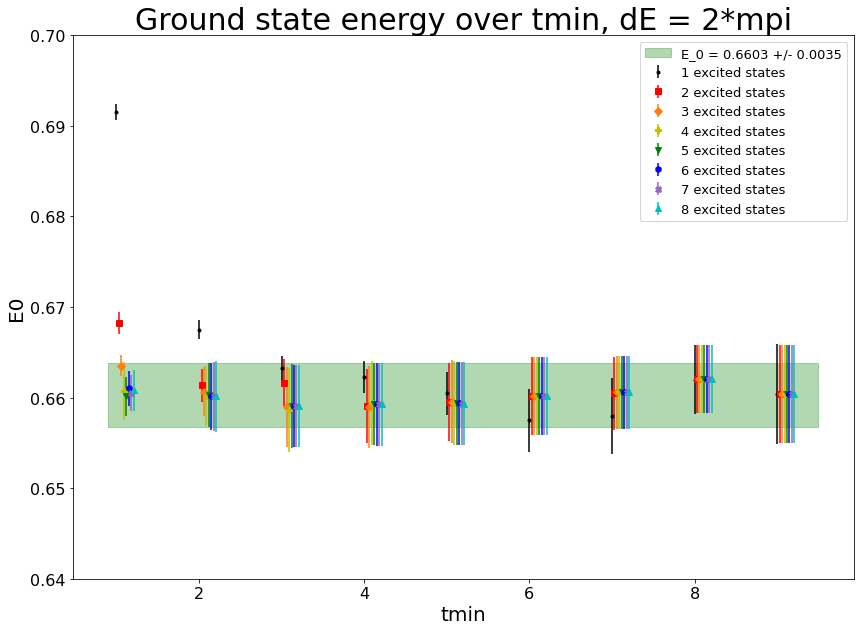

<Figure size 432x288 with 0 Axes>

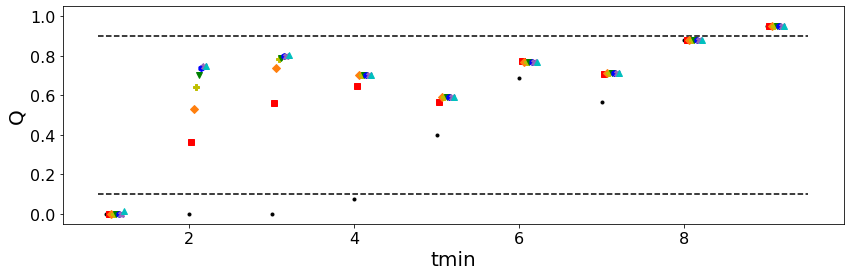

<Figure size 432x288 with 0 Axes>

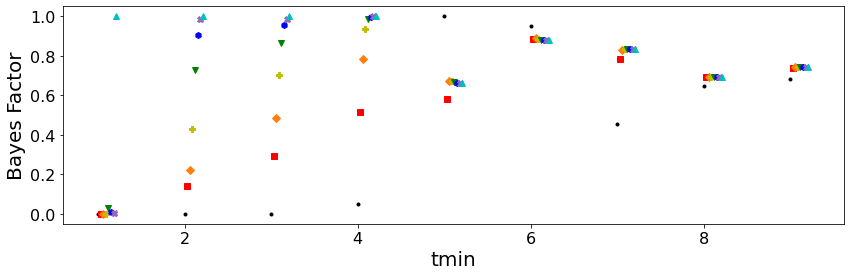

<Figure size 432x288 with 0 Axes>

In [50]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a0_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a0_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_a0)):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a0[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a0[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))
plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[4][1].mean + E0_tmin_bmax_a0[4][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[4][1].mean - E0_tmin_bmax_a0[4][1].sdev  for i in tmin_samp_line], color="green",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[4][1].mean, E0_tmin_bmax_a0[4][1].sdev))
plt.title("Ground state energy over tmin, dE = 2*mpi", fontsize = 30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dEconst_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_a0)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a0[i][k] for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dEconst_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a0)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a0[i][k] for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dEconst_tmin_comparison.png")
plt.show()

plt.clf()

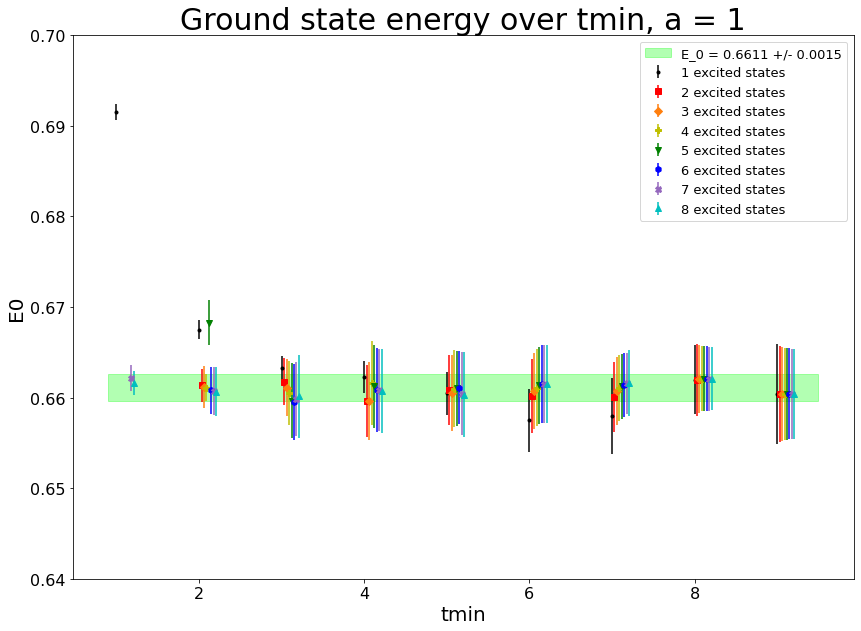

<Figure size 432x288 with 0 Axes>

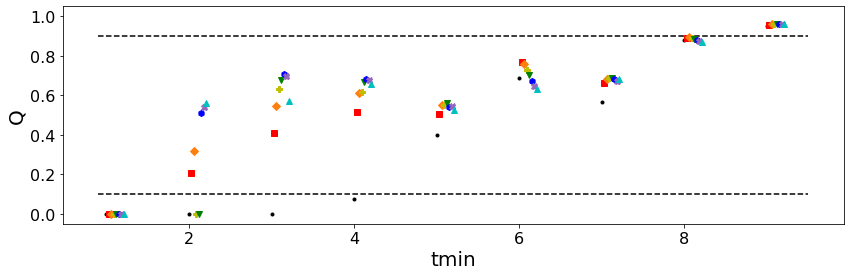

<Figure size 432x288 with 0 Axes>

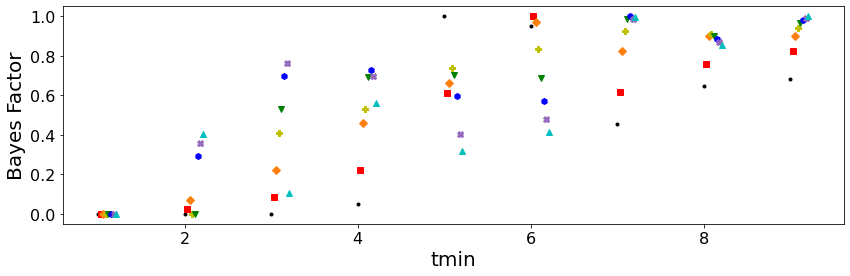

<Figure size 432x288 with 0 Axes>

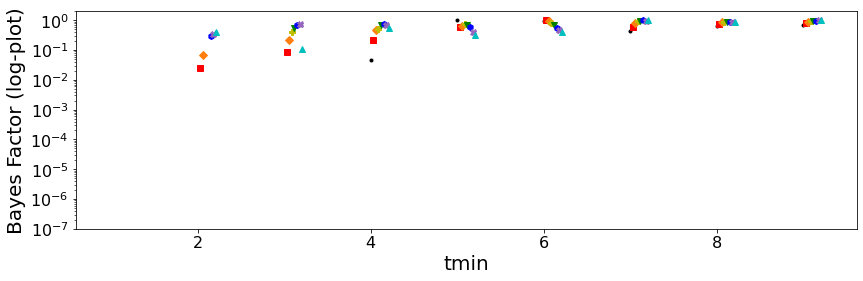

In [51]:
# Make a plot of E0 values vs tmin for a=1 , with a Q-plot and a Bayes factor plot right below, 
a1_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a1_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_a1)):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a1[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a1[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a1[3][1].mean + E0_tmin_bmax_a1[3][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a1[3][1].mean - E0_tmin_bmax_a1[3][1].sdev  for i in tmin_samp_line], color="lime",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a1[3][1].mean, E0_tmin_bmax_a1[3][1].sdev))
plt.title("Ground state energy over tmin, a = 1", fontsize=30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dE1overn_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_a1)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a1[i][k] for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dE1overn_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a1)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a1[i][k] for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a1_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dE1overn_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a1)):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_a1[i][k] for k in range(len(tmin))], '.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor (log-plot)", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-7, 2)
plt.show()



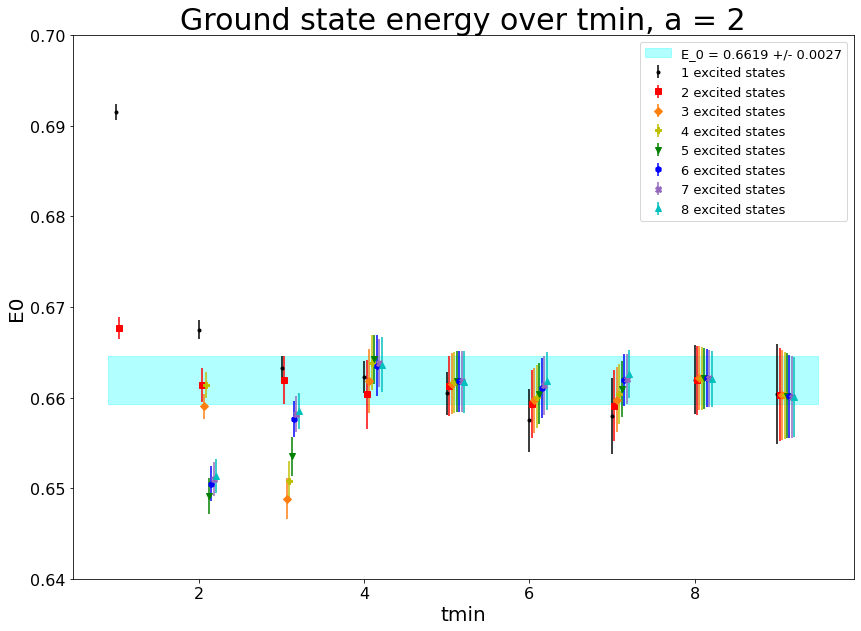

<Figure size 432x288 with 0 Axes>

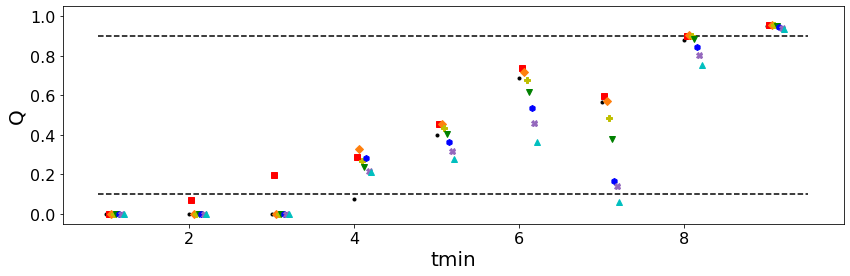

<Figure size 432x288 with 0 Axes>

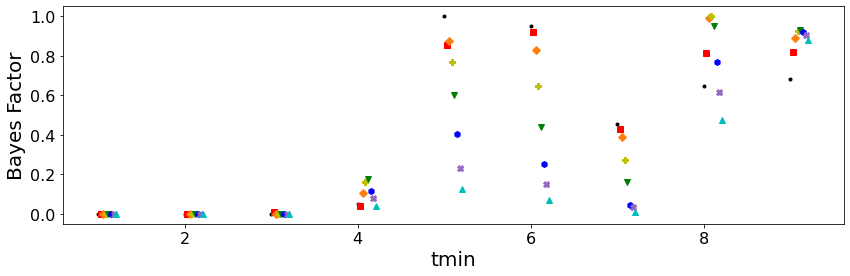

<Figure size 432x288 with 0 Axes>

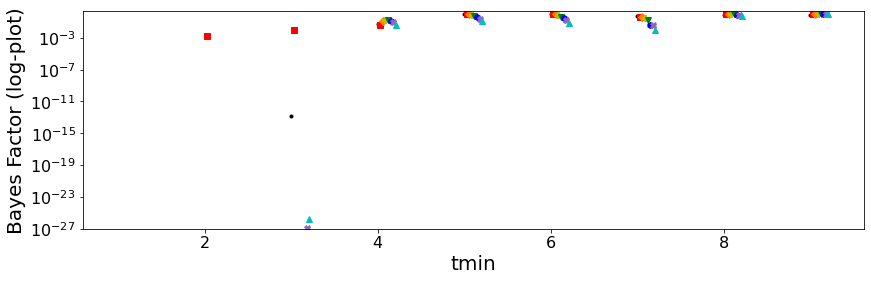

In [52]:
# Make a plot of E0 values vs tmin for a=2 , with a Q-plot and a Bayes factor plot right below, 
a2_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a2_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_a2)):
    E0_tmin_bmax_a2[i]
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a2[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a2[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a2[1][2].mean + E0_tmin_bmax_a2[1][2].sdev for i in tmin_samp_line], [E0_tmin_bmax_a2[1][2].mean - E0_tmin_bmax_a2[1][2].sdev  for i in tmin_samp_line], color="cyan",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a2[1][2].mean, E0_tmin_bmax_a2[1][2].sdev))
plt.title("Ground state energy over tmin, a = 2", fontsize=30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dE1overn^2_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_a2)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a2[i][k] for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a2_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dE1overn^2_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a2)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a2[i][k] for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dE1overn^2_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a2)):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_a2[i][k] for k in range(len(tmin))], '.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor (log-plot)", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-27, 2)
plt.show()


### The optimal fit from the old prior's tmin plot

Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.71    logGBF = 489.99

Parameters:
             E0       0.660092 +- 0.00356018             [        0.66 +- 0.01 ]  
             Z0   0.000752463 +- 1.46533e-05             [    0.0008 +- 0.0001 ]  
        Ztilde0    0.00283965 +- 6.39036e-05             [      0.003 +- 0.001 ]  
             Z1   0.000584069 +- 0.000147293             [    0.0008 +- 0.0008 ]  
        Ztilde1      0.00377513 +- 0.0011633             [      0.003 +- 0.003 ]  
             Z2   0.000586099 +- 0.000378238             [    0.0008 +- 0.0008 ]  
        Ztilde2     0.00464002 +- 0.00213189             [      0.003 +- 0.003 ]  
       log(dE1)        -0.930524 +- 0.225188             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.902899 +- 0.522498             [     -0.97551 +- 0.7 ]  
       log(dE3)        -0.922713 +- 0.579341             [     -0.97551 +- 0.7 ]  
             Z3   0.000732792 +- 0.000538736             [    0.0008 +- 0.0008 

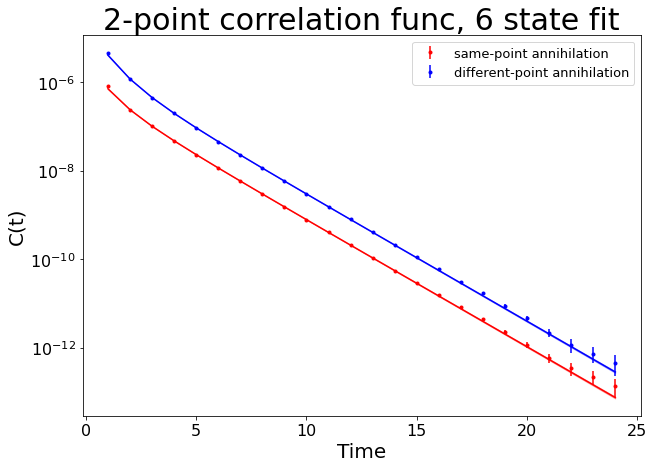

E0 =  0.660091779189076 +/- 0.0035601800697845727


In [25]:
num_zs = 6

fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[1], 13)]), np.array([avg_data_original['proton'][l] for l in range(tmin[1],13)])), prior=priors[a_select_indices[0]][2],fcn=C_2pt,debug=True, maxit=100000)
print(fit_a0.format(pstyle='vv'))
y_sample = C_2pt(np.array([i for i in range(0,25)]), fit_a0.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,25)], [avg_data_original['proton'][i][0][0].mean for i in range(1,25)], yerr=[avg_data_original['proton'][i][0][0].sdev for i in range(1,25)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,25)], [avg_data_original['proton'][i][1][0].mean for i in range(1,25)], yerr=[avg_data_original['proton'][i][1][0].sdev for i in range(1,25)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,25)],[y_sample[i][0][0].mean for i in range(1,25)],ls='-',color="red")
ax.fill_between([i for i in range(1,25)],[y_sample[i][0][0].mean + y_sample[i][0][0].sdev for i in range(1,25)], [y_sample[i][0][0].mean - y_sample[i][0][0].sdev for i in range(1,25)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,25)],[y_sample[i][1][0].mean for i in range(1,25)],ls='-',color="blue")
ax.fill_between([i for i in range(1,25)],[y_sample[i][1][0].mean + y_sample[i][1][0].sdev for i in range(1,25)], [y_sample[i][1][0].mean - y_sample[i][1][0].sdev for i in range(1,25)], color="blue",alpha=0.3)
plt.xlabel("Time", fontsize = 20)
plt.ylabel("C(t)", fontsize = 20)
plt.title("2-point correlation func, 6 state fit", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend(fontsize=13)
plt.savefig('optimalfit_2ptcorrelation_numzs6.png')
plt.show()


print("E0 = ", fit_a0.p['E0'].mean, "+/-", fit_a0.p['E0'].sdev)

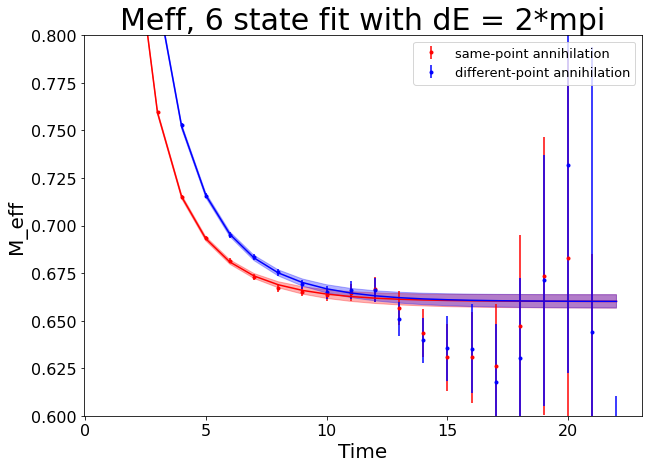

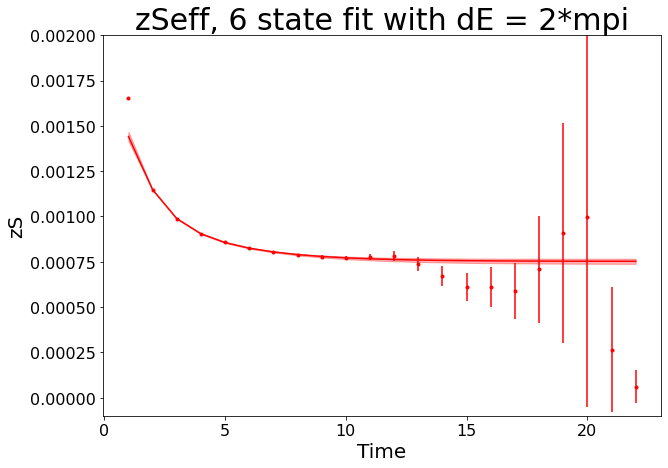

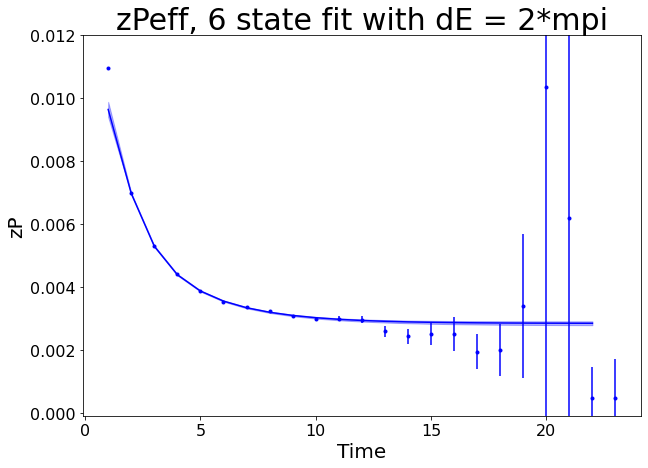

In [26]:
model_eff_mass = np.array([np.log(y_sample[i]/y_sample[i+1]) for i in range(0,24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar([i for i in range(1,23)], [eff_mass[0][i].mean for i in range(1,23)], yerr=[eff_mass[0][i].sdev for i in range(1,23)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(1,23)], [eff_mass[1][i].mean for i in range(1,23)], yerr=[eff_mass[1][i].sdev for i in range(1,23)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][0][0].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][0][0].mean + model_eff_mass[i][0][0].sdev for i in range(1,23)], [model_eff_mass[i][0][0].mean - model_eff_mass[i][0][0].sdev for i in range(1,23)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][1][0].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][1][0].mean + model_eff_mass[i][1][0].sdev for i in range(1,23)], [model_eff_mass[i][1][0].mean - model_eff_mass[i][1][0].sdev for i in range(1,23)], color="blue",alpha=0.3)

plt.xlabel("Time", fontsize = 20)
plt.ylabel("M_eff", fontsize = 20)
plt.ylim(0.6, 0.8)
plt.title("Meff, 6 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend(fontsize=13)
plt.savefig('optimalfit_2pteffmass_numzs6.png')
plt.show()


# Plot effective zSS
model_zS_eff = np.array([np.sqrt(np.exp(model_eff_mass[t][0][0]*t)*y_sample[t][0][0]) for t in range(0, 24)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 23)]), np.array([avg_data_original['zs_eff'][i].mean for i in range(1, 23)]), np.array([avg_data_original['zs_eff'][i].sdev for i in range(1, 23)]), fmt='.', color = 'red')

ax.errorbar([i for i in range(1,23)],[model_zS_eff[i].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_zS_eff[i].mean + model_zS_eff[i].sdev for i in range(1,23)], [model_zS_eff[i].mean - model_zS_eff[i].sdev for i in range(1,23)], color="red",alpha=0.3)

plt.xlabel("Time", fontsize = 20)
plt.ylabel("zS", fontsize = 20)
plt.ylim(-0.0001, 0.002)
plt.title("zSeff, 6 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('optimalfit_2pteffzs_numzs6.png')
plt.show()


model_zP_eff = np.array([np.exp(model_eff_mass[t][1][0]*t)*y_sample[t][1][0]/model_zS_eff[t] for t in range(0, 24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 24)]), np.array([avg_data_original['zp_eff'][i].mean for i in range(1, 24)]), np.array([avg_data_original['zp_eff'][i].sdev for i in range(1, 24)]), fmt='.', color="blue")

ax.errorbar([i for i in range(1,23)],[model_zP_eff[i].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_zP_eff[i].mean + model_zP_eff[i].sdev for i in range(1,23)], [model_zP_eff[i].mean - model_zP_eff[i].sdev for i in range(1,23)], color="blue",alpha=0.3)
plt.xlabel("Time", fontsize = 20)
plt.ylabel("zP", fontsize = 20)
plt.ylim(-0.0001, 0.012)
plt.title("zPeff, 6 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('optimalfit_2pteffzp_numzs6.png')
plt.show()


## Now, do the same with tmax 

In [ ]:
# Test to see if tmax affects the fit at all
tmax = np.array([13, 15, 18, 20, 22, 25])

list_tmax_LogGBF_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

list_tmax_LogGBF_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

list_tmax_LogGBF_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

In [ ]:
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmax)):
            num_zs = j + np.min(num_fitsamples) + 1
            fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([avg_data_original['proton'][l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[0]][i],fcn=C_2pt,debug=True)
            fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([avg_data_original['proton'][l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[1]][i],fcn=C_2pt,debug=True)
            fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([avg_data_original['proton'][l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[2]][i],fcn=C_2pt,debug=True)
            
            print("\ni = ", i, " j = ", j, " k = ", k, "\n")
            
            list_tmax_LogGBF_a0[i][j][k] = fit_a0.logGBF
            list_tmax_Q_a0[i][j][k] = fit_a0.Q
            list_tmax_E0_a0[i][j][k] = fit_a0.p['E0']
            
            print("Fit for a = ", a[a_select_indices[0]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmax = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a0[i][j][k])
            print("list Q: ", list_tmax_Q_a0[i][j][k])
            print("list E0: ", list_tmax_E0_a0[i][j][k])
            print(fit_a0.format(pstyle='vv'))
            
            list_tmax_LogGBF_a1[i][j][k] = fit_a1.logGBF
            list_tmax_Q_a1[i][j][k] = fit_a1.Q
            list_tmax_E0_a1[i][j][k] = fit_a1.p['E0']
            
            print("Fit for a = ", a[a_select_indices[1]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a1[i][j][k])
            print("list Q: ", list_tmax_Q_a1[i][j][k])
            print("list E0: ", list_tmax_E0_a1[i][j][k])
            print(fit_a1.format(pstyle='vv'))
            
            list_tmax_LogGBF_a2[i][j][k] = fit_a2.logGBF
            list_tmax_Q_a2[i][j][k] = fit_a2.Q
            list_tmax_E0_a2[i][j][k] = fit_a2.p['E0']
            
            print("Fit for a = ", a[a_select_indices[2]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a2[i][j][k])
            print("list Q: ", list_tmax_Q_a2[i][j][k])
            print("list E0: ", list_tmax_E0_a2[i][j][k])
            print(fit_a2.format(pstyle='vv'))

In [ ]:
max_tmax_logGBF_a0 = np.array([np.max(list_tmax_LogGBF_a0[:,:,i]) for i in range(len(list_tmax_LogGBF_a0[0][0]))])
max_tmax_logGBF_a1 = np.array([np.max(list_tmax_LogGBF_a1[:,:,i]) for i in range(len(list_tmax_LogGBF_a1[0][0]))])
max_tmax_logGBF_a2 = np.array([np.max(list_tmax_LogGBF_a2[:,:,i]) for i in range(len(list_tmax_LogGBF_a2[0][0]))])

In [ ]:
# Write the list_LogGBF to a file
F_logGBF_tmax_a0 = open("logGBF_tmax_a0_data.csv","w")
F_Q_tmax_a0 = open("Q_tmax_a0_data.csv","w")
F_E0_tmax_a0 = open("E0_tmax_a0_data.csv","w")
F_E0_tmax_err_a0 = open("E0error_tmax_a0_data.csv","w")

F_logGBF_tmax_a1 = open("logGBF_tmax_a1_data.csv","w")
F_Q_tmax_a1 = open("Q_tmax_a1_data.csv","w")
F_E0_tmax_a1 = open("E0_tmax_a1_data.csv","w")
F_E0_tmax_err_a1 = open("E0error_tmax_a1_data.csv","w")

F_logGBF_tmax_a2 = open("logGBF_tmax_a2_data.csv","w")
F_Q_tmax_a2 = open("Q_tmax_a2_data.csv","w")
F_E0_tmax_a2 = open("E0_tmax_a2_data.csv","w")
F_E0_tmax_err_a2 = open("E0error_tmax_a2_data.csv","w")


for i in range(len(b)):
    for j in range(len(num_fitsamples)):
        F_logGBF_tmax_a0.write("{}".format(list_tmax_LogGBF_a0[i][j][0]))
        F_Q_tmax_a0.write("{}".format(list_tmax_Q_a0[i][j][0]))
        F_E0_tmax_a0.write("{}".format(list_tmax_E0_a0[i][j][0].mean))
        F_E0_tmax_err_a0.write("{}".format(list_tmax_E0_a0[i][j][0].sdev))
        
        F_logGBF_tmax_a1.write("{}".format(list_tmax_LogGBF_a1[i][j][0]))
        F_Q_tmax_a1.write("{}".format(list_tmax_Q_a1[i][j][0]))
        F_E0_tmax_a1.write("{}".format(list_tmax_E0_a1[i][j][0].mean))
        F_E0_tmax_err_a1.write("{}".format(list_tmax_E0_a1[i][j][0].sdev))
        
        F_logGBF_tmax_a2.write("{}".format(list_tmax_LogGBF_a2[i][j][0]))
        F_Q_tmax_a2.write("{}".format(list_tmax_Q_a2[i][j][0]))
        F_E0_tmax_a2.write("{}".format(list_tmax_E0_a2[i][j][0].mean))
        F_E0_tmax_err_a2.write("{}".format(list_tmax_E0_a2[i][j][0].sdev))
        
        for k in range(1, len(tmax)):
            F_logGBF_tmax_a0.write(", {}".format(list_tmax_LogGBF_a0[i][j][k]))
            F_Q_tmax_a0.write(", {}".format(list_tmax_Q_a0[i][j][k]))
            F_E0_tmax_a0.write(", {}".format(list_tmax_E0_a0[i][j][k].mean))
            F_E0_tmax_err_a0.write(", {}".format(list_tmax_E0_a0[i][j][k].sdev))
            
            F_logGBF_tmax_a1.write(", {}".format(list_tmax_LogGBF_a1[i][j][k]))
            F_Q_tmax_a1.write(", {}".format(list_tmax_Q_a1[i][j][k]))
            F_E0_tmax_a1.write(", {}".format(list_tmax_E0_a1[i][j][k].mean))
            F_E0_tmax_err_a1.write(", {}".format(list_tmax_E0_a1[i][j][k].sdev))
            
            F_logGBF_tmax_a2.write(", {}".format(list_tmax_LogGBF_a2[i][j][k]))
            F_Q_tmax_a2.write(", {}".format(list_tmax_Q_a2[i][j][k]))
            F_E0_tmax_a2.write(", {}".format(list_tmax_E0_a2[i][j][k].mean))
            F_E0_tmax_err_a2.write(", {}".format(list_tmax_E0_a2[i][j][k].sdev))
        
        F_logGBF_tmax_a0.write("; ")
        F_Q_tmax_a0.write("; ")
        F_E0_tmax_a0.write("; ")
        F_E0_tmax_err_a0.write("; ")
        
        F_logGBF_tmax_a1.write("; ")
        F_Q_tmax_a1.write("; ")
        F_E0_tmax_a1.write("; ")
        F_E0_tmax_err_a1.write("; ")
        
        F_logGBF_tmax_a2.write("; ")
        F_Q_tmax_a2.write("; ")
        F_E0_tmax_a2.write("; ")
        F_E0_tmax_err_a2.write("; ")
        
    F_logGBF_tmax_a0.write("\n")
    F_Q_tmax_a0.write("\n")
    F_E0_tmax_a0.write("\n")
    F_E0_tmax_err_a0.write("\n")
    
    F_logGBF_tmax_a1.write("\n")
    F_Q_tmax_a1.write("\n")
    F_E0_tmax_a1.write("\n")
    F_E0_tmax_err_a1.write("\n")
    
    F_logGBF_tmax_a2.write("\n")
    F_Q_tmax_a2.write("\n")
    F_E0_tmax_a2.write("\n")
    F_E0_tmax_err_a2.write("\n")
    

F_logGBF_tmax_a0.close()
F_Q_tmax_a0.close()
F_E0_tmax_a0.close()
F_E0_tmax_err_a0.close()

F_logGBF_tmax_a1.close()
F_Q_tmax_a1.close()
F_E0_tmax_a1.close()
F_E0_tmax_err_a1.close()

F_logGBF_tmax_a2.close()
F_Q_tmax_a2.close()
F_E0_tmax_a2.close()
F_E0_tmax_err_a2.close()

In [ ]:
tmax = np.array([13, 15, 18, 20, 22, 25])
# Readout test
read_F_logGBF_tmax_a0 = open("logGBF_tmax_a0_data.csv","r")
read_F_Q_tmax_a0 = open("Q_tmax_a0_data.csv","r")
read_F_E0_tmax_a0 = open("E0_tmax_a0_data.csv","r")
read_F_E0_tmax_err_a0 = open("E0error_tmax_a0_data.csv","r")

read_F_logGBF_tmax_a1 = open("logGBF_tmax_a1_data.csv","r")
read_F_Q_tmax_a1 = open("Q_tmax_a1_data.csv","r")
read_F_E0_tmax_a1 = open("E0_tmax_a1_data.csv","r")
read_F_E0_tmax_err_a1 = open("E0error_tmax_a1_data.csv","r")

read_F_logGBF_tmax_a2 = open("logGBF_tmax_a2_data.csv","r")
read_F_Q_tmax_a2 = open("Q_tmax_a2_data.csv","r")
read_F_E0_tmax_a2 = open("E0_tmax_a2_data.csv","r")
read_F_E0_tmax_err_a2 = open("E0error_tmax_a2_data.csv","r")

logGBF_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

logGBF_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

logGBF_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))


E0_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

i = 0
j = 0
for line in read_F_logGBF_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        

i = 0
j = 0
for line in read_F_Q_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
        
        
        
i = 0
j = 0
for line in read_F_E0_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
    
    
    
    
 

        
i = 0
j = 0      
for line in read_F_E0_tmax_err_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmax_err_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmax_err_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    

    
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmax)):
            E0_tmax_a0_readout[i][j][k] = gv.gvar(E0_tmax_mean_a0_readout[i][j][k], E0_tmax_err_a0_readout[i][j][k])
            E0_tmax_a1_readout[i][j][k] = gv.gvar(E0_tmax_mean_a1_readout[i][j][k], E0_tmax_err_a1_readout[i][j][k])
            E0_tmax_a2_readout[i][j][k] = gv.gvar(E0_tmax_mean_a2_readout[i][j][k], E0_tmax_err_a2_readout[i][j][k])

In [ ]:
# Find the max Bayes factor b-values
logGBF_tmax_a0_readout_tp = np.transpose(logGBF_tmax_a0_readout)
tmax_b_max_BF_a0 = np.array([[np.where(logGBF_tmax_a0_readout_tp[i][j] == np.amax(logGBF_tmax_a0_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a0_readout_tp[0]))] for i in range(len(logGBF_tmax_a0_readout_tp))])

logGBF_tmax_a1_readout_tp = np.transpose(logGBF_tmax_a1_readout)
tmax_b_max_BF_a1 = np.array([[np.where(logGBF_tmax_a1_readout_tp[i][j] == np.amax(logGBF_tmax_a1_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a1_readout_tp[0]))] for i in range(len(logGBF_tmax_a1_readout_tp))])

logGBF_tmax_a2_readout_tp = np.transpose(logGBF_tmax_a2_readout)
tmax_b_max_BF_a2 = np.array([[np.where(logGBF_tmax_a2_readout_tp[i][j] == np.amax(logGBF_tmax_a2_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a2_readout_tp[0]))] for i in range(len(logGBF_tmax_a2_readout_tp))])

In [ ]:
tmax_log_GBF_max_a0 = np.array([np.max(logGBF_tmax_a0_readout_tp[i]) for i in range(len(logGBF_tmax_a0_readout_tp))])

tmax_log_GBF_max_a1 = np.array([np.max(logGBF_tmax_a1_readout_tp[i]) for i in range(len(logGBF_tmax_a1_readout_tp))])

tmax_log_GBF_max_a2 = np.array([np.max(logGBF_tmax_a2_readout_tp[i]) for i in range(len(logGBF_tmax_a2_readout_tp))])

tmax_log_GBF_max = np.array([np.max(np.array([tmax_log_GBF_max_a0[i], tmax_log_GBF_max_a1[i], tmax_log_GBF_max_a2[i]])) for i in range(len(tmax_log_GBF_max_a0))])

In [ ]:
# Possible choices: b_max_BF_a<n>[i][j], 0, 1, 2, 3, 4, 5
tmax_choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmax_a0_readout_tp[0]))] for i in range(len(logGBF_tmax_a0_readout_tp))])
tmax_choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmax_a1_readout_tp[0]))] for i in range(len(logGBF_tmax_a1_readout_tp))])
tmax_choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmax_a2_readout_tp[0]))] for i in range(len(logGBF_tmax_a2_readout_tp))])
# Find the Bayes factors and make arrays with just the max Bayes factor locations

logGBF_tmax_bmax_a0 = np.array([[logGBF_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(logGBF_tmax_a0_readout[0][0]))] for j in range(len(logGBF_tmax_a0_readout[0]))])
BF_tmax_bmax_a0 = np.exp(np.array([[logGBF_tmax_bmax_a0[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a0[0])) ] for i in range(len(logGBF_tmax_bmax_a0)) ])) 
Q_tmax_bmax_a0 = np.array([[Q_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(Q_tmax_a0_readout[0][0]))] for j in range(len(Q_tmax_a0_readout[0]))])
E0_tmax_bmax_a0 = np.array([[E0_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(E0_tmax_a0_readout[0][0]))] for j in range(len(E0_tmax_a0_readout[0]))])


logGBF_tmax_bmax_a1 = np.array([[logGBF_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(logGBF_tmax_a1_readout[0][0]))] for j in range(len(logGBF_tmax_a1_readout[0]))])
BF_tmax_bmax_a1 = np.exp(np.array([[logGBF_tmax_bmax_a1[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a1[0])) ] for i in range(len(logGBF_tmax_bmax_a1)) ])) 
Q_tmax_bmax_a1 = np.array([[Q_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(Q_tmax_a1_readout[0][0]))] for j in range(len(Q_tmax_a1_readout[0]))])
E0_tmax_bmax_a1 = np.array([[E0_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(E0_tmax_a1_readout[0][0]))] for j in range(len(E0_tmax_a1_readout[0]))])

logGBF_tmax_bmax_a2 = np.array([[logGBF_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(logGBF_tmax_a2_readout[0][0]))] for j in range(len(logGBF_tmax_a2_readout[0]))])
BF_tmax_bmax_a2 = np.exp(np.array([[logGBF_tmax_bmax_a2[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a2[0])) ] for i in range(len(logGBF_tmax_bmax_a2)) ])) 
Q_tmax_bmax_a2 = np.array([[Q_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(Q_tmax_a2_readout[0][0]))] for j in range(len(Q_tmax_a2_readout[0]))])
E0_tmax_bmax_a2 = np.array([[E0_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(E0_tmax_a2_readout[0][0]))] for j in range(len(E0_tmax_a2_readout[0]))])



In [ ]:
tmax_samp_line = np.linspace(12.9,25.5,100)
Q_01_line = np.linspace(0.1,0.1,100)
Q_09_line = np.linspace(0.9,0.9,100)

In [ ]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a0_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a0_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmax_bmax_a0)):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a0[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a0[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmax_samp_line, [E0_tmax_bmax_a0[3][0].mean + E0_tmax_bmax_a0[3][0].sdev for i in tmax_samp_line], [E0_tmax_bmax_a0[3][0].mean - E0_tmax_bmax_a0[3][0].sdev  for i in tmax_samp_line], color="lime",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmax_bmax_a0[3][0].mean, E0_tmax_bmax_a0[3][0].sdev))
plt.title("Ground state energy over tmax, dE = 2*mpi", fontsize=30)
plt.xlabel("tmax", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dEconst_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmax_bmax_a0)):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a0[i][k] for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dEconst_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a0)):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a0[i][k] for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dEconst_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a0)):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a0[i][k] for k in range(len(tmax))], '.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Bayes Factor (log-plot)", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-7, 2)
plt.savefig('logBFa0.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])

In [ ]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a1_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a1_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmax_bmax_a1)):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a1[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a1[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))

plt.title("Ground state energy over tmax, dE = 2*mpi/n", fontsize=30)
plt.xlabel("tmax", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dE1overn_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmax_bmax_a1)):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a1[i][k] for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dE1overn_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a1)):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a1[i][k] for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dE1overn_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a1)):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a1[i][k] for k in range(len(tmax))], '.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Bayes Factor (log-plot)", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-7, 2)
plt.savefig('logBFa1.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])

In [ ]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a2_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a2_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmax_bmax_a2)):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a2[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a2[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))

plt.title("Ground state energy over tmin, dE = 2*mpi/n^2", fontsize = 30)
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("E0", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize = 13)
fig.savefig("E0_2pt_dE1overn2_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmax_bmax_a2)):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a2[i][k] for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Q", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dE1overn2_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a2)):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a2[i][k] for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Bayes Factor", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dE1overn2_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a2)):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a2[i][k] for k in range(len(tmax))], '.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Bayes Factor (log-plot)", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-7, 2)
plt.savefig('logBFa2.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])